<a href="https://colab.research.google.com/github/cksdlakstp12/izone_finder/blob/main/filtering_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

function ClickConnect(){
    console.log("1분마다 코랩 연결 끊김 방지"); 
    document.querySelector("#top-toolbar > colab-connect-button").shadowRoot.querySelector("#connect-icon")
.click();
}
setInterval(ClickConnect, 6000 * 60);

YOLO wieght files download (drive mount시에는 필요 없음)

In [ ]:
import requests

urls = ["https://blog.kakaocdn.net/dn/t86Rp/btqC6QZVRAt/5YlZLZS33KxCAZKexRebyk/coco.names?attach=1&knm=tfile.names",
       "https://blog.kakaocdn.net/dn/btoiTm/btqC3qawmTN/KwIhwgp4CRSL3KlWuykKU1/yolov3.cfg?attach=1&knm=tfile.cfg",
       "https://pjreddie.com/media/files/yolov3.weights"]

weight_path = "weight/"
names = ["coco.names", "yolov3.cfg", "yolov3.weights"]

for n, r in zip(weight_path + names, urls):
    file = requests.get(r, allow_redirects=True)

    open(n, 'wb').write(file.content)

drive work

In [ ]:
!pip install mtcnn

import cv2
import numpy as np
import zipfile
import time
import os
import matplotlib.pyplot as plt
import tensorflow as tf
import mtcnn

from google.colab.patches import cv2_imshow
from PIL import Image
from mtcnn.mtcnn import MTCNN

from google.colab import drive
drive.mount("/content/drive")

     |████████████████████████████████| 2.3 MB 4.2 MB/s 
Mounted at /content/drive


필요한 함수 정의

In [ ]:
def createFolder(directory):
    try:
        if not os.path.exists(directory):
            os.makedirs(directory)
    except OSError:
        print("Error : Creating directory. " + directory)

def delete_img(path, img):
    os.remove(path)
    plt.imgshow(img)
    plt.show()

# 기본적인 전처리

In [ ]:
flitering_person_num = 2
ROOT_PATH = "/content/IZ_ONE/"
TRAIN_PATH = ROOT_PATH + "train/"
detector = MTCNN()

In [ ]:
IZ_ONE = {
    "최예나":"Choi_Yena", 
    "조유리":"Jo_Yuri", 
    "김채원":"Kim_Chaewon", 
    "안유진":"Ahn_Yujin", 
    "김민주":"Kim_Minjoo", 
    "장원영":"Jang_Wonyoung",
    "나코":"Yabuki_Naco",
    "히토미":"Honda_Hitomi", 
    "사쿠라":"Miyawaki_Sakura", 
    "이채연":"Lee_Chaeyeon", 
    "강혜원":"Kang_Hyewon", 
    "권은비":"Kwon_Eunbi"
}
reverse_IZ_ONE = {v:k for k,v in IZ_ONE.items()}

# 폴더 생성
for eng_name in IZ_ONE.values():
  IMAGE_PATH = TRAIN_PATH + f"{eng_name}_train/"
  createFolder(IMAGE_PATH)

# 데이터 로드
for eng_name in IZ_ONE.values():
  IZ_ONE_train = zipfile.ZipFile(
      f'/content/drive/MyDrive/IZONE_finder/member_dataset/train/{eng_name}_train.zip')
  IZ_ONE_train.extractall(f'/content/IZ_ONE/train/{eng_name}_train')
  IZ_ONE_train.close()

  IZ_ONE_test = zipfile.ZipFile(
      f'/content/drive/MyDrive/IZONE_finder/member_dataset/test/{eng_name}_test.zip')
  IZ_ONE_test.extractall('/content/IZ_ONE/test/')  
  IZ_ONE_test.close()

# 데이터 로드 확인
for eng_name in IZ_ONE.values():
  train_file_list = os.listdir(f"/content/IZ_ONE/train/{eng_name}_train")
  print(f"{eng_name} images length :", len(train_file_list))
  
  test_file_list = os.listdir(f"/content/IZ_ONE/train/{eng_name}_test")
  print(f"{eng_name} images length :", f"(train = {len(train_file_list)}, test = {len(test_file_list)}")

Kang_Hyewon images length : 1682
Kwon_Eunbi images length : 1787


Model Load

In [ ]:
num_classes = 2
learning_rate = 1e-5
original_dim = (72, 59, 3)
target_size = (224, 224)

In [ ]:
weight_path = "/content/drive/MyDrive/IZONE_finder/IZ_ONE_Finder/weights/"

# 사람수 판별에 쓰일 욜로 모델 로드
net = cv2.dnn.readNet(weight_path + "yolov3.weights", weight_path + "yolov3.cfg")
classes = []
with open(weight_path + "coco.names", "r") as f:
    classes = [line.strip() for line in f.readlines()]
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]

# 사진에 여러 사람이 2명 이상 있다면 사진을 삭제하고 얼굴을 추출함.

In [ ]:
for member in IZ_ONE.values():
  print(member + " image filtering")
  delete_cnt = 0
  IMAGE_PATH = TRAIN_PATH + f"{member}_train/"
  FACES_PATH = ROOT_PATH + "faces/" + f"{member}_faces/"
  TEST_PATH = "/content/IZ_ONE/test/" + f"{member}_test/"
  createFolder(FACES_PATH)
  createFolder(TEST_PATH)
  images = os.listdir(IMAGE_PATH)
  
  start_time = time.time()
  for img_idx, img_name in enumerate(images):
    try: 
      img = cv2.imread(IMAGE_PATH + img_name)
      height, width, channels = img.shape
    except: 
      delete_cnt += 1
      os.remove(IMAGE_PATH + img_name)
      continue

    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(output_layers)

    class_ids = []
    confidences = []
    boxes = []
    for out in outs:
      for detection in out:
        scores = detection[5:]
        class_id = np.argmax(scores)
        confidence = scores[class_id]
        if confidence > 0.5:
          # Object detected
          center_x = int(detection[0] * width)
          center_y = int(detection[1] * height)
          w = int(detection[2] * width)
          h = int(detection[3] * height)
          # 좌표
          x = int(center_x - w / 2)
          y = int(center_y - h / 2)
          boxes.append([x, y, w, h])
          confidences.append(float(confidence))
          class_ids.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    # 사람이 2명 이상이면 출력하고 삭제함.
    person_cnt = 0
    for i in range(len(boxes)):
      if i in indexes:
        label = str(classes[class_ids[i]])
        if label == "person":
          person_cnt += 1

    if person_cnt >= flitering_person_num or person_cnt == 0:
      delete_cnt += 1
      os.remove(IMAGE_PATH + img_name)
      continue

    # 사진에서 얼굴을 추출함.
    results = detector.detect_faces(img)

    if not results:
      delete_cnt += 1
      os.remove(IMAGE_PATH + img_name)
      continue

    for face_idx, result in enumerate(results):
      x1, y1, width, height = result["box"]
      x2, y2 = x1 + width, y1 + height

      face = img[y1:y2, x1:x2]

      image = Image.fromarray(face)
      image = image.resize((72, 59))
      face_array = np.asarray(image)

      face_img = Image.fromarray(face_array)
      face_img.save(FACES_PATH + f"/{img_idx}_{face_idx}.jpg")

  # 처리된 사진 압축 후 드라이브에 저장
  # train
  print(f"{member}_images.zip copy to drive")
  with zipfile.ZipFile(f'/content/{member}_train.zip', 'w', compression=zipfile.ZIP_DEFLATED) as new_zip:
    img_name_list = os.listdir(IMAGE_PATH)
    for img_name in img_name_list:
      new_zip.write(IMAGE_PATH + img_name, arcname=img_name)

  os.system(f"cp /content/{member}_train.zip /content/drive/MyDrive/IZONE_finder/member_dataset/train")
  print(f"/content/{member}_train.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/train")

  # test
  with zipfile.ZipFile(f'/content/{member}_test.zip', 'w', compression=zipfile.ZIP_DEFLATED) as new_zip:
    img_name_list = os.listdir(TEST_PATH)
    for img_name in img_name_list:
      new_zip.write(TEST_PATH + img_name, arcname=img_name)

  os.system(f"cp /content/{member}_test.zip /content/drive/MyDrive/IZONE_finder/member_dataset/test")
  print(f"/content/{member}_test.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/test")

  # faces
  with zipfile.ZipFile(f'/content/{member}_faces.zip', 'w', compression=zipfile.ZIP_DEFLATED) as new_zip:
    img_name_list = os.listdir(FACES_PATH)
    for img_name in img_name_list:
      new_zip.write(FACES_PATH + img_name, arcname=img_name)

  os.system(f"cp /content/{member}_faces.zip /content/drive/MyDrive/IZONE_finder/member_dataset/faces")
  print(f"/content/{member}_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces")

  # 삭제된 사진의 총량
  print("total deleted images : ", delete_cnt)
  print(f"process done in {time.time() - start_time}")
  print("="*50)
  continue

Kang_Hyewon image filtering
Kang_Hyewon_images.zip copy to drive
/content/Kang_Hyewon_train.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/train
/content/Kang_Hyewon_test.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/test
/content/Kang_Hyewon_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces
total deleted images :  539
process done in 2089.989419937134
Kwon_Eunbi image filtering
Kwon_Eunbi_images.zip copy to drive
/content/Kwon_Eunbi_train.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/train
/content/Kwon_Eunbi_test.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/test
/content/Kwon_Eunbi_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces
total deleted images :  538
process done in 2145.4965813159943


# 노가다 필요시 사용

In [ ]:
for eng_name in IZ_ONE.values():
  IZ_ONE_faces = zipfile.ZipFile(
      f'/content/drive/MyDrive/IZONE_finder/member_dataset/faces/{eng_name}_faces.zip')
  IZ_ONE_faces.extractall(f'/content/IZ_ONE/faces/{eng_name}_faces')
  IZ_ONE_faces.close()

find Choi_Yena


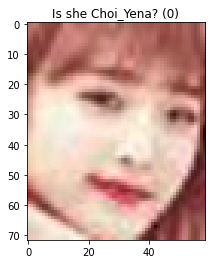

 <<< d : delete, a : pass, e : escape >>> 
a


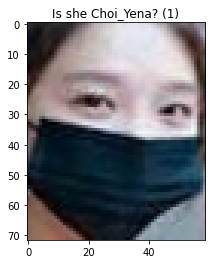

 <<< d : delete, a : pass, e : escape >>> 



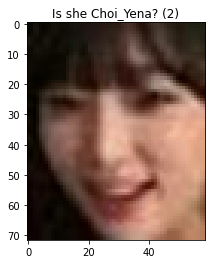

 <<< d : delete, a : pass, e : escape >>> 



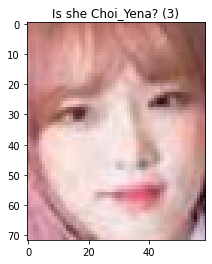

 <<< d : delete, a : pass, e : escape >>> 



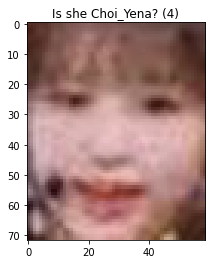

 <<< d : delete, a : pass, e : escape >>> 



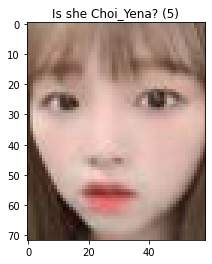

 <<< d : delete, a : pass, e : escape >>> 



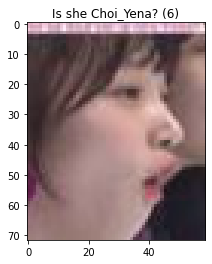

 <<< d : delete, a : pass, e : escape >>> 



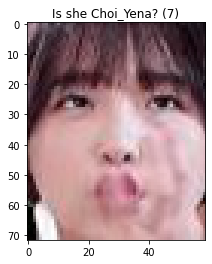

 <<< d : delete, a : pass, e : escape >>> 



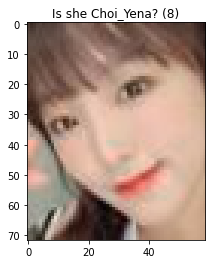

 <<< d : delete, a : pass, e : escape >>> 



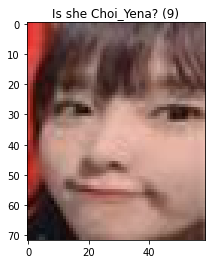

 <<< d : delete, a : pass, e : escape >>> 



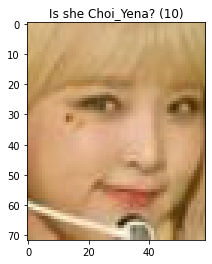

 <<< d : delete, a : pass, e : escape >>> 



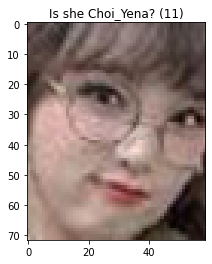

 <<< d : delete, a : pass, e : escape >>> 



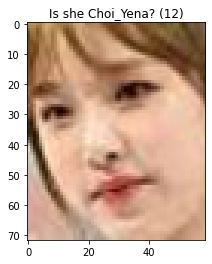

 <<< d : delete, a : pass, e : escape >>> 



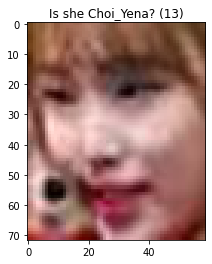

 <<< d : delete, a : pass, e : escape >>> 



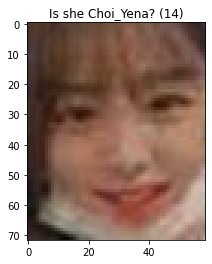

 <<< d : delete, a : pass, e : escape >>> 



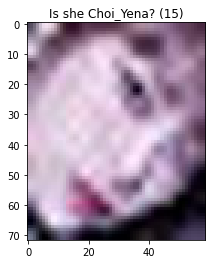

 <<< d : delete, a : pass, e : escape >>> 



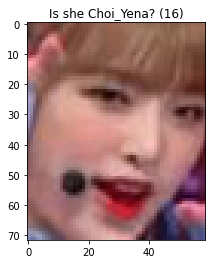

 <<< d : delete, a : pass, e : escape >>> 



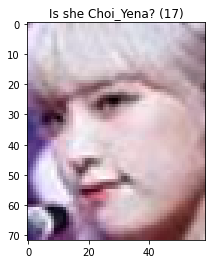

 <<< d : delete, a : pass, e : escape >>> 



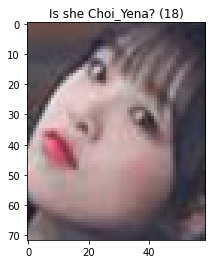

 <<< d : delete, a : pass, e : escape >>> 



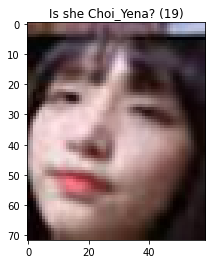

 <<< d : delete, a : pass, e : escape >>> 



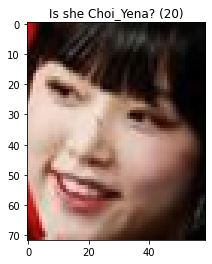

 <<< d : delete, a : pass, e : escape >>> 



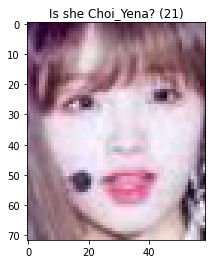

 <<< d : delete, a : pass, e : escape >>> 



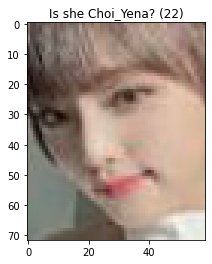

 <<< d : delete, a : pass, e : escape >>> 



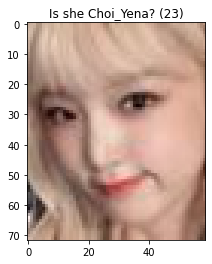

 <<< d : delete, a : pass, e : escape >>> 



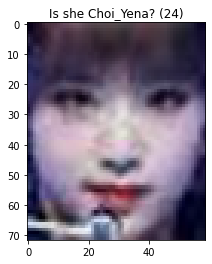

 <<< d : delete, a : pass, e : escape >>> 



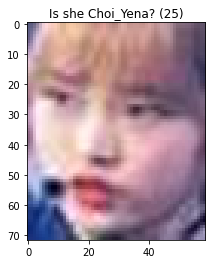

 <<< d : delete, a : pass, e : escape >>> 



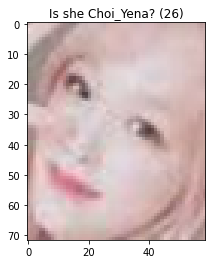

 <<< d : delete, a : pass, e : escape >>> 



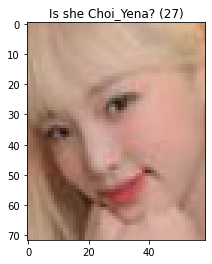

 <<< d : delete, a : pass, e : escape >>> 



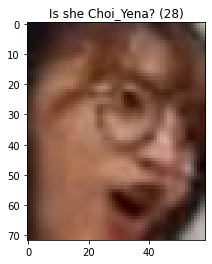

 <<< d : delete, a : pass, e : escape >>> 



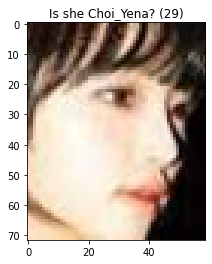

 <<< d : delete, a : pass, e : escape >>> 



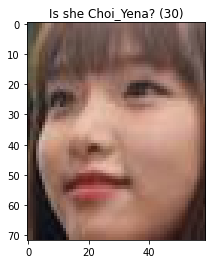

 <<< d : delete, a : pass, e : escape >>> 



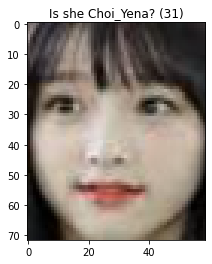

 <<< d : delete, a : pass, e : escape >>> 



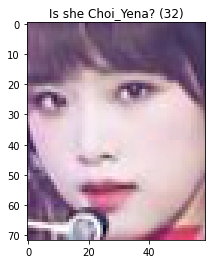

 <<< d : delete, a : pass, e : escape >>> 



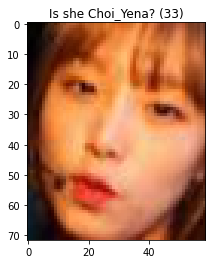

 <<< d : delete, a : pass, e : escape >>> 



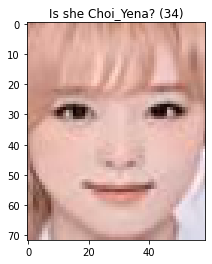

 <<< d : delete, a : pass, e : escape >>> 



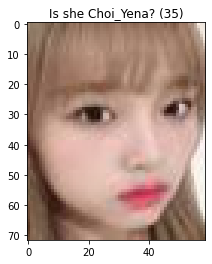

 <<< d : delete, a : pass, e : escape >>> 



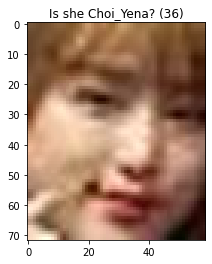

 <<< d : delete, a : pass, e : escape >>> 



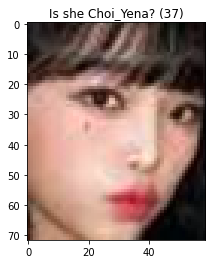

 <<< d : delete, a : pass, e : escape >>> 



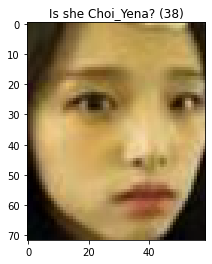

 <<< d : delete, a : pass, e : escape >>> 



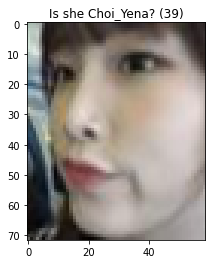

 <<< d : delete, a : pass, e : escape >>> 



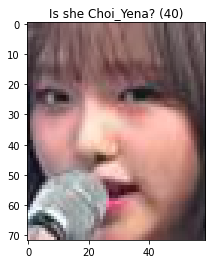

 <<< d : delete, a : pass, e : escape >>> 



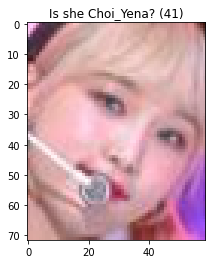

 <<< d : delete, a : pass, e : escape >>> 



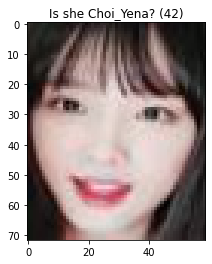

 <<< d : delete, a : pass, e : escape >>> 



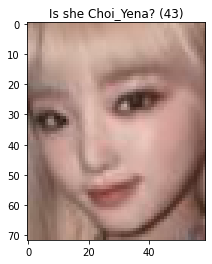

 <<< d : delete, a : pass, e : escape >>> 



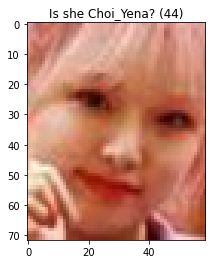

 <<< d : delete, a : pass, e : escape >>> 



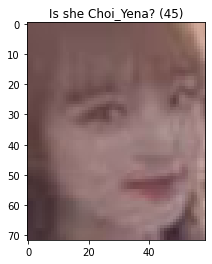

 <<< d : delete, a : pass, e : escape >>> 



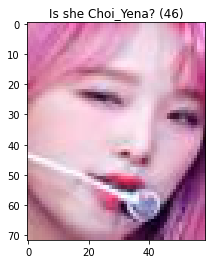

 <<< d : delete, a : pass, e : escape >>> 



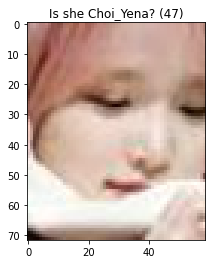

 <<< d : delete, a : pass, e : escape >>> 



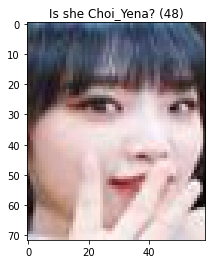

 <<< d : delete, a : pass, e : escape >>> 



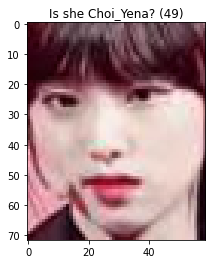

 <<< d : delete, a : pass, e : escape >>> 



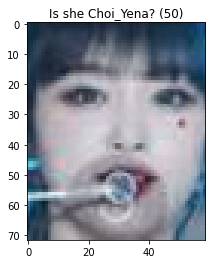

 <<< d : delete, a : pass, e : escape >>> 



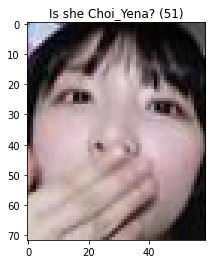

 <<< d : delete, a : pass, e : escape >>> 



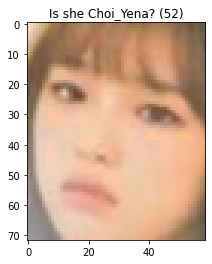

 <<< d : delete, a : pass, e : escape >>> 



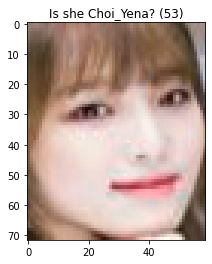

 <<< d : delete, a : pass, e : escape >>> 



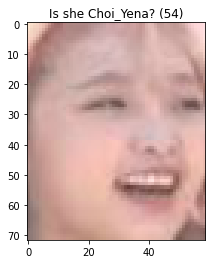

 <<< d : delete, a : pass, e : escape >>> 



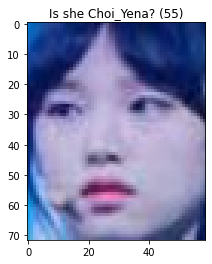

 <<< d : delete, a : pass, e : escape >>> 



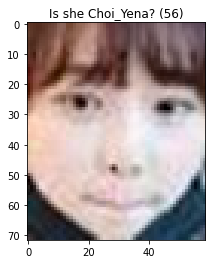

 <<< d : delete, a : pass, e : escape >>> 



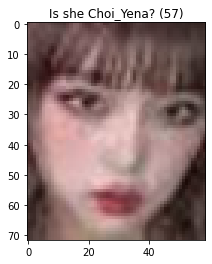

 <<< d : delete, a : pass, e : escape >>> 



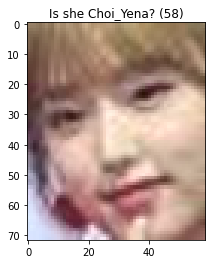

 <<< d : delete, a : pass, e : escape >>> 



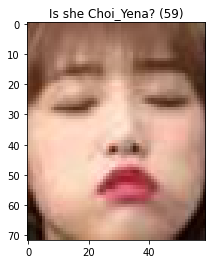

 <<< d : delete, a : pass, e : escape >>> 



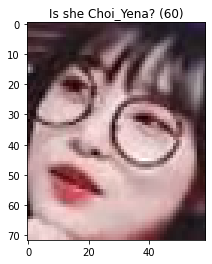

 <<< d : delete, a : pass, e : escape >>> 



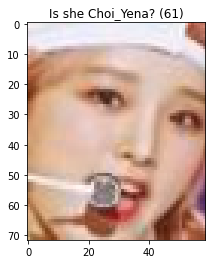

 <<< d : delete, a : pass, e : escape >>> 



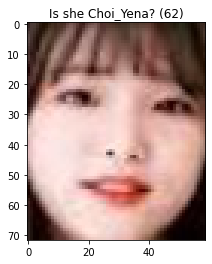

 <<< d : delete, a : pass, e : escape >>> 



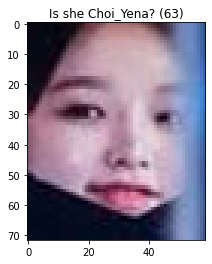

 <<< d : delete, a : pass, e : escape >>> 



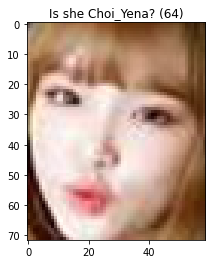

 <<< d : delete, a : pass, e : escape >>> 



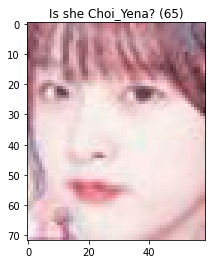

 <<< d : delete, a : pass, e : escape >>> 



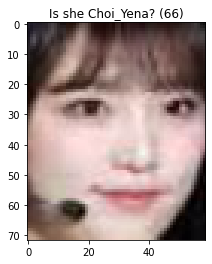

 <<< d : delete, a : pass, e : escape >>> 



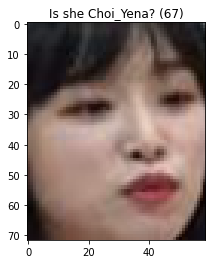

 <<< d : delete, a : pass, e : escape >>> 



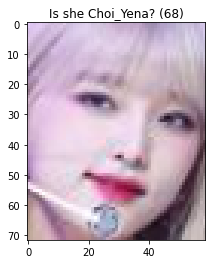

 <<< d : delete, a : pass, e : escape >>> 



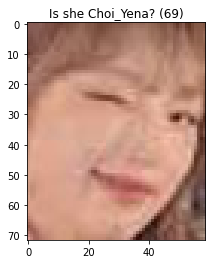

 <<< d : delete, a : pass, e : escape >>> 




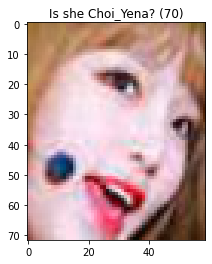

 <<< d : delete, a : pass, e : escape >>> 


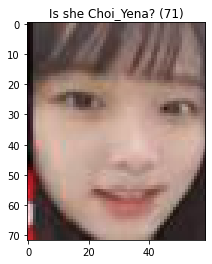

 <<< d : delete, a : pass, e : escape >>> 



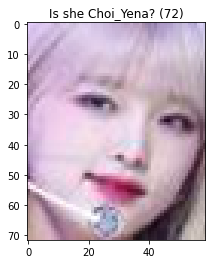

 <<< d : delete, a : pass, e : escape >>> 



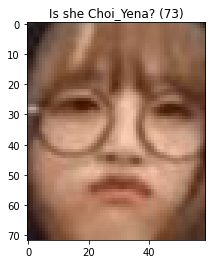

 <<< d : delete, a : pass, e : escape >>> 



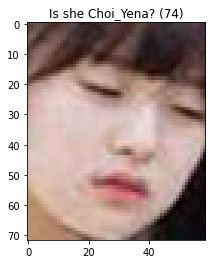

 <<< d : delete, a : pass, e : escape >>> 



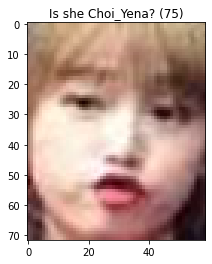

 <<< d : delete, a : pass, e : escape >>> 



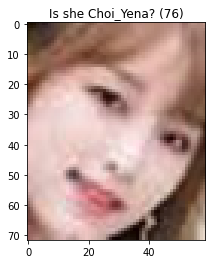

 <<< d : delete, a : pass, e : escape >>> 



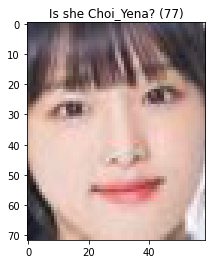

 <<< d : delete, a : pass, e : escape >>> 



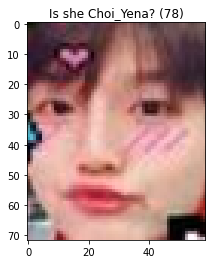

 <<< d : delete, a : pass, e : escape >>> 



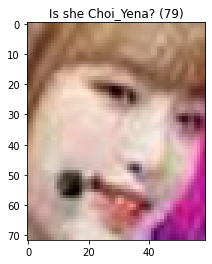

 <<< d : delete, a : pass, e : escape >>> 



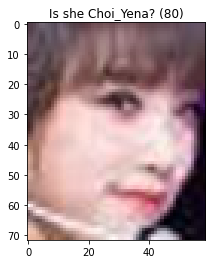

 <<< d : delete, a : pass, e : escape >>> 



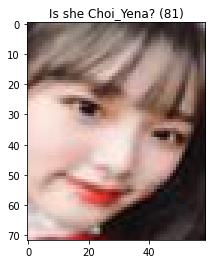

 <<< d : delete, a : pass, e : escape >>> 



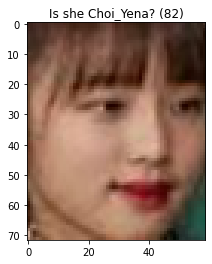

 <<< d : delete, a : pass, e : escape >>> 



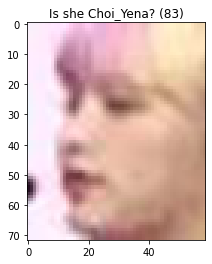

 <<< d : delete, a : pass, e : escape >>> 



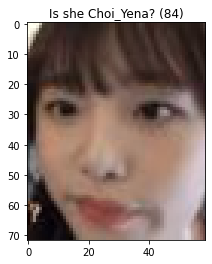

 <<< d : delete, a : pass, e : escape >>> 



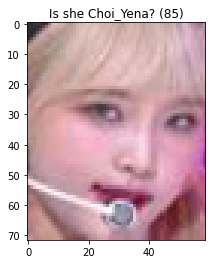

 <<< d : delete, a : pass, e : escape >>> 



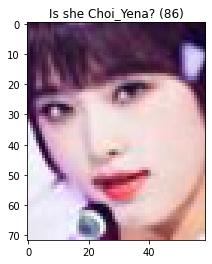

 <<< d : delete, a : pass, e : escape >>> 



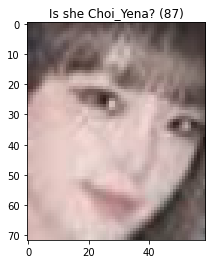

 <<< d : delete, a : pass, e : escape >>> 



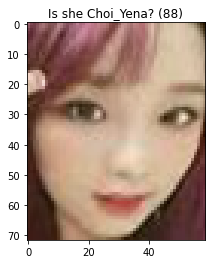

 <<< d : delete, a : pass, e : escape >>> 



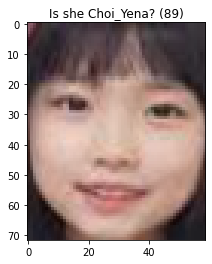

 <<< d : delete, a : pass, e : escape >>> 



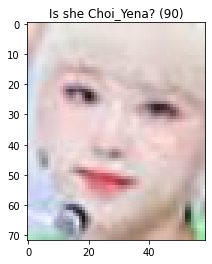

 <<< d : delete, a : pass, e : escape >>> 



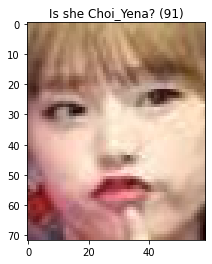

 <<< d : delete, a : pass, e : escape >>> 



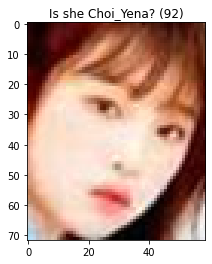

 <<< d : delete, a : pass, e : escape >>> 



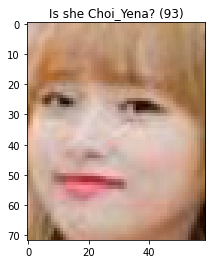

 <<< d : delete, a : pass, e : escape >>> 



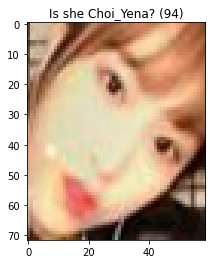

 <<< d : delete, a : pass, e : escape >>> 




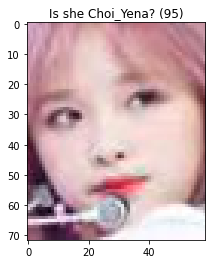

 <<< d : delete, a : pass, e : escape >>> 


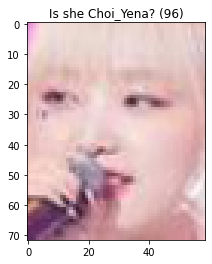

 <<< d : delete, a : pass, e : escape >>> 



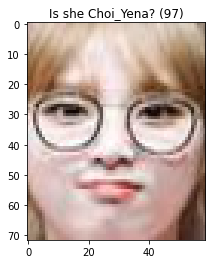

 <<< d : delete, a : pass, e : escape >>> 



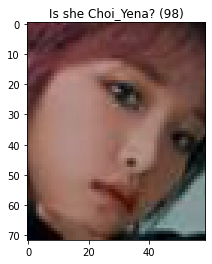

 <<< d : delete, a : pass, e : escape >>> 



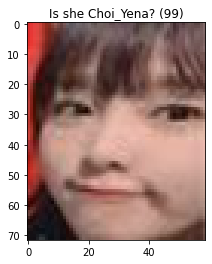

 <<< d : delete, a : pass, e : escape >>> 



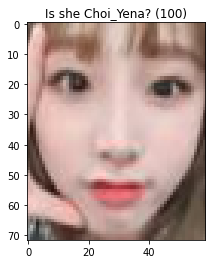

 <<< d : delete, a : pass, e : escape >>> 



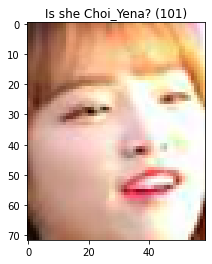

 <<< d : delete, a : pass, e : escape >>> 



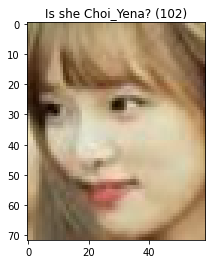

 <<< d : delete, a : pass, e : escape >>> 



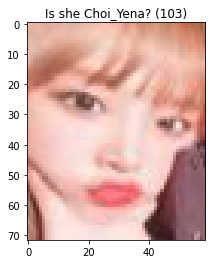

 <<< d : delete, a : pass, e : escape >>> 



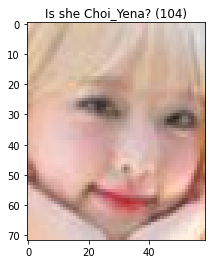

 <<< d : delete, a : pass, e : escape >>> 
a


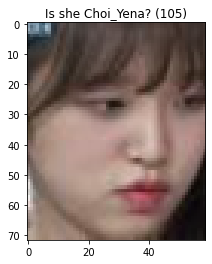

 <<< d : delete, a : pass, e : escape >>> 
a


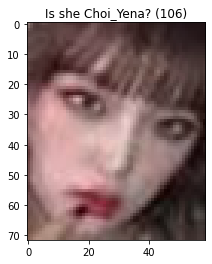

 <<< d : delete, a : pass, e : escape >>> 
a


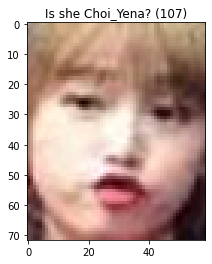

 <<< d : delete, a : pass, e : escape >>> 
a


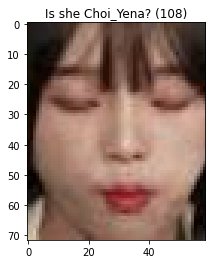

 <<< d : delete, a : pass, e : escape >>> 
a


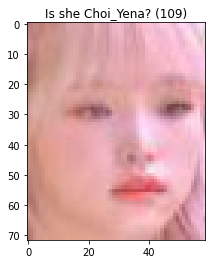

 <<< d : delete, a : pass, e : escape >>> 



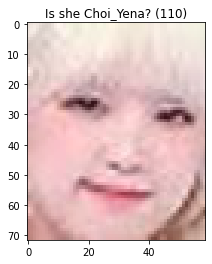

 <<< d : delete, a : pass, e : escape >>> 



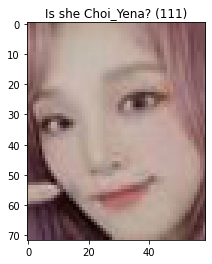

 <<< d : delete, a : pass, e : escape >>> 



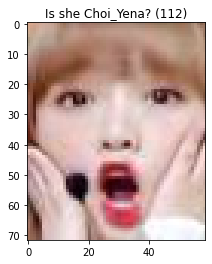

 <<< d : delete, a : pass, e : escape >>> 



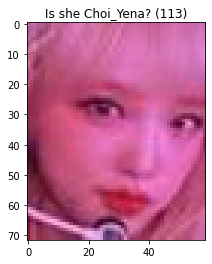

 <<< d : delete, a : pass, e : escape >>> 



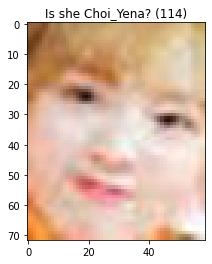

 <<< d : delete, a : pass, e : escape >>> 



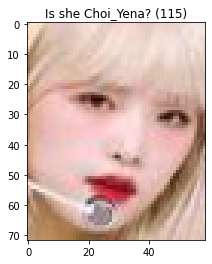

 <<< d : delete, a : pass, e : escape >>> 



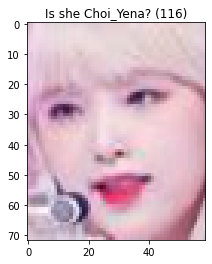

 <<< d : delete, a : pass, e : escape >>> 



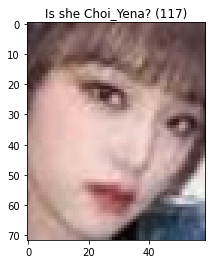

 <<< d : delete, a : pass, e : escape >>> 



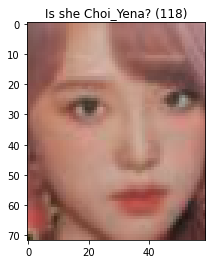

 <<< d : delete, a : pass, e : escape >>> 



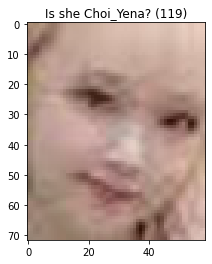

 <<< d : delete, a : pass, e : escape >>> 



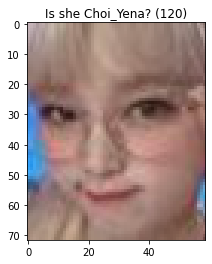

 <<< d : delete, a : pass, e : escape >>> 



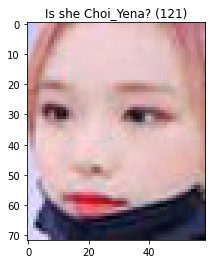

 <<< d : delete, a : pass, e : escape >>> 



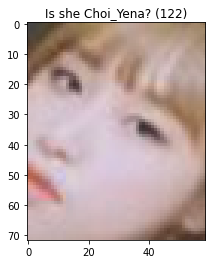

 <<< d : delete, a : pass, e : escape >>> 



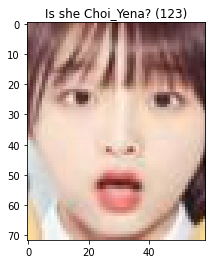

 <<< d : delete, a : pass, e : escape >>> 



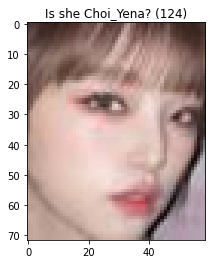

 <<< d : delete, a : pass, e : escape >>> 



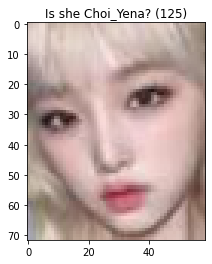

 <<< d : delete, a : pass, e : escape >>> 



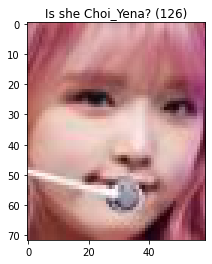

 <<< d : delete, a : pass, e : escape >>> 



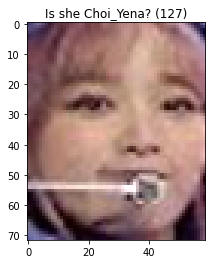

 <<< d : delete, a : pass, e : escape >>> 



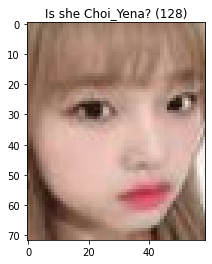

 <<< d : delete, a : pass, e : escape >>> 



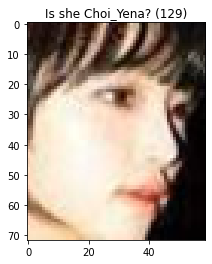

 <<< d : delete, a : pass, e : escape >>> 



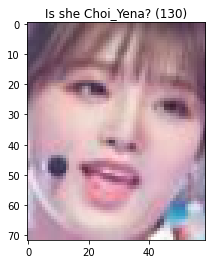

 <<< d : delete, a : pass, e : escape >>> 



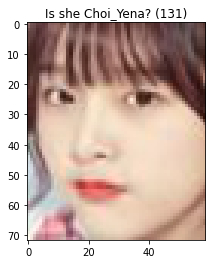

 <<< d : delete, a : pass, e : escape >>> 



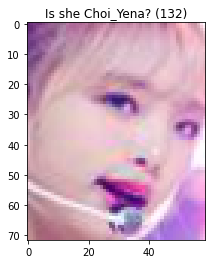

 <<< d : delete, a : pass, e : escape >>> 



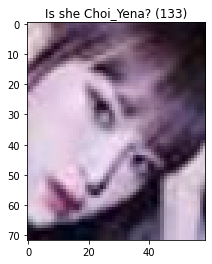

 <<< d : delete, a : pass, e : escape >>> 



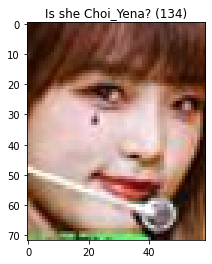

 <<< d : delete, a : pass, e : escape >>> 



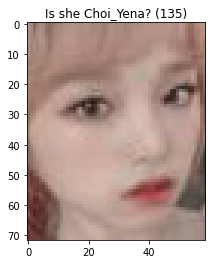

 <<< d : delete, a : pass, e : escape >>> 



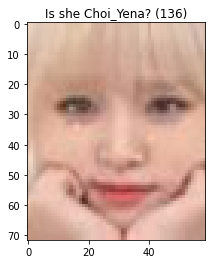

 <<< d : delete, a : pass, e : escape >>> 



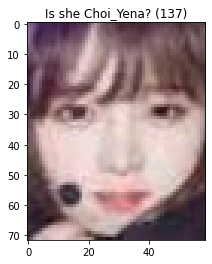

 <<< d : delete, a : pass, e : escape >>> 



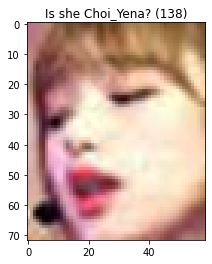

 <<< d : delete, a : pass, e : escape >>> 



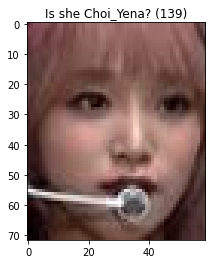

 <<< d : delete, a : pass, e : escape >>> 



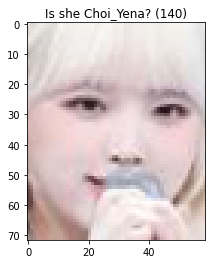

 <<< d : delete, a : pass, e : escape >>> 



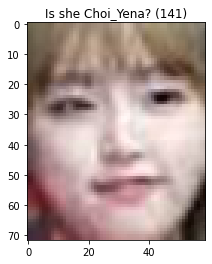

 <<< d : delete, a : pass, e : escape >>> 



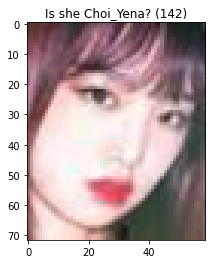

 <<< d : delete, a : pass, e : escape >>> 



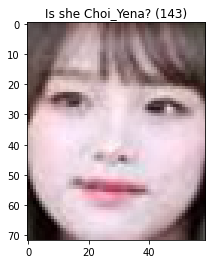

 <<< d : delete, a : pass, e : escape >>> 



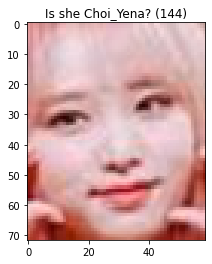

 <<< d : delete, a : pass, e : escape >>> 



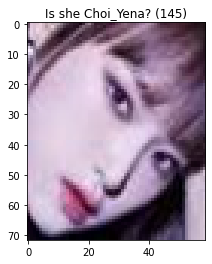

 <<< d : delete, a : pass, e : escape >>> 



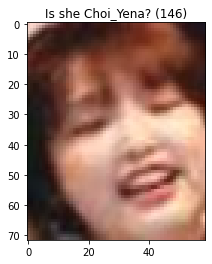

 <<< d : delete, a : pass, e : escape >>> 



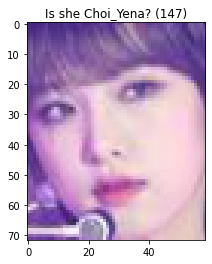

 <<< d : delete, a : pass, e : escape >>> 



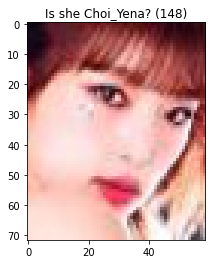

 <<< d : delete, a : pass, e : escape >>> 



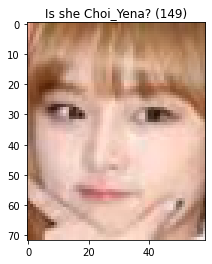

 <<< d : delete, a : pass, e : escape >>> 



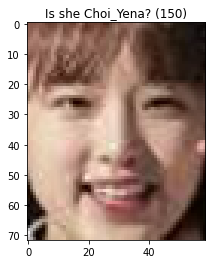

 <<< d : delete, a : pass, e : escape >>> 



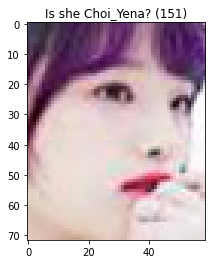

 <<< d : delete, a : pass, e : escape >>> 



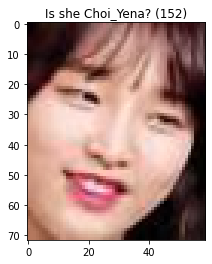

 <<< d : delete, a : pass, e : escape >>> 



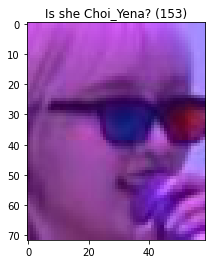

 <<< d : delete, a : pass, e : escape >>> 
d


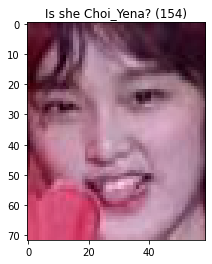

 <<< d : delete, a : pass, e : escape >>> 



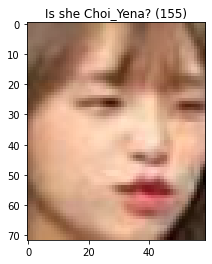

 <<< d : delete, a : pass, e : escape >>> 



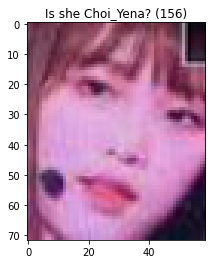

 <<< d : delete, a : pass, e : escape >>> 



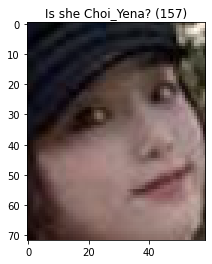

 <<< d : delete, a : pass, e : escape >>> 



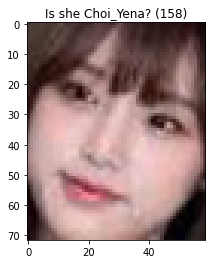

 <<< d : delete, a : pass, e : escape >>> 



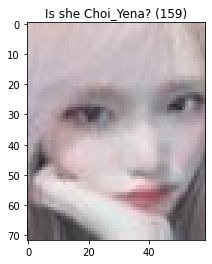

 <<< d : delete, a : pass, e : escape >>> 



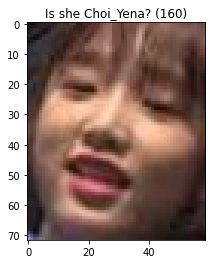

 <<< d : delete, a : pass, e : escape >>> 



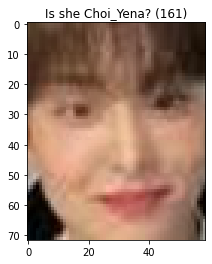

 <<< d : delete, a : pass, e : escape >>> 
d


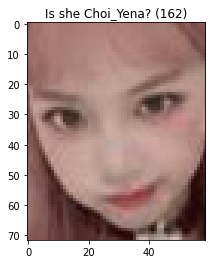

 <<< d : delete, a : pass, e : escape >>> 



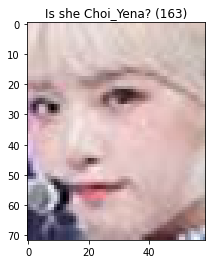

 <<< d : delete, a : pass, e : escape >>> 



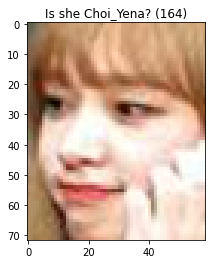

 <<< d : delete, a : pass, e : escape >>> 



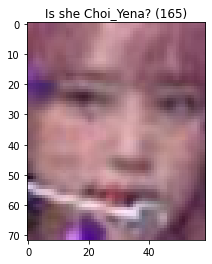

 <<< d : delete, a : pass, e : escape >>> 



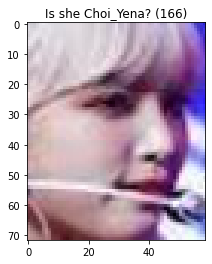

 <<< d : delete, a : pass, e : escape >>> 



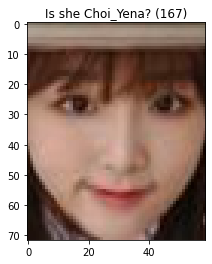

 <<< d : delete, a : pass, e : escape >>> 



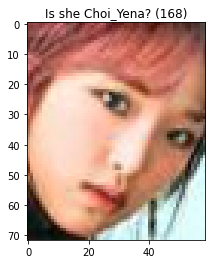

 <<< d : delete, a : pass, e : escape >>> 



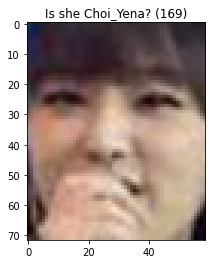

 <<< d : delete, a : pass, e : escape >>> 



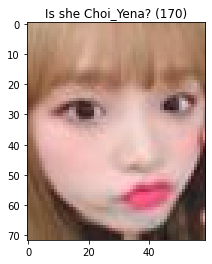

 <<< d : delete, a : pass, e : escape >>> 



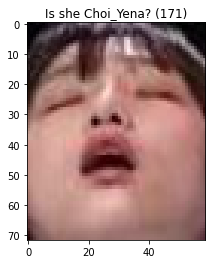

 <<< d : delete, a : pass, e : escape >>> 



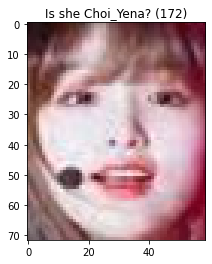

 <<< d : delete, a : pass, e : escape >>> 



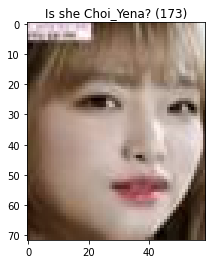

 <<< d : delete, a : pass, e : escape >>> 



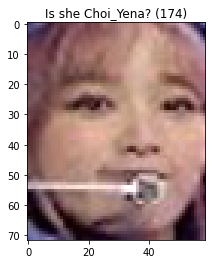

 <<< d : delete, a : pass, e : escape >>> 



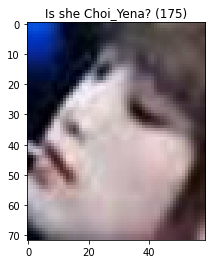

 <<< d : delete, a : pass, e : escape >>> 



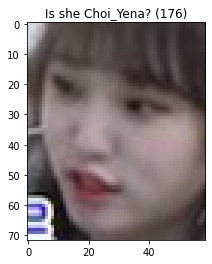

 <<< d : delete, a : pass, e : escape >>> 



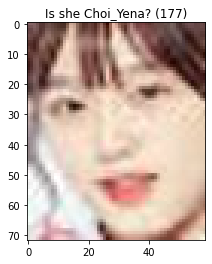

 <<< d : delete, a : pass, e : escape >>> 



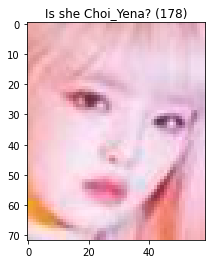

 <<< d : delete, a : pass, e : escape >>> 



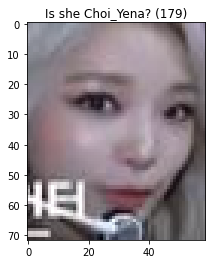

 <<< d : delete, a : pass, e : escape >>> 



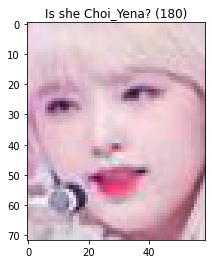

 <<< d : delete, a : pass, e : escape >>> 



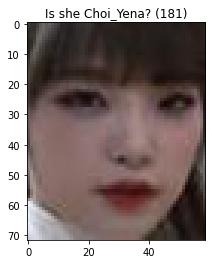

 <<< d : delete, a : pass, e : escape >>> 



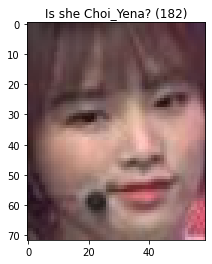

 <<< d : delete, a : pass, e : escape >>> 



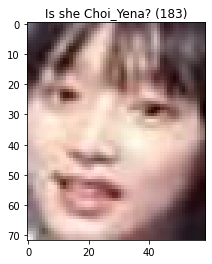

 <<< d : delete, a : pass, e : escape >>> 



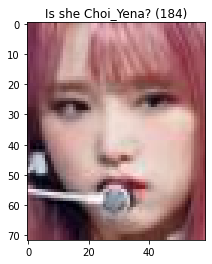

 <<< d : delete, a : pass, e : escape >>> 



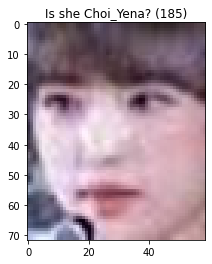

 <<< d : delete, a : pass, e : escape >>> 



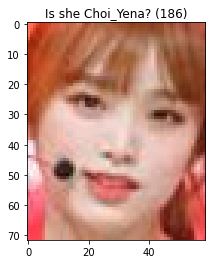

 <<< d : delete, a : pass, e : escape >>> 



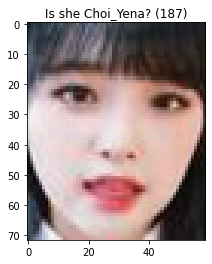

 <<< d : delete, a : pass, e : escape >>> 



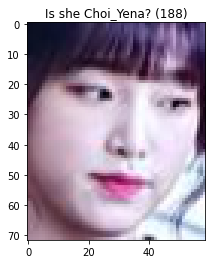

 <<< d : delete, a : pass, e : escape >>> 



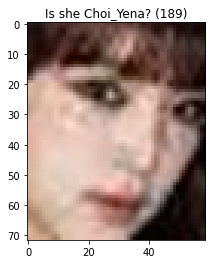

 <<< d : delete, a : pass, e : escape >>> 



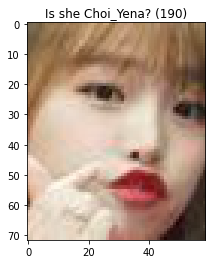

 <<< d : delete, a : pass, e : escape >>> 



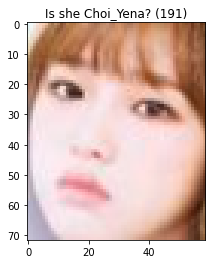

 <<< d : delete, a : pass, e : escape >>> 



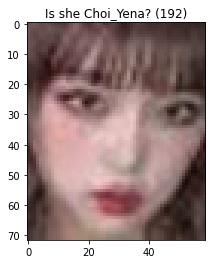

 <<< d : delete, a : pass, e : escape >>> 



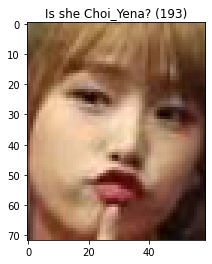

 <<< d : delete, a : pass, e : escape >>> 



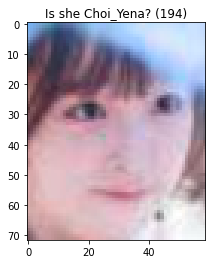

 <<< d : delete, a : pass, e : escape >>> 



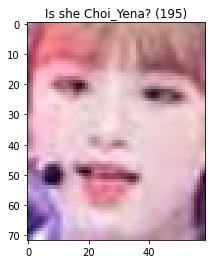

 <<< d : delete, a : pass, e : escape >>> 



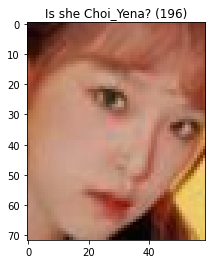

 <<< d : delete, a : pass, e : escape >>> 



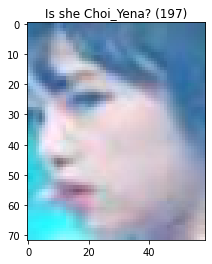

 <<< d : delete, a : pass, e : escape >>> 



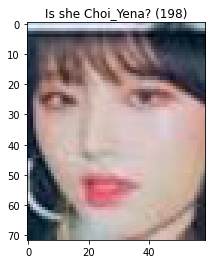

 <<< d : delete, a : pass, e : escape >>> 



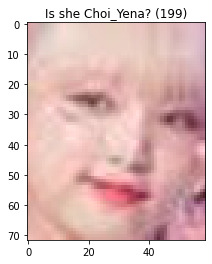

 <<< d : delete, a : pass, e : escape >>> 



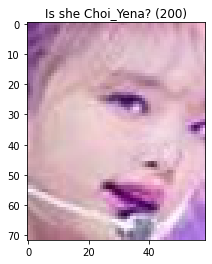

 <<< d : delete, a : pass, e : escape >>> 



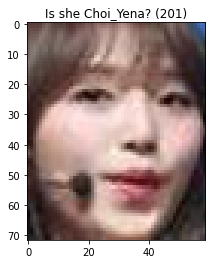

 <<< d : delete, a : pass, e : escape >>> 



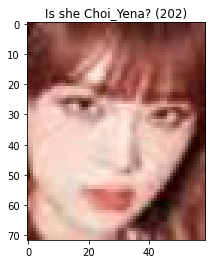

 <<< d : delete, a : pass, e : escape >>> 



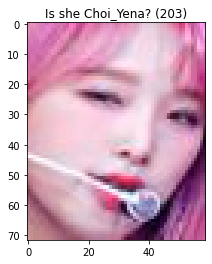

 <<< d : delete, a : pass, e : escape >>> 



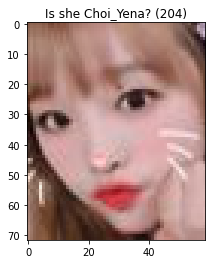

 <<< d : delete, a : pass, e : escape >>> 



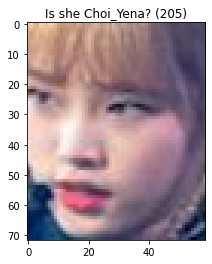

 <<< d : delete, a : pass, e : escape >>> 



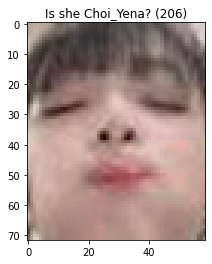

 <<< d : delete, a : pass, e : escape >>> 



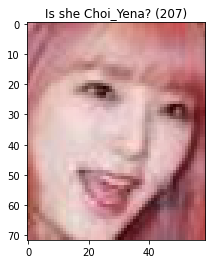

 <<< d : delete, a : pass, e : escape >>> 



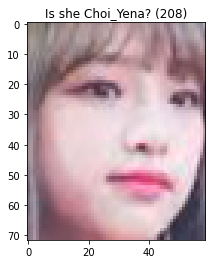

 <<< d : delete, a : pass, e : escape >>> 



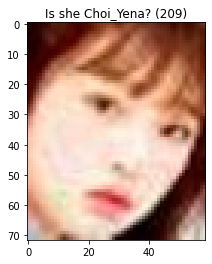

 <<< d : delete, a : pass, e : escape >>> 



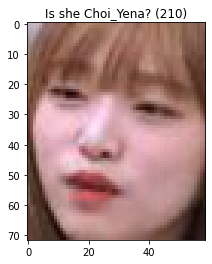

 <<< d : delete, a : pass, e : escape >>> 



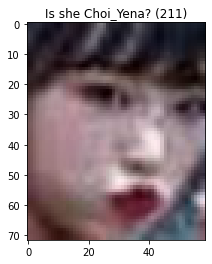

 <<< d : delete, a : pass, e : escape >>> 



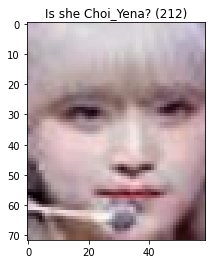

 <<< d : delete, a : pass, e : escape >>> 



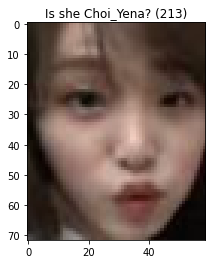

 <<< d : delete, a : pass, e : escape >>> 



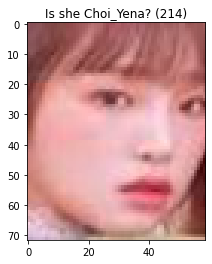

 <<< d : delete, a : pass, e : escape >>> 



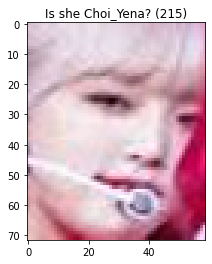

 <<< d : delete, a : pass, e : escape >>> 



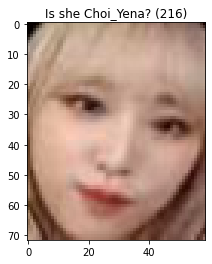

 <<< d : delete, a : pass, e : escape >>> 



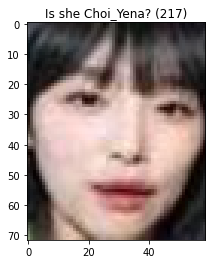

 <<< d : delete, a : pass, e : escape >>> 



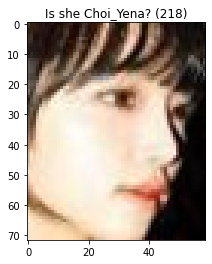

 <<< d : delete, a : pass, e : escape >>> 



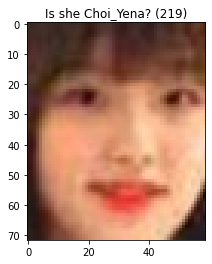

 <<< d : delete, a : pass, e : escape >>> 



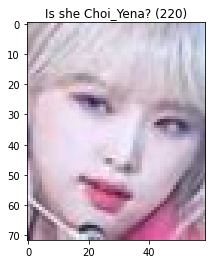

 <<< d : delete, a : pass, e : escape >>> 



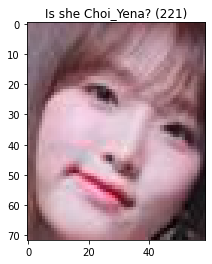

 <<< d : delete, a : pass, e : escape >>> 



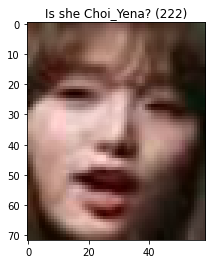

 <<< d : delete, a : pass, e : escape >>> 



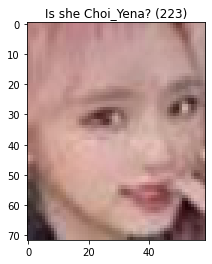

 <<< d : delete, a : pass, e : escape >>> 



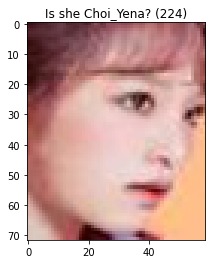

 <<< d : delete, a : pass, e : escape >>> 



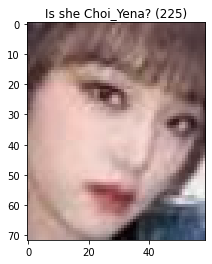

 <<< d : delete, a : pass, e : escape >>> 



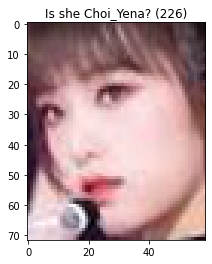

 <<< d : delete, a : pass, e : escape >>> 



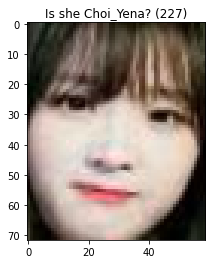

 <<< d : delete, a : pass, e : escape >>> 



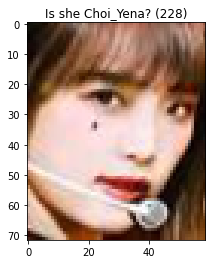

 <<< d : delete, a : pass, e : escape >>> 



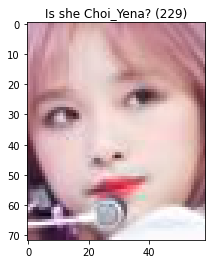

 <<< d : delete, a : pass, e : escape >>> 



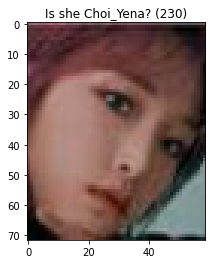

 <<< d : delete, a : pass, e : escape >>> 



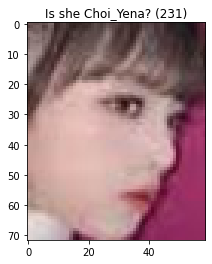

 <<< d : delete, a : pass, e : escape >>> 



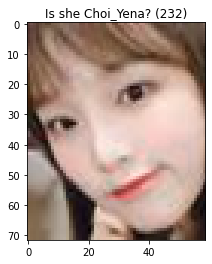

 <<< d : delete, a : pass, e : escape >>> 



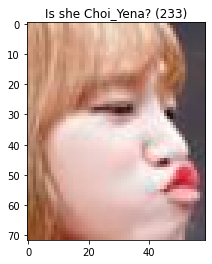

 <<< d : delete, a : pass, e : escape >>> 



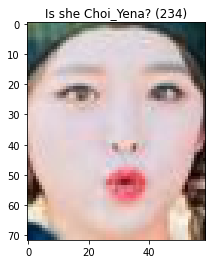

 <<< d : delete, a : pass, e : escape >>> 



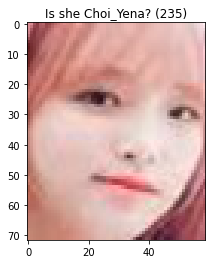

 <<< d : delete, a : pass, e : escape >>> 



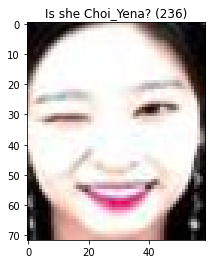

 <<< d : delete, a : pass, e : escape >>> 
d


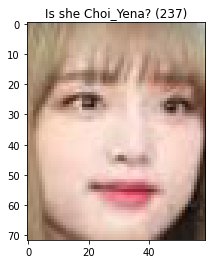

 <<< d : delete, a : pass, e : escape >>> 



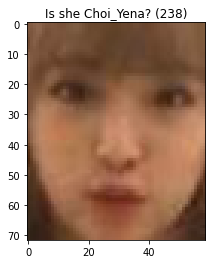

 <<< d : delete, a : pass, e : escape >>> 



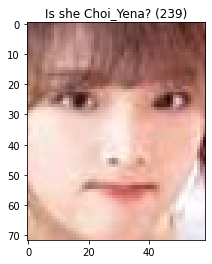

 <<< d : delete, a : pass, e : escape >>> 



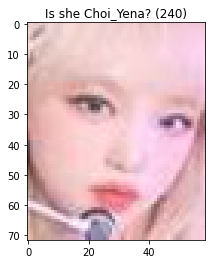

 <<< d : delete, a : pass, e : escape >>> 



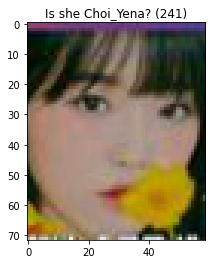

 <<< d : delete, a : pass, e : escape >>> 



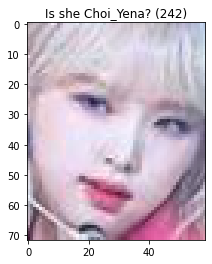

 <<< d : delete, a : pass, e : escape >>> 



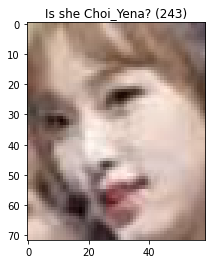

 <<< d : delete, a : pass, e : escape >>> 



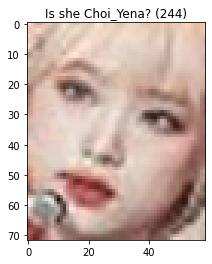

 <<< d : delete, a : pass, e : escape >>> 



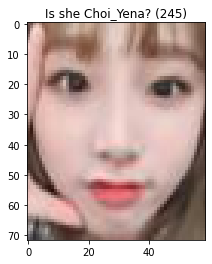

 <<< d : delete, a : pass, e : escape >>> 



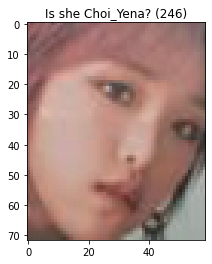

 <<< d : delete, a : pass, e : escape >>> 



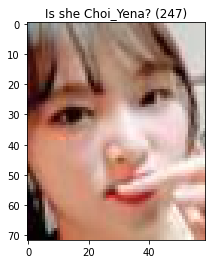

 <<< d : delete, a : pass, e : escape >>> 



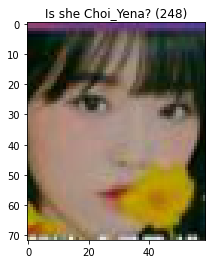

 <<< d : delete, a : pass, e : escape >>> 



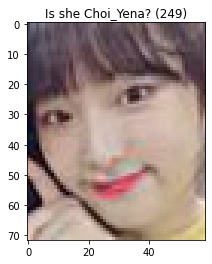

 <<< d : delete, a : pass, e : escape >>> 



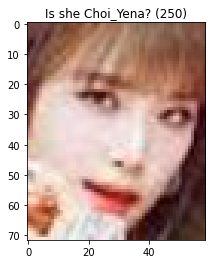

 <<< d : delete, a : pass, e : escape >>> 



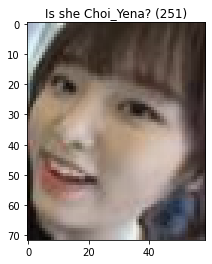

 <<< d : delete, a : pass, e : escape >>> 



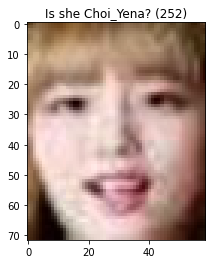

 <<< d : delete, a : pass, e : escape >>> 



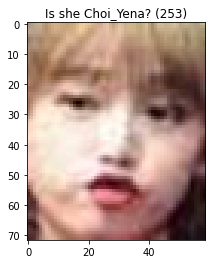

 <<< d : delete, a : pass, e : escape >>> 



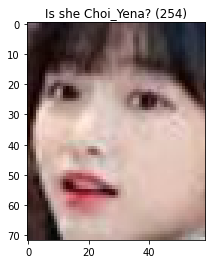

 <<< d : delete, a : pass, e : escape >>> 



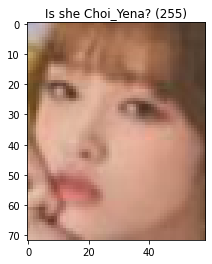

 <<< d : delete, a : pass, e : escape >>> 



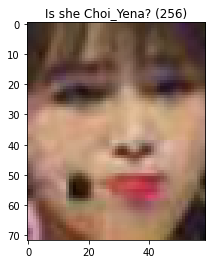

 <<< d : delete, a : pass, e : escape >>> 



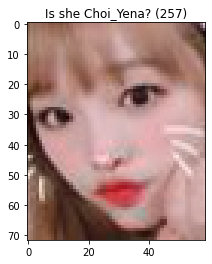

 <<< d : delete, a : pass, e : escape >>> 



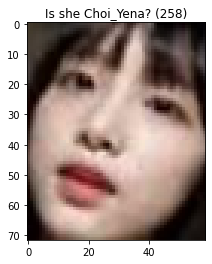

 <<< d : delete, a : pass, e : escape >>> 



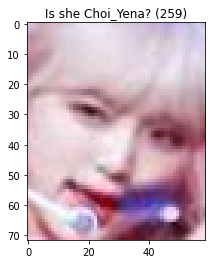

 <<< d : delete, a : pass, e : escape >>> 



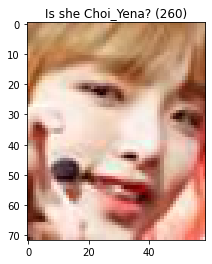

 <<< d : delete, a : pass, e : escape >>> 



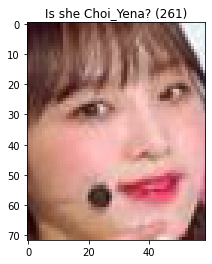

 <<< d : delete, a : pass, e : escape >>> 



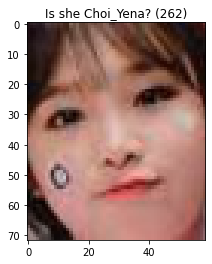

 <<< d : delete, a : pass, e : escape >>> 



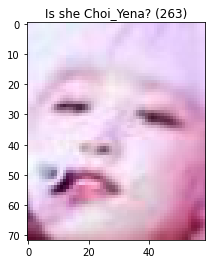

 <<< d : delete, a : pass, e : escape >>> 



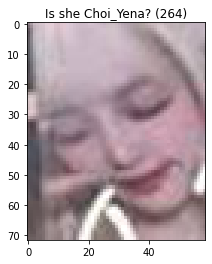

 <<< d : delete, a : pass, e : escape >>> 



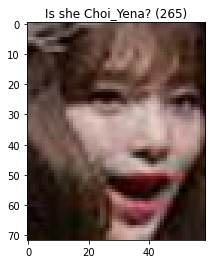

 <<< d : delete, a : pass, e : escape >>> 
d


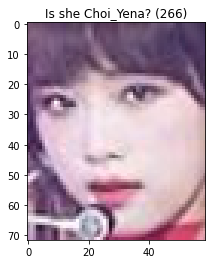

 <<< d : delete, a : pass, e : escape >>> 



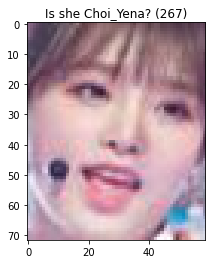

 <<< d : delete, a : pass, e : escape >>> 



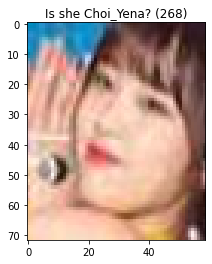

 <<< d : delete, a : pass, e : escape >>> 



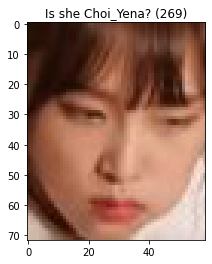

 <<< d : delete, a : pass, e : escape >>> 



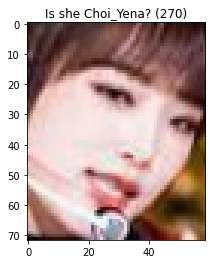

 <<< d : delete, a : pass, e : escape >>> 



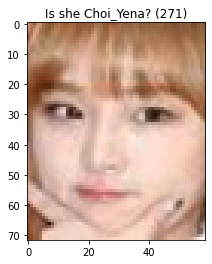

 <<< d : delete, a : pass, e : escape >>> 



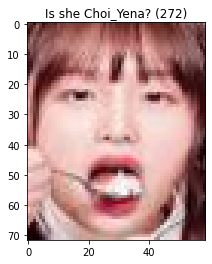

 <<< d : delete, a : pass, e : escape >>> 



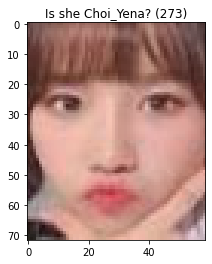

 <<< d : delete, a : pass, e : escape >>> 



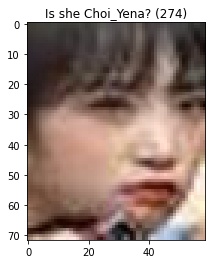

 <<< d : delete, a : pass, e : escape >>> 
d


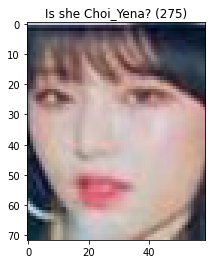

 <<< d : delete, a : pass, e : escape >>> 



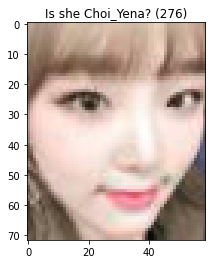

 <<< d : delete, a : pass, e : escape >>> 



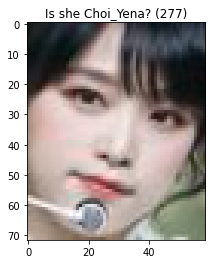

 <<< d : delete, a : pass, e : escape >>> 



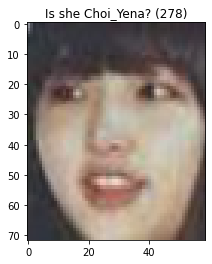

 <<< d : delete, a : pass, e : escape >>> 



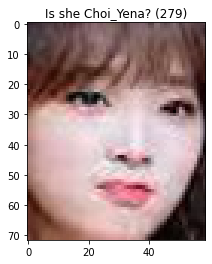

 <<< d : delete, a : pass, e : escape >>> 



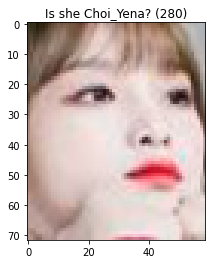

 <<< d : delete, a : pass, e : escape >>> 



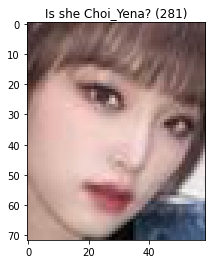

 <<< d : delete, a : pass, e : escape >>> 



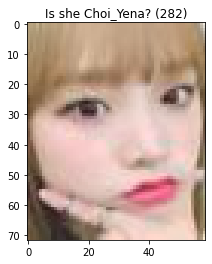

 <<< d : delete, a : pass, e : escape >>> 



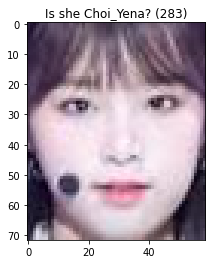

 <<< d : delete, a : pass, e : escape >>> 



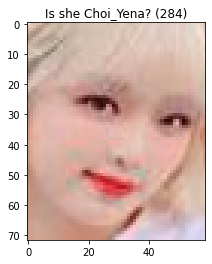

 <<< d : delete, a : pass, e : escape >>> 



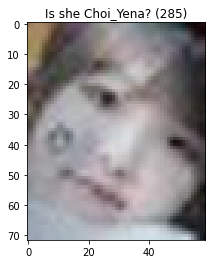

 <<< d : delete, a : pass, e : escape >>> 



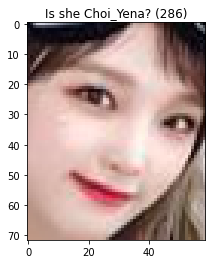

 <<< d : delete, a : pass, e : escape >>> 



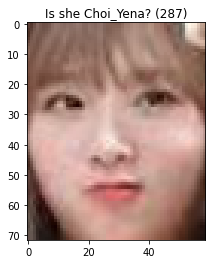

 <<< d : delete, a : pass, e : escape >>> 



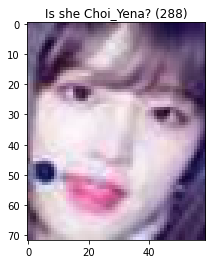

 <<< d : delete, a : pass, e : escape >>> 



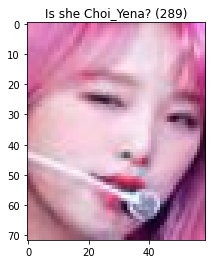

 <<< d : delete, a : pass, e : escape >>> 



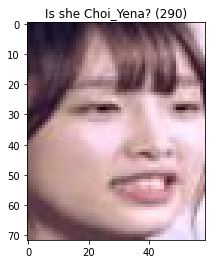

 <<< d : delete, a : pass, e : escape >>> 



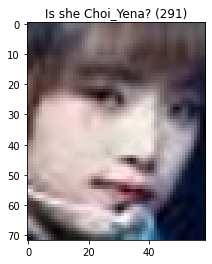

 <<< d : delete, a : pass, e : escape >>> 



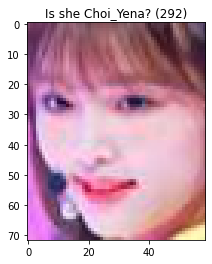

 <<< d : delete, a : pass, e : escape >>> 



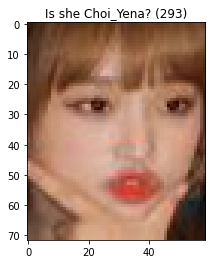

 <<< d : delete, a : pass, e : escape >>> 



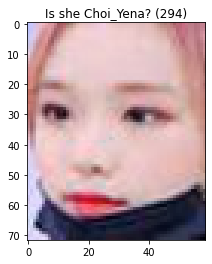

 <<< d : delete, a : pass, e : escape >>> 



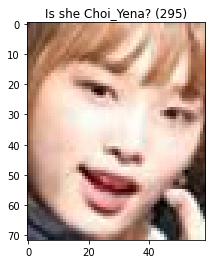

 <<< d : delete, a : pass, e : escape >>> 



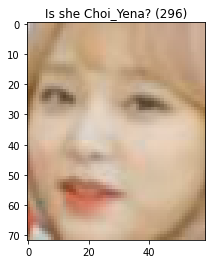

 <<< d : delete, a : pass, e : escape >>> 



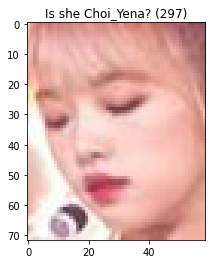

 <<< d : delete, a : pass, e : escape >>> 



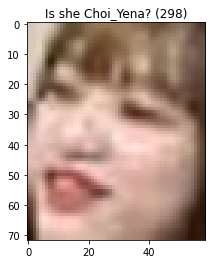

 <<< d : delete, a : pass, e : escape >>> 



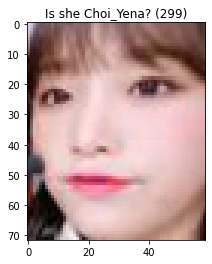

 <<< d : delete, a : pass, e : escape >>> 



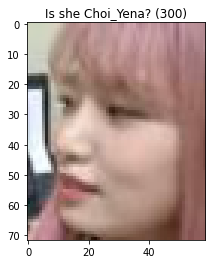

 <<< d : delete, a : pass, e : escape >>> 



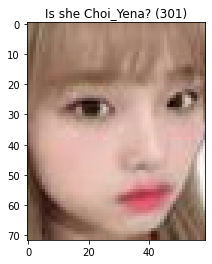

 <<< d : delete, a : pass, e : escape >>> 



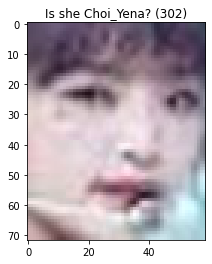

 <<< d : delete, a : pass, e : escape >>> 



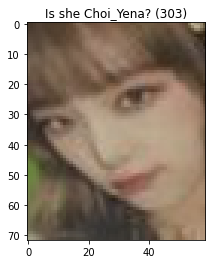

 <<< d : delete, a : pass, e : escape >>> 



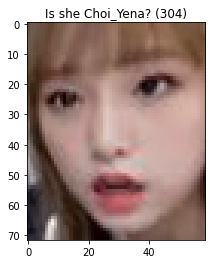

 <<< d : delete, a : pass, e : escape >>> 



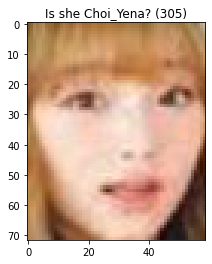

 <<< d : delete, a : pass, e : escape >>> 



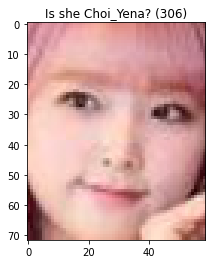

 <<< d : delete, a : pass, e : escape >>> 



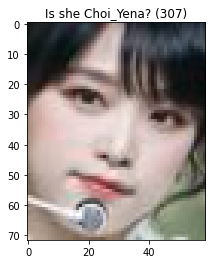

 <<< d : delete, a : pass, e : escape >>> 



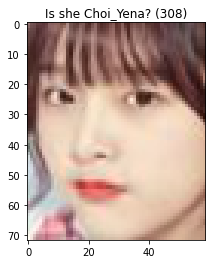

 <<< d : delete, a : pass, e : escape >>> 



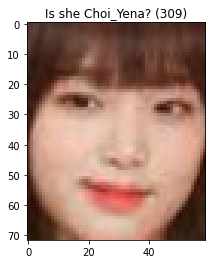

 <<< d : delete, a : pass, e : escape >>> 



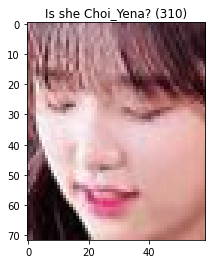

 <<< d : delete, a : pass, e : escape >>> 



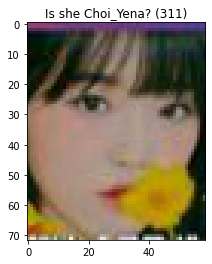

 <<< d : delete, a : pass, e : escape >>> 



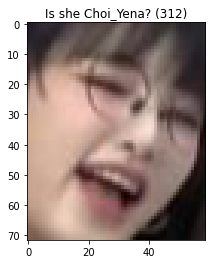

 <<< d : delete, a : pass, e : escape >>> 



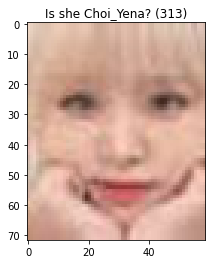

 <<< d : delete, a : pass, e : escape >>> 



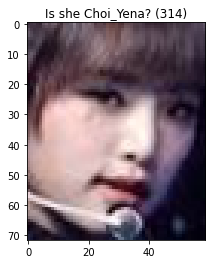

 <<< d : delete, a : pass, e : escape >>> 



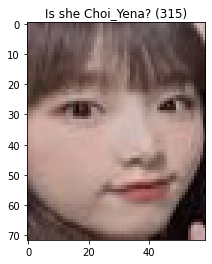

 <<< d : delete, a : pass, e : escape >>> 



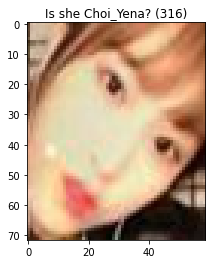

 <<< d : delete, a : pass, e : escape >>> 



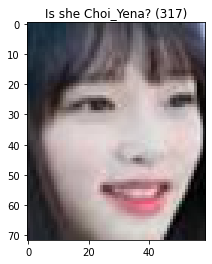

 <<< d : delete, a : pass, e : escape >>> 



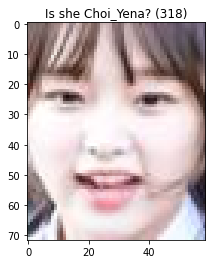

 <<< d : delete, a : pass, e : escape >>> 



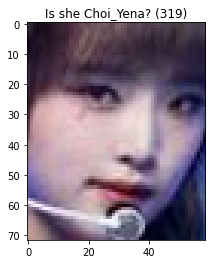

 <<< d : delete, a : pass, e : escape >>> 



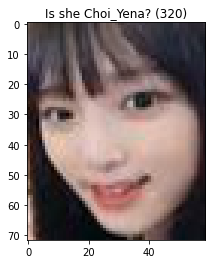

 <<< d : delete, a : pass, e : escape >>> 



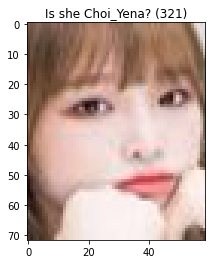

 <<< d : delete, a : pass, e : escape >>> 



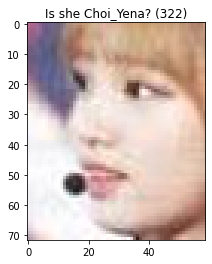

 <<< d : delete, a : pass, e : escape >>> 



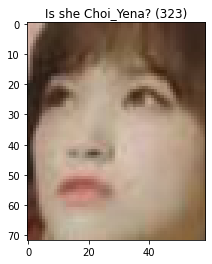

 <<< d : delete, a : pass, e : escape >>> 



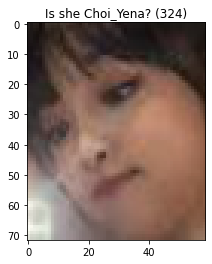

 <<< d : delete, a : pass, e : escape >>> 



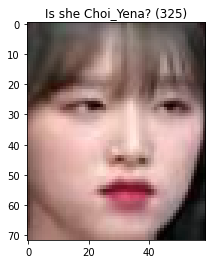

 <<< d : delete, a : pass, e : escape >>> 



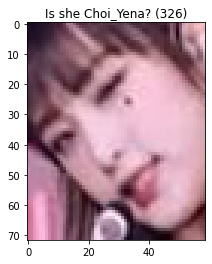

 <<< d : delete, a : pass, e : escape >>> 



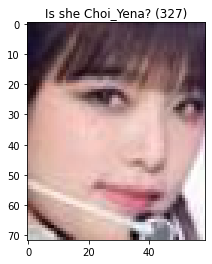

 <<< d : delete, a : pass, e : escape >>> 



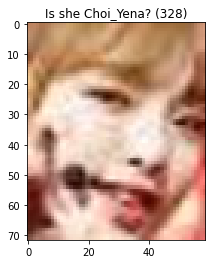

 <<< d : delete, a : pass, e : escape >>> 
d


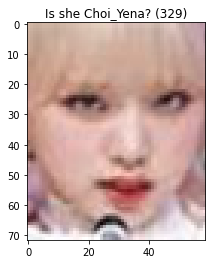

 <<< d : delete, a : pass, e : escape >>> 



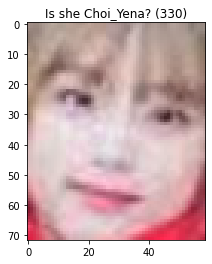

 <<< d : delete, a : pass, e : escape >>> 



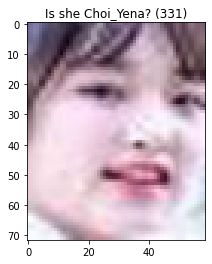

 <<< d : delete, a : pass, e : escape >>> 



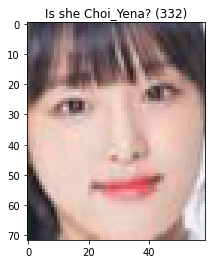

 <<< d : delete, a : pass, e : escape >>> 



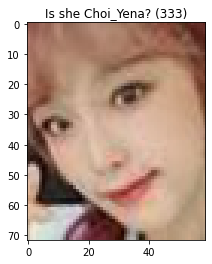

 <<< d : delete, a : pass, e : escape >>> 



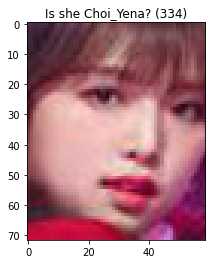

 <<< d : delete, a : pass, e : escape >>> 



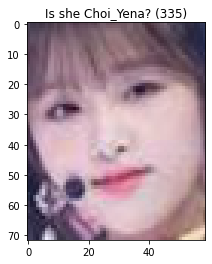

 <<< d : delete, a : pass, e : escape >>> 



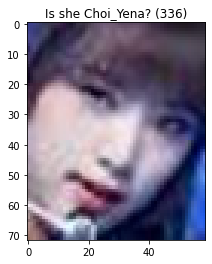

 <<< d : delete, a : pass, e : escape >>> 



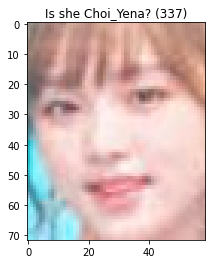

 <<< d : delete, a : pass, e : escape >>> 



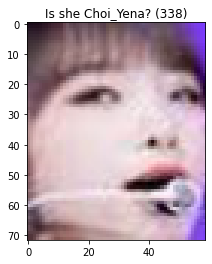

 <<< d : delete, a : pass, e : escape >>> 



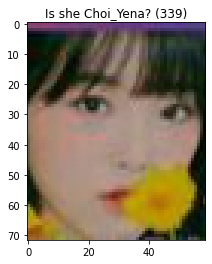

 <<< d : delete, a : pass, e : escape >>> 



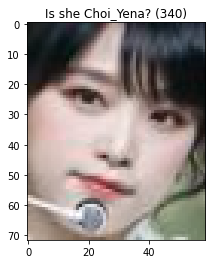

 <<< d : delete, a : pass, e : escape >>> 



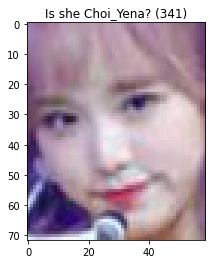

 <<< d : delete, a : pass, e : escape >>> 



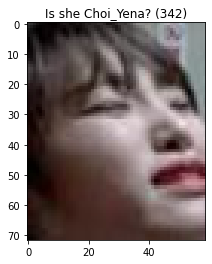

 <<< d : delete, a : pass, e : escape >>> 



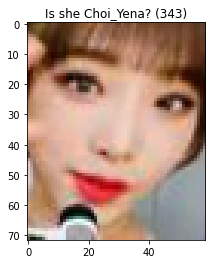

 <<< d : delete, a : pass, e : escape >>> 



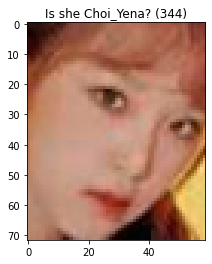

 <<< d : delete, a : pass, e : escape >>> 



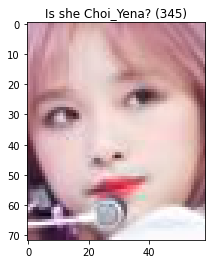

 <<< d : delete, a : pass, e : escape >>> 
a


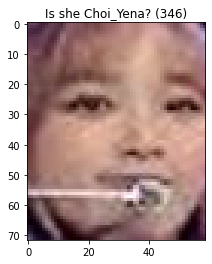

 <<< d : delete, a : pass, e : escape >>> 
a


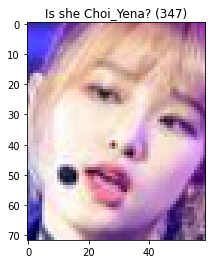

 <<< d : delete, a : pass, e : escape >>> 
a


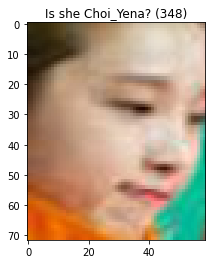

 <<< d : delete, a : pass, e : escape >>> 
d


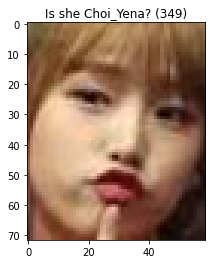

 <<< d : delete, a : pass, e : escape >>> 



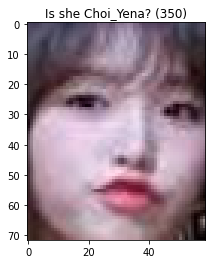

 <<< d : delete, a : pass, e : escape >>> 



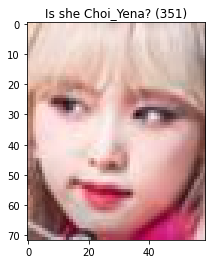

 <<< d : delete, a : pass, e : escape >>> 



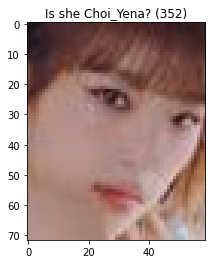

 <<< d : delete, a : pass, e : escape >>> 



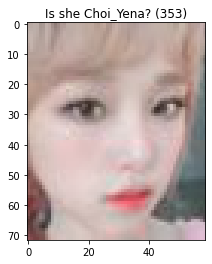

 <<< d : delete, a : pass, e : escape >>> 



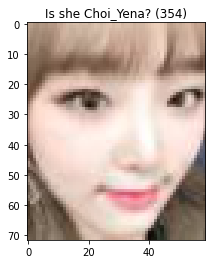

 <<< d : delete, a : pass, e : escape >>> 



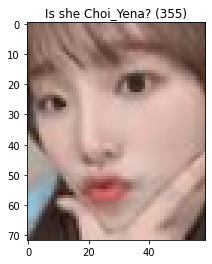

 <<< d : delete, a : pass, e : escape >>> 



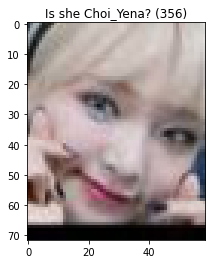

 <<< d : delete, a : pass, e : escape >>> 



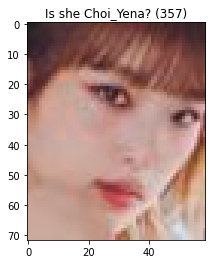

 <<< d : delete, a : pass, e : escape >>> 



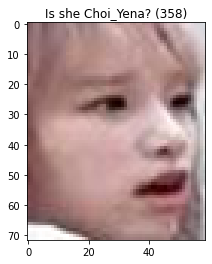

 <<< d : delete, a : pass, e : escape >>> 



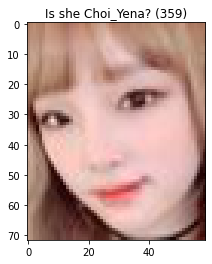

 <<< d : delete, a : pass, e : escape >>> 
a


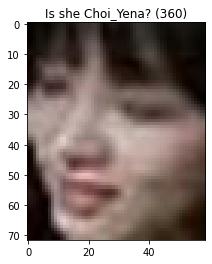

 <<< d : delete, a : pass, e : escape >>> 
d


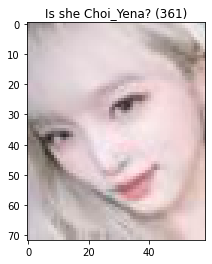

 <<< d : delete, a : pass, e : escape >>> 
a


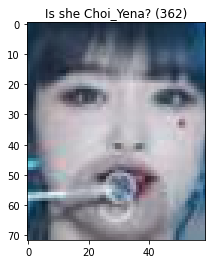

 <<< d : delete, a : pass, e : escape >>> 



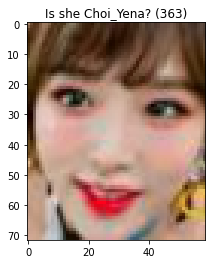

 <<< d : delete, a : pass, e : escape >>> 



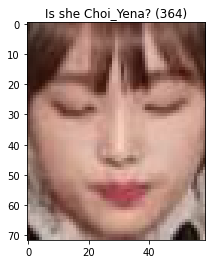

 <<< d : delete, a : pass, e : escape >>> 



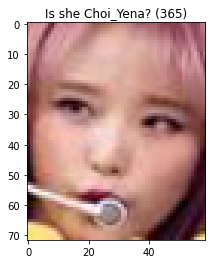

 <<< d : delete, a : pass, e : escape >>> 



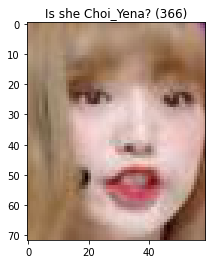

 <<< d : delete, a : pass, e : escape >>> 



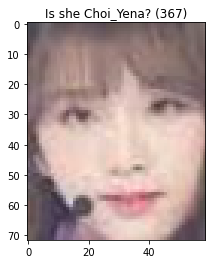

 <<< d : delete, a : pass, e : escape >>> 



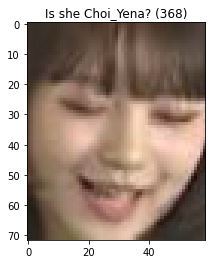

 <<< d : delete, a : pass, e : escape >>> 
d


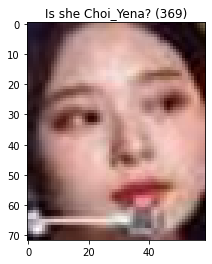

 <<< d : delete, a : pass, e : escape >>> 
d


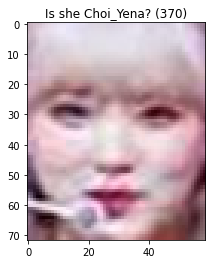

 <<< d : delete, a : pass, e : escape >>> 



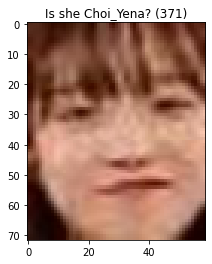

 <<< d : delete, a : pass, e : escape >>> 
d


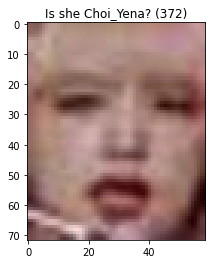

 <<< d : delete, a : pass, e : escape >>> 
d


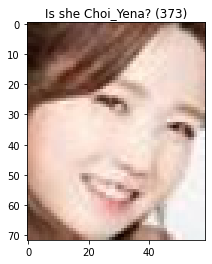

 <<< d : delete, a : pass, e : escape >>> 
d


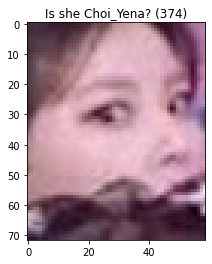

 <<< d : delete, a : pass, e : escape >>> 
d


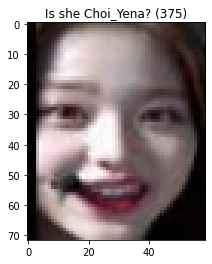

 <<< d : delete, a : pass, e : escape >>> 
d


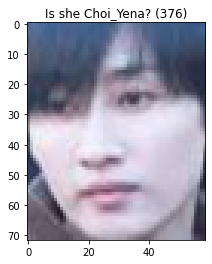

 <<< d : delete, a : pass, e : escape >>> 
d


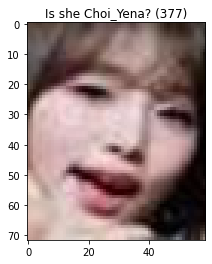

 <<< d : delete, a : pass, e : escape >>> 
a


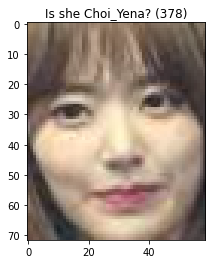

 <<< d : delete, a : pass, e : escape >>> 
d


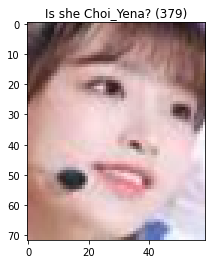

 <<< d : delete, a : pass, e : escape >>> 
a


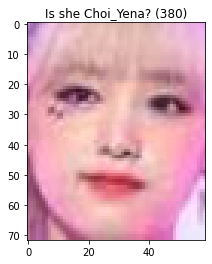

 <<< d : delete, a : pass, e : escape >>> 
a


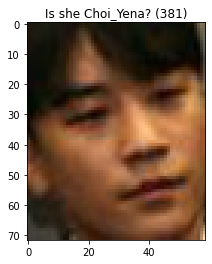

 <<< d : delete, a : pass, e : escape >>> 
d


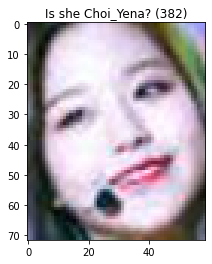

 <<< d : delete, a : pass, e : escape >>> 
d


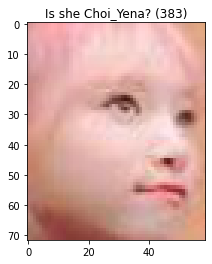

 <<< d : delete, a : pass, e : escape >>> 
d


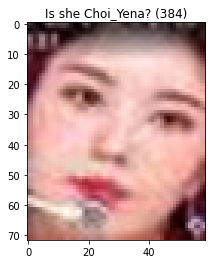

 <<< d : delete, a : pass, e : escape >>> 
d


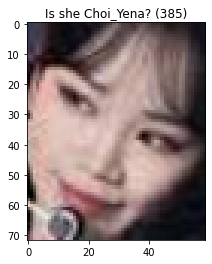

 <<< d : delete, a : pass, e : escape >>> 
d


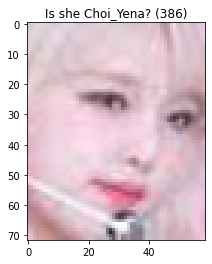

 <<< d : delete, a : pass, e : escape >>> 
a


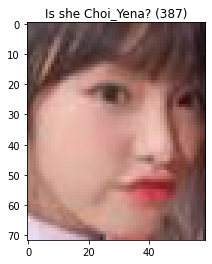

 <<< d : delete, a : pass, e : escape >>> 
a


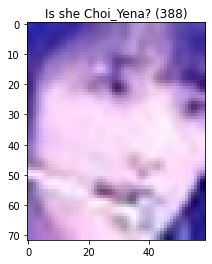

 <<< d : delete, a : pass, e : escape >>> 
d


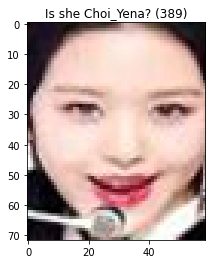

 <<< d : delete, a : pass, e : escape >>> 
d


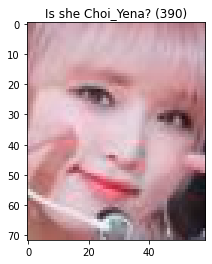

 <<< d : delete, a : pass, e : escape >>> 
a


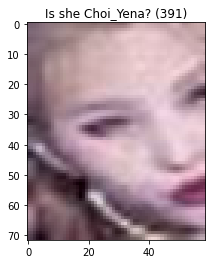

 <<< d : delete, a : pass, e : escape >>> 
d


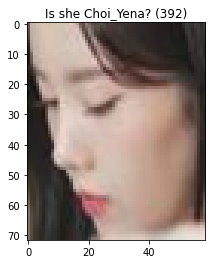

 <<< d : delete, a : pass, e : escape >>> 
d


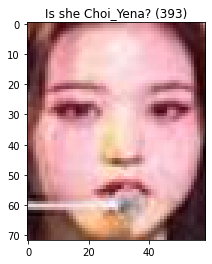

 <<< d : delete, a : pass, e : escape >>> 
d


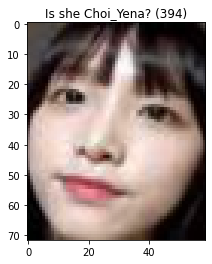

 <<< d : delete, a : pass, e : escape >>> 
a


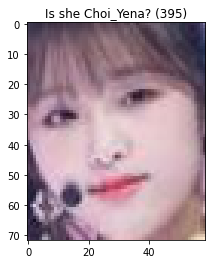

 <<< d : delete, a : pass, e : escape >>> 
a


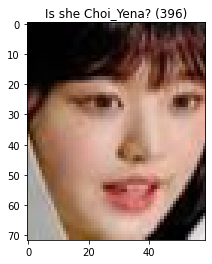

 <<< d : delete, a : pass, e : escape >>> 
d


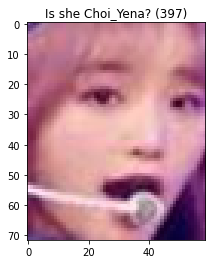

 <<< d : delete, a : pass, e : escape >>> 
a


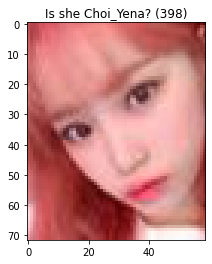

 <<< d : delete, a : pass, e : escape >>> 
d


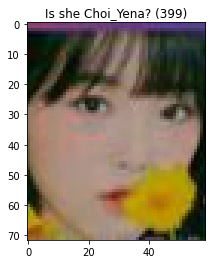

 <<< d : delete, a : pass, e : escape >>> 
d


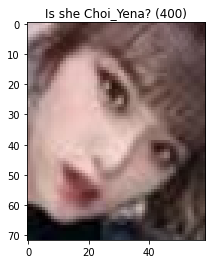

 <<< d : delete, a : pass, e : escape >>> 
a


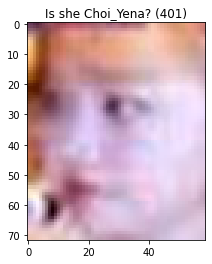

 <<< d : delete, a : pass, e : escape >>> 
d


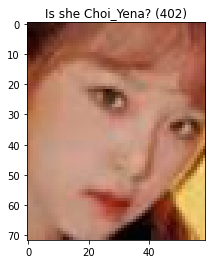

 <<< d : delete, a : pass, e : escape >>> 
a


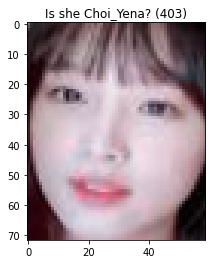

 <<< d : delete, a : pass, e : escape >>> 
a


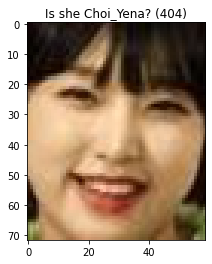

 <<< d : delete, a : pass, e : escape >>> 
a


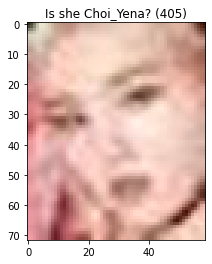

 <<< d : delete, a : pass, e : escape >>> 
d


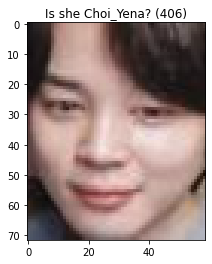

 <<< d : delete, a : pass, e : escape >>> 
d


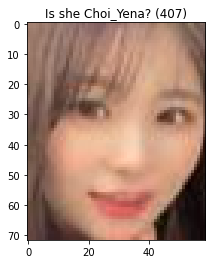

 <<< d : delete, a : pass, e : escape >>> 
d


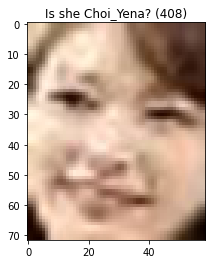

 <<< d : delete, a : pass, e : escape >>> 
d


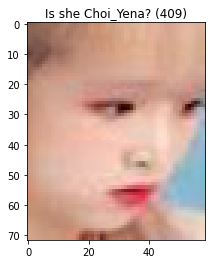

 <<< d : delete, a : pass, e : escape >>> 
a


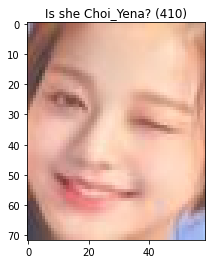

 <<< d : delete, a : pass, e : escape >>> 
d


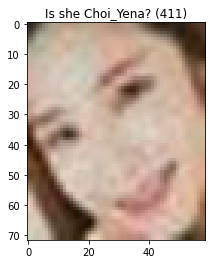

 <<< d : delete, a : pass, e : escape >>> 
d


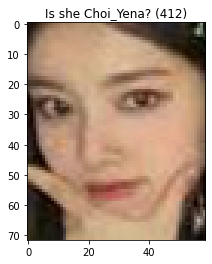

 <<< d : delete, a : pass, e : escape >>> 
d


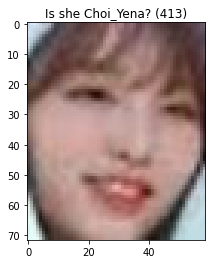

 <<< d : delete, a : pass, e : escape >>> 
a


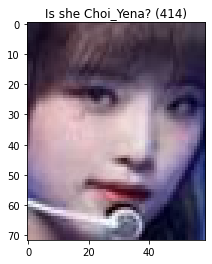

 <<< d : delete, a : pass, e : escape >>> 
a


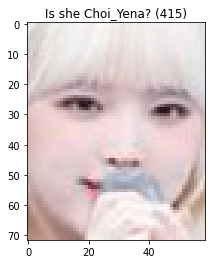

 <<< d : delete, a : pass, e : escape >>> 
a


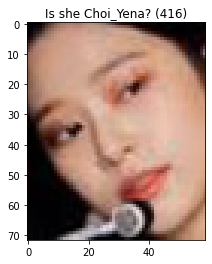

 <<< d : delete, a : pass, e : escape >>> 
d


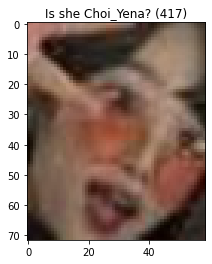

 <<< d : delete, a : pass, e : escape >>> 
a


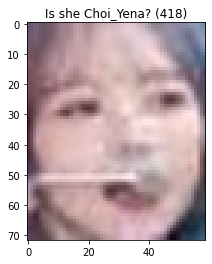

 <<< d : delete, a : pass, e : escape >>> 
d


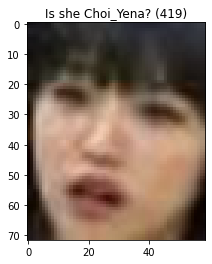

 <<< d : delete, a : pass, e : escape >>> 
a


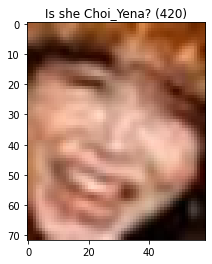

 <<< d : delete, a : pass, e : escape >>> 
d


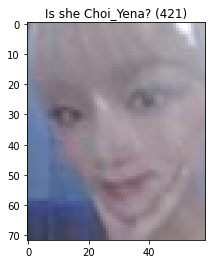

 <<< d : delete, a : pass, e : escape >>> 
a


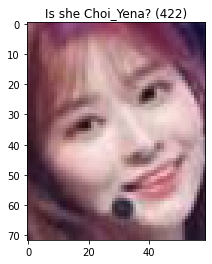

 <<< d : delete, a : pass, e : escape >>> 
d


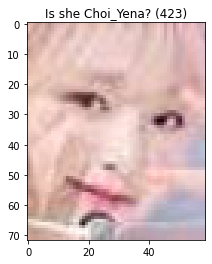

 <<< d : delete, a : pass, e : escape >>> 
a


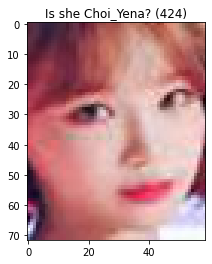

 <<< d : delete, a : pass, e : escape >>> 
d


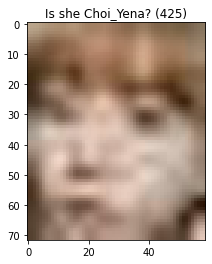

 <<< d : delete, a : pass, e : escape >>> 
d


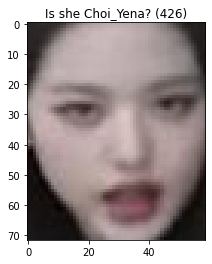

 <<< d : delete, a : pass, e : escape >>> 
d


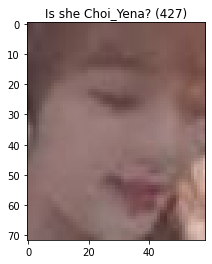

 <<< d : delete, a : pass, e : escape >>> 
d


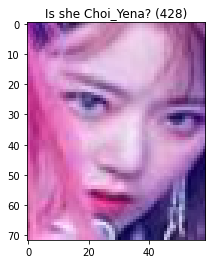

 <<< d : delete, a : pass, e : escape >>> 
d


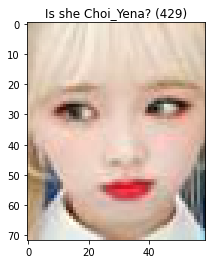

 <<< d : delete, a : pass, e : escape >>> 
a


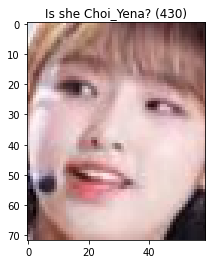

 <<< d : delete, a : pass, e : escape >>> 
a


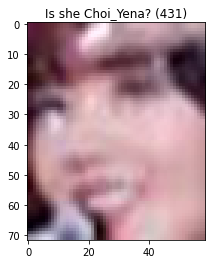

 <<< d : delete, a : pass, e : escape >>> 
d


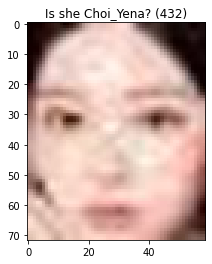

 <<< d : delete, a : pass, e : escape >>> 
d


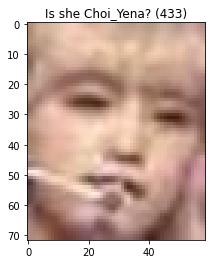

 <<< d : delete, a : pass, e : escape >>> 
a


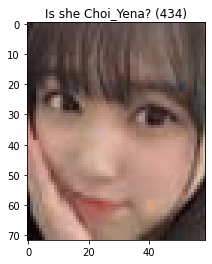

 <<< d : delete, a : pass, e : escape >>> 
d


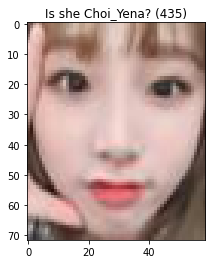

 <<< d : delete, a : pass, e : escape >>> 
a


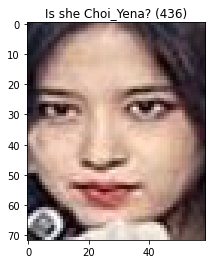

 <<< d : delete, a : pass, e : escape >>> 
d


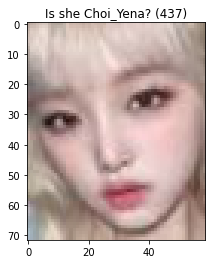

 <<< d : delete, a : pass, e : escape >>> 
a


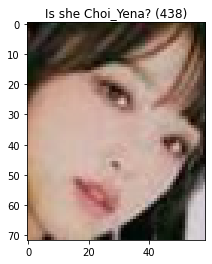

 <<< d : delete, a : pass, e : escape >>> 
a


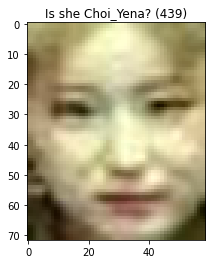

 <<< d : delete, a : pass, e : escape >>> 
d


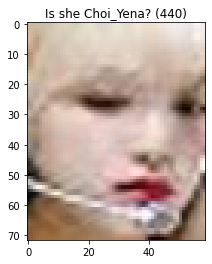

 <<< d : delete, a : pass, e : escape >>> 
a


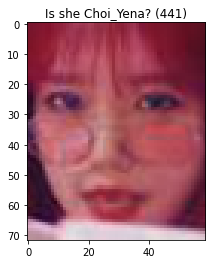

 <<< d : delete, a : pass, e : escape >>> 



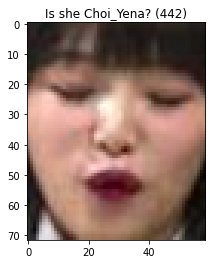

 <<< d : delete, a : pass, e : escape >>> 
a


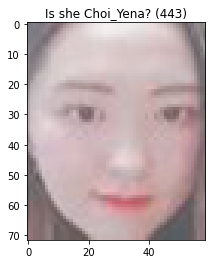

 <<< d : delete, a : pass, e : escape >>> 
d


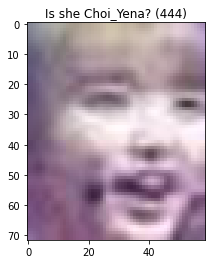

 <<< d : delete, a : pass, e : escape >>> 
d


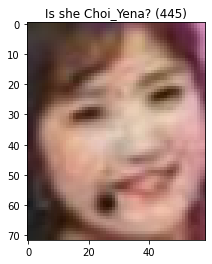

 <<< d : delete, a : pass, e : escape >>> 
d


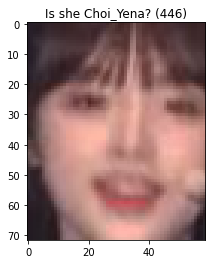

 <<< d : delete, a : pass, e : escape >>> 
d


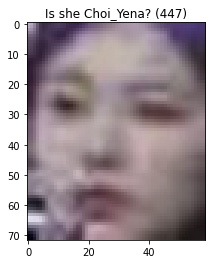

 <<< d : delete, a : pass, e : escape >>> 
d


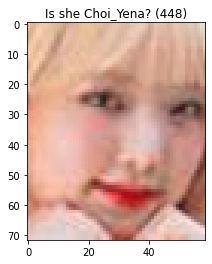

 <<< d : delete, a : pass, e : escape >>> 
a


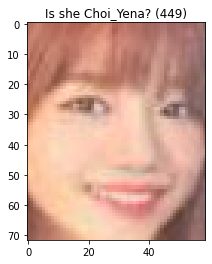

 <<< d : delete, a : pass, e : escape >>> 
a


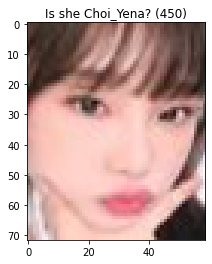

 <<< d : delete, a : pass, e : escape >>> 
d


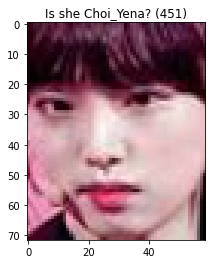

 <<< d : delete, a : pass, e : escape >>> 
a


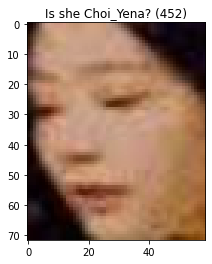

 <<< d : delete, a : pass, e : escape >>> 
d


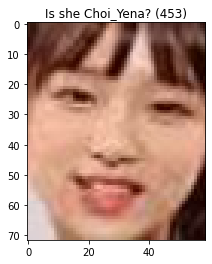

 <<< d : delete, a : pass, e : escape >>> 
a


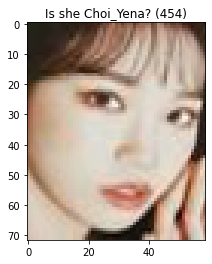

 <<< d : delete, a : pass, e : escape >>> 
d


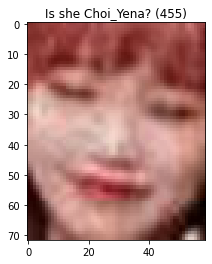

 <<< d : delete, a : pass, e : escape >>> 
d


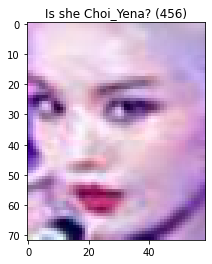

 <<< d : delete, a : pass, e : escape >>> 
d


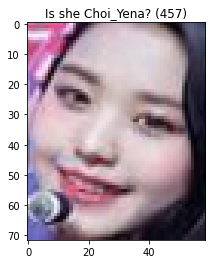

 <<< d : delete, a : pass, e : escape >>> 
d


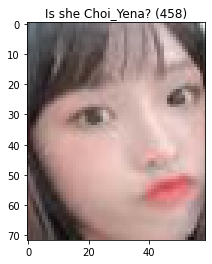

 <<< d : delete, a : pass, e : escape >>> 
a


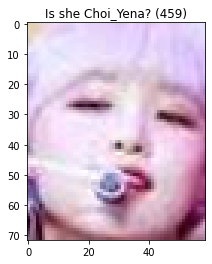

 <<< d : delete, a : pass, e : escape >>> 
a


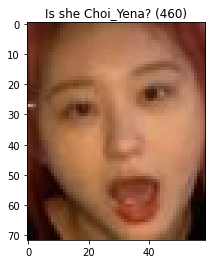

 <<< d : delete, a : pass, e : escape >>> 
d


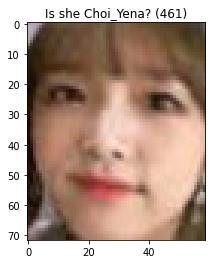

 <<< d : delete, a : pass, e : escape >>> 
a


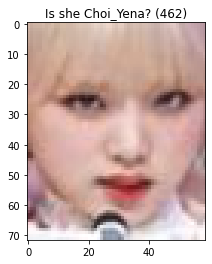

 <<< d : delete, a : pass, e : escape >>> 
a


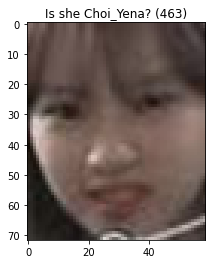

 <<< d : delete, a : pass, e : escape >>> 
d


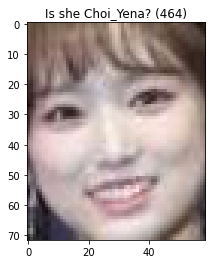

 <<< d : delete, a : pass, e : escape >>> 
d


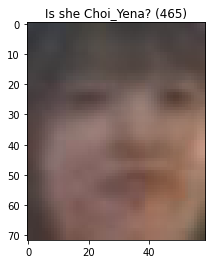

 <<< d : delete, a : pass, e : escape >>> 
d


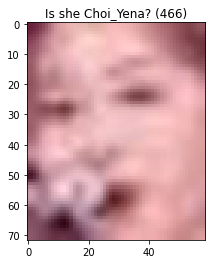

 <<< d : delete, a : pass, e : escape >>> 
d


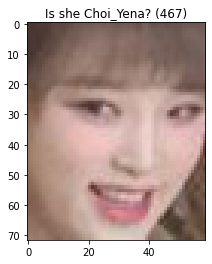

 <<< d : delete, a : pass, e : escape >>> 
a


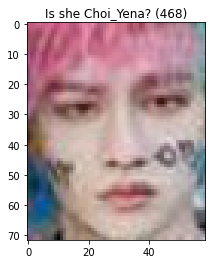

 <<< d : delete, a : pass, e : escape >>> 
d


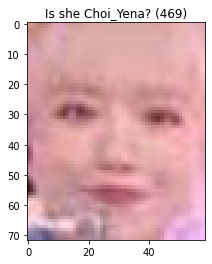

 <<< d : delete, a : pass, e : escape >>> 
d


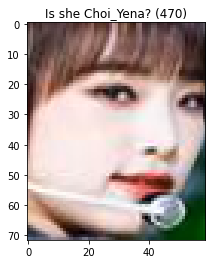

 <<< d : delete, a : pass, e : escape >>> 
a


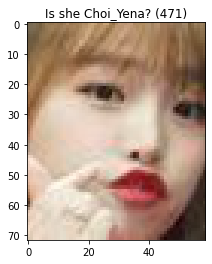

 <<< d : delete, a : pass, e : escape >>> 
a


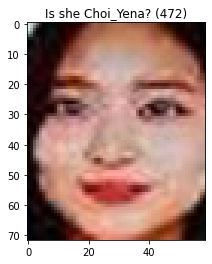

 <<< d : delete, a : pass, e : escape >>> 
d


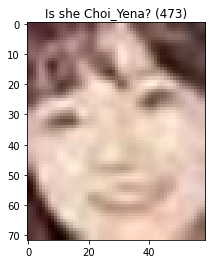

 <<< d : delete, a : pass, e : escape >>> 
d


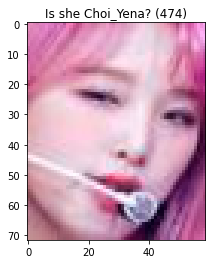

 <<< d : delete, a : pass, e : escape >>> 
a


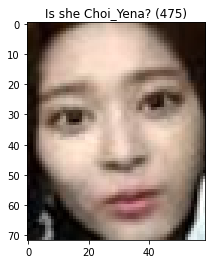

 <<< d : delete, a : pass, e : escape >>> 
d


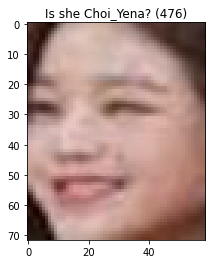

 <<< d : delete, a : pass, e : escape >>> 
d


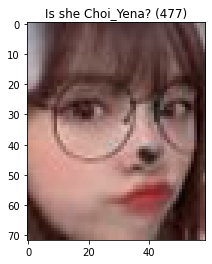

 <<< d : delete, a : pass, e : escape >>> 
a


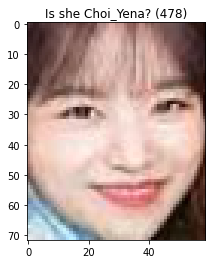

 <<< d : delete, a : pass, e : escape >>> 
d


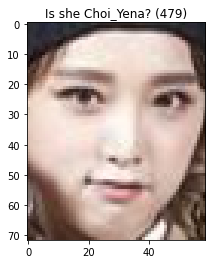

 <<< d : delete, a : pass, e : escape >>> 
a


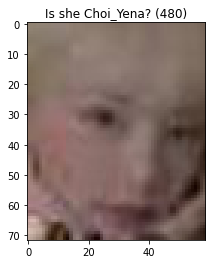

 <<< d : delete, a : pass, e : escape >>> 
d


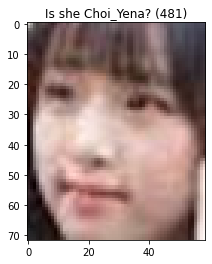

 <<< d : delete, a : pass, e : escape >>> 
a


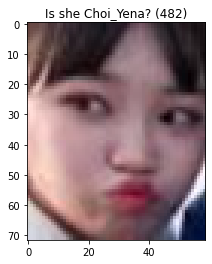

 <<< d : delete, a : pass, e : escape >>> 
d


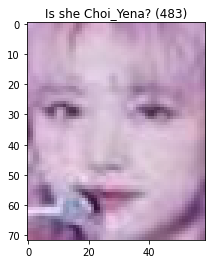

 <<< d : delete, a : pass, e : escape >>> 
a


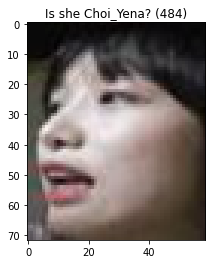

 <<< d : delete, a : pass, e : escape >>> 
d


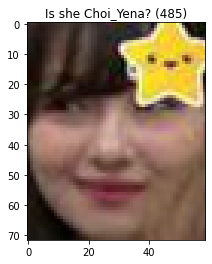

 <<< d : delete, a : pass, e : escape >>> 
d


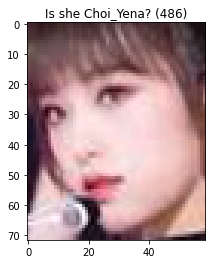

 <<< d : delete, a : pass, e : escape >>> 
a


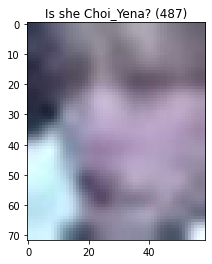

 <<< d : delete, a : pass, e : escape >>> 



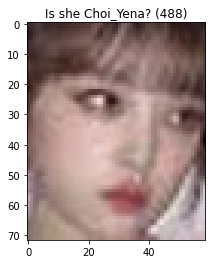

 <<< d : delete, a : pass, e : escape >>> 
a


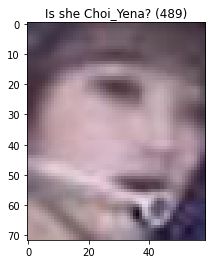

 <<< d : delete, a : pass, e : escape >>> 
d


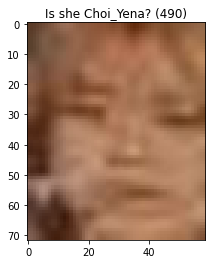

 <<< d : delete, a : pass, e : escape >>> 
d


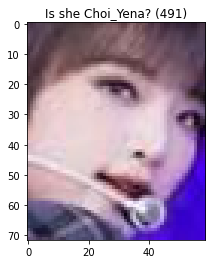

 <<< d : delete, a : pass, e : escape >>> 
a


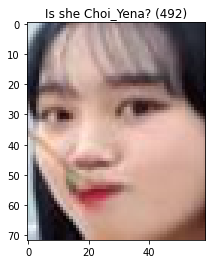

 <<< d : delete, a : pass, e : escape >>> 
d


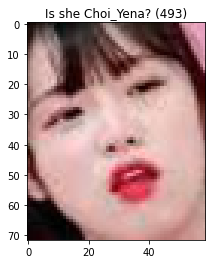

 <<< d : delete, a : pass, e : escape >>> 
a


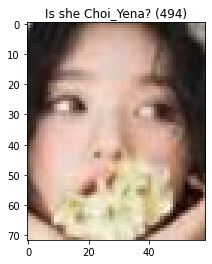

 <<< d : delete, a : pass, e : escape >>> 
d


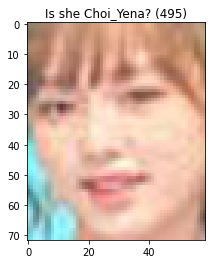

 <<< d : delete, a : pass, e : escape >>> 
a


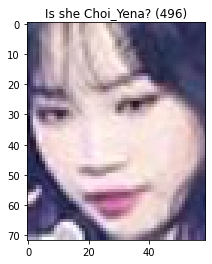

 <<< d : delete, a : pass, e : escape >>> 



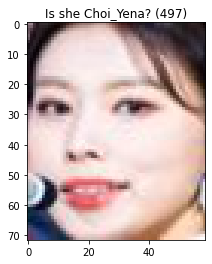

 <<< d : delete, a : pass, e : escape >>> 
d


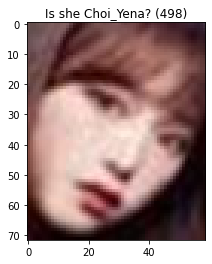

 <<< d : delete, a : pass, e : escape >>> 
d


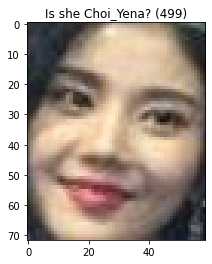

 <<< d : delete, a : pass, e : escape >>> 
d


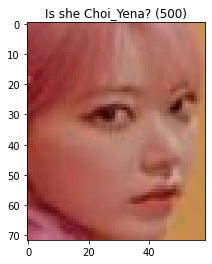

 <<< d : delete, a : pass, e : escape >>> 
d


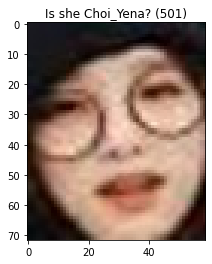

 <<< d : delete, a : pass, e : escape >>> 
a


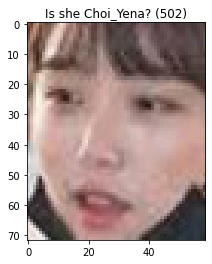

 <<< d : delete, a : pass, e : escape >>> 
d


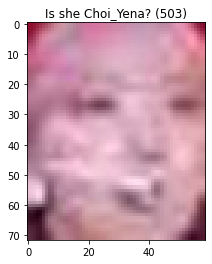

 <<< d : delete, a : pass, e : escape >>> 
d


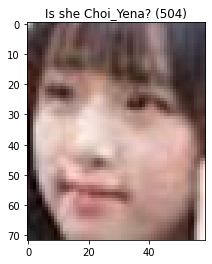

 <<< d : delete, a : pass, e : escape >>> 
d


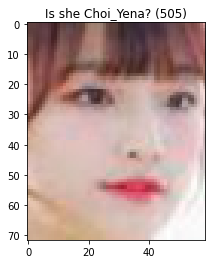

 <<< d : delete, a : pass, e : escape >>> 
d


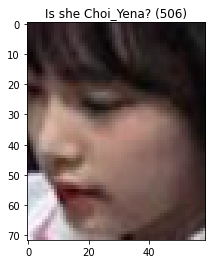

 <<< d : delete, a : pass, e : escape >>> 
a


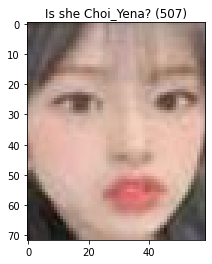

 <<< d : delete, a : pass, e : escape >>> 
d


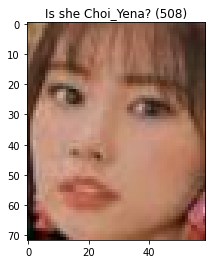

 <<< d : delete, a : pass, e : escape >>> 
d


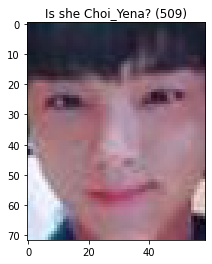

 <<< d : delete, a : pass, e : escape >>> 
d


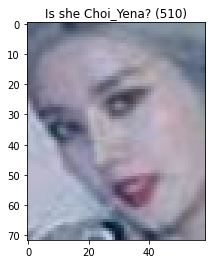

 <<< d : delete, a : pass, e : escape >>> 
d


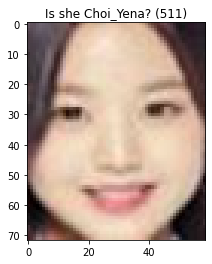

 <<< d : delete, a : pass, e : escape >>> 
d


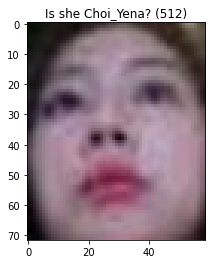

 <<< d : delete, a : pass, e : escape >>> 
d


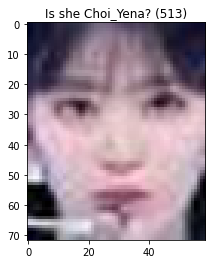

 <<< d : delete, a : pass, e : escape >>> 
d


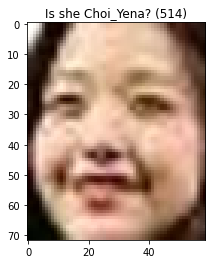

 <<< d : delete, a : pass, e : escape >>> 
d


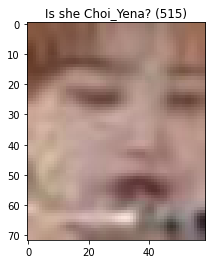

 <<< d : delete, a : pass, e : escape >>> 
d


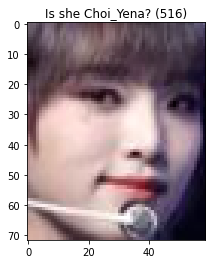

 <<< d : delete, a : pass, e : escape >>> 
a


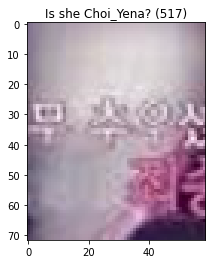

 <<< d : delete, a : pass, e : escape >>> 
d


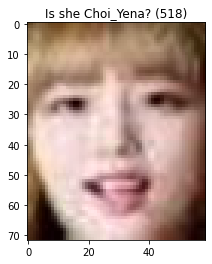

 <<< d : delete, a : pass, e : escape >>> 
a


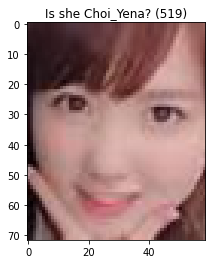

 <<< d : delete, a : pass, e : escape >>> 
d


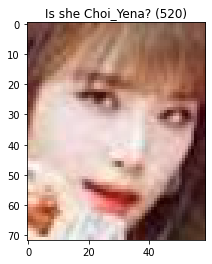

 <<< d : delete, a : pass, e : escape >>> 
a


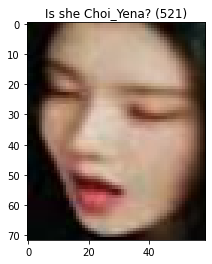

 <<< d : delete, a : pass, e : escape >>> 
d


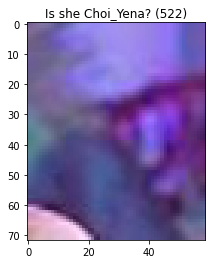

 <<< d : delete, a : pass, e : escape >>> 
d


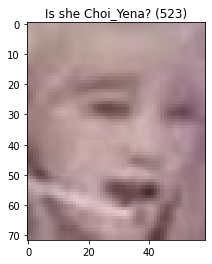

 <<< d : delete, a : pass, e : escape >>> 
d


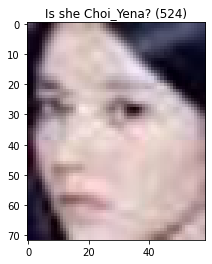

 <<< d : delete, a : pass, e : escape >>> 
d


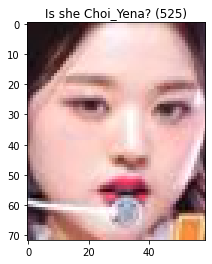

 <<< d : delete, a : pass, e : escape >>> 
d


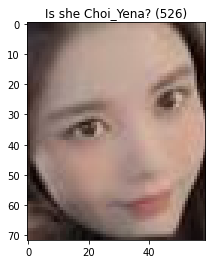

 <<< d : delete, a : pass, e : escape >>> 
d


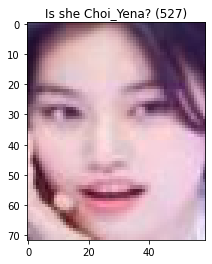

 <<< d : delete, a : pass, e : escape >>> 
d


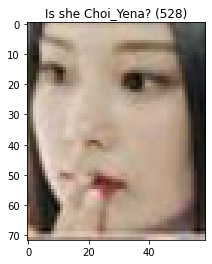

 <<< d : delete, a : pass, e : escape >>> 
d


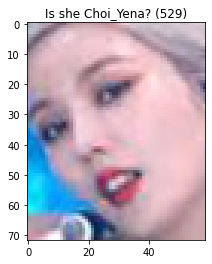

 <<< d : delete, a : pass, e : escape >>> 
d


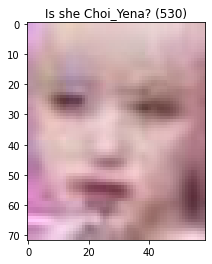

 <<< d : delete, a : pass, e : escape >>> 
d


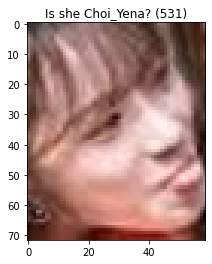

 <<< d : delete, a : pass, e : escape >>> 
d


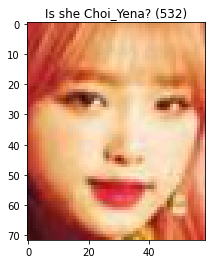

 <<< d : delete, a : pass, e : escape >>> 
a


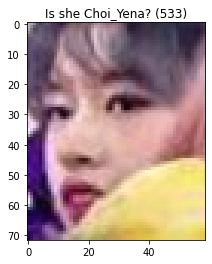

 <<< d : delete, a : pass, e : escape >>> 
d


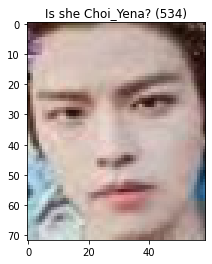

 <<< d : delete, a : pass, e : escape >>> 
d


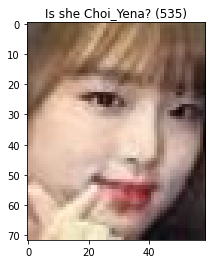

 <<< d : delete, a : pass, e : escape >>> 
a


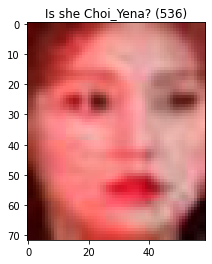

 <<< d : delete, a : pass, e : escape >>> 
d


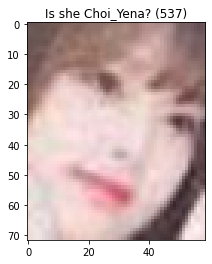

 <<< d : delete, a : pass, e : escape >>> 
a


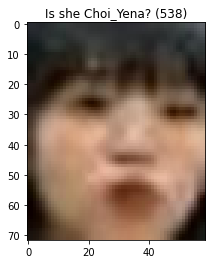

 <<< d : delete, a : pass, e : escape >>> 
d


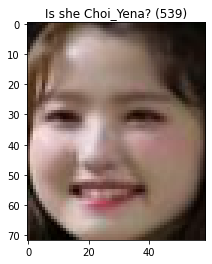

 <<< d : delete, a : pass, e : escape >>> 
d


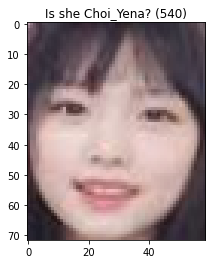

 <<< d : delete, a : pass, e : escape >>> 
a


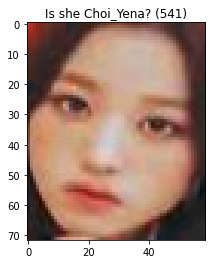

 <<< d : delete, a : pass, e : escape >>> 
d


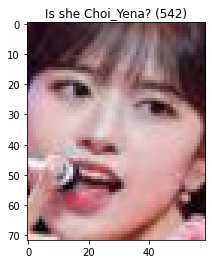

 <<< d : delete, a : pass, e : escape >>> 
d


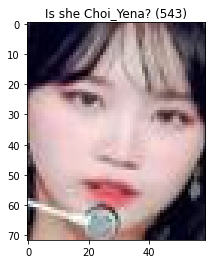

 <<< d : delete, a : pass, e : escape >>> 
d


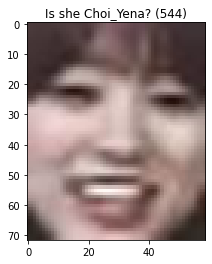

 <<< d : delete, a : pass, e : escape >>> 
d


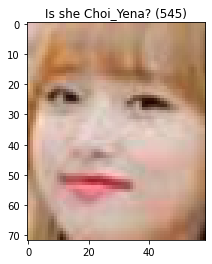

 <<< d : delete, a : pass, e : escape >>> 
a


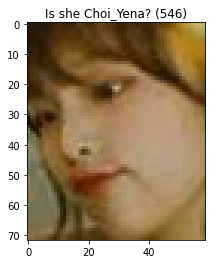

 <<< d : delete, a : pass, e : escape >>> 
a


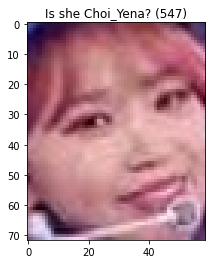

 <<< d : delete, a : pass, e : escape >>> 
d


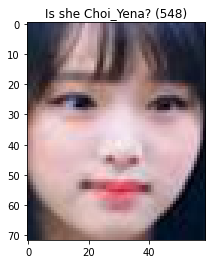

 <<< d : delete, a : pass, e : escape >>> 
a


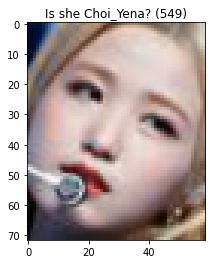

 <<< d : delete, a : pass, e : escape >>> 
d


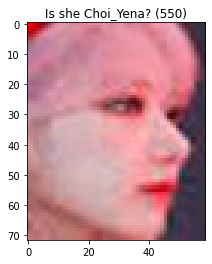

 <<< d : delete, a : pass, e : escape >>> 
d


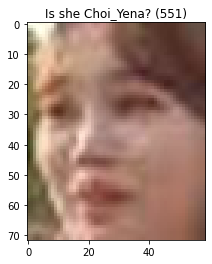

 <<< d : delete, a : pass, e : escape >>> 
d


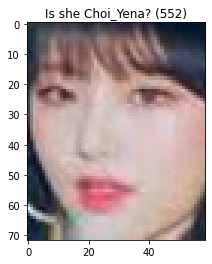

 <<< d : delete, a : pass, e : escape >>> 
a


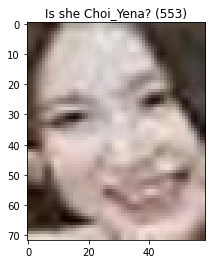

 <<< d : delete, a : pass, e : escape >>> 
d


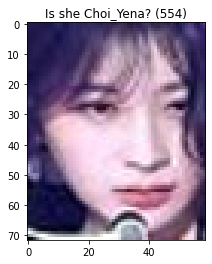

 <<< d : delete, a : pass, e : escape >>> 
d


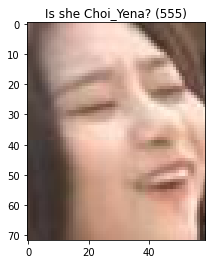

 <<< d : delete, a : pass, e : escape >>> 
d


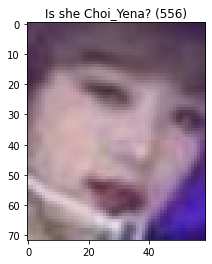

 <<< d : delete, a : pass, e : escape >>> 
d


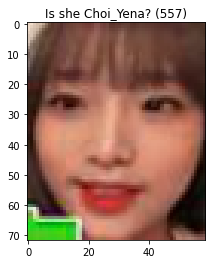

 <<< d : delete, a : pass, e : escape >>> 
a


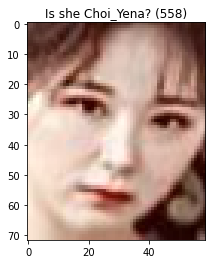

 <<< d : delete, a : pass, e : escape >>> 
d


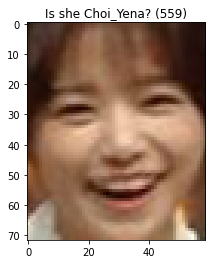

 <<< d : delete, a : pass, e : escape >>> 
d


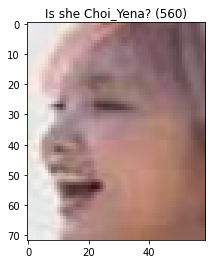

 <<< d : delete, a : pass, e : escape >>> 
a


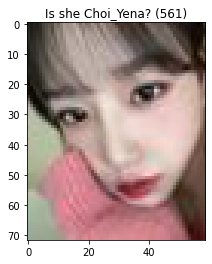

 <<< d : delete, a : pass, e : escape >>> 
a


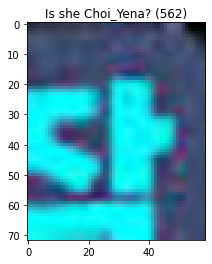

 <<< d : delete, a : pass, e : escape >>> 
d


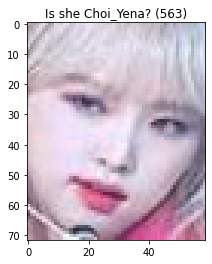

 <<< d : delete, a : pass, e : escape >>> 
a


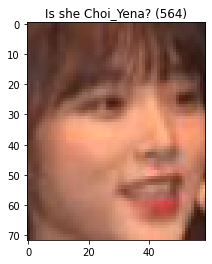

 <<< d : delete, a : pass, e : escape >>> 
a


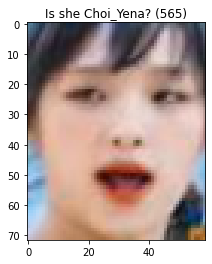

 <<< d : delete, a : pass, e : escape >>> 
a


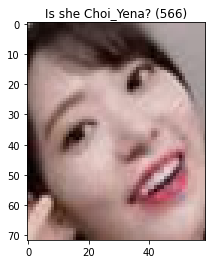

 <<< d : delete, a : pass, e : escape >>> 
d


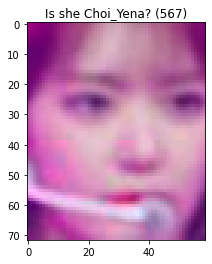

 <<< d : delete, a : pass, e : escape >>> 
d


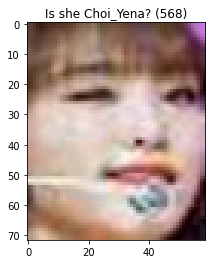

 <<< d : delete, a : pass, e : escape >>> 
a


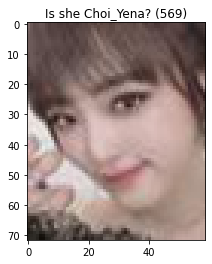

 <<< d : delete, a : pass, e : escape >>> 
a


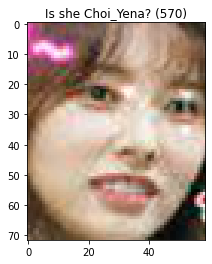

 <<< d : delete, a : pass, e : escape >>> 
d


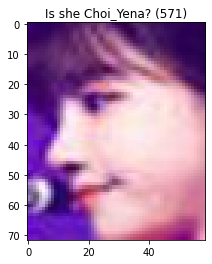

 <<< d : delete, a : pass, e : escape >>> 
d


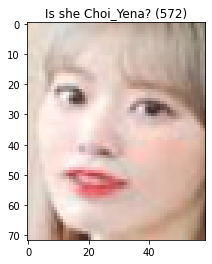

 <<< d : delete, a : pass, e : escape >>> 
d


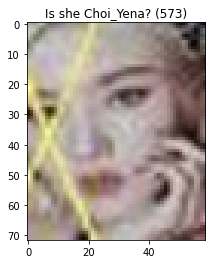

 <<< d : delete, a : pass, e : escape >>> 
d


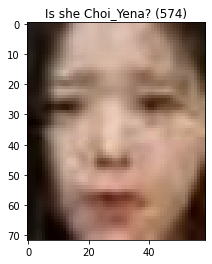

 <<< d : delete, a : pass, e : escape >>> 
d


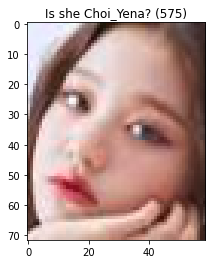

 <<< d : delete, a : pass, e : escape >>> 
d


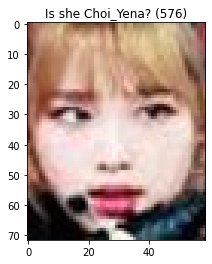

 <<< d : delete, a : pass, e : escape >>> 
a


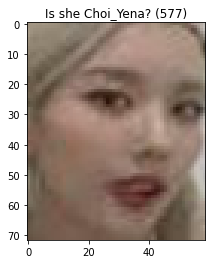

 <<< d : delete, a : pass, e : escape >>> 
d


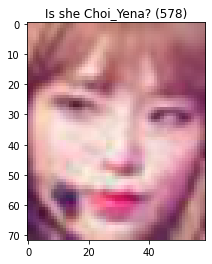

 <<< d : delete, a : pass, e : escape >>> 
a


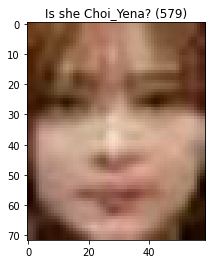

 <<< d : delete, a : pass, e : escape >>> 
d


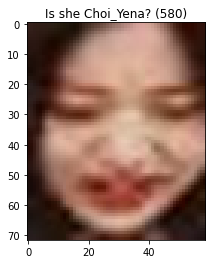

 <<< d : delete, a : pass, e : escape >>> 



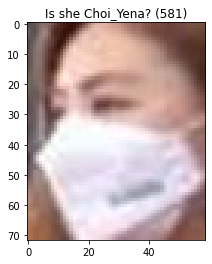

 <<< d : delete, a : pass, e : escape >>> 
d


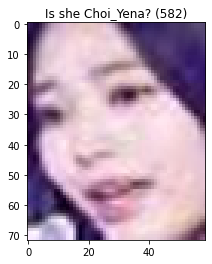

 <<< d : delete, a : pass, e : escape >>> 
d


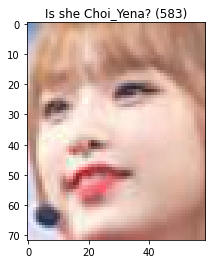

 <<< d : delete, a : pass, e : escape >>> 
a


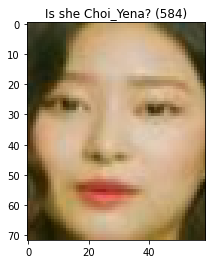

 <<< d : delete, a : pass, e : escape >>> 
d


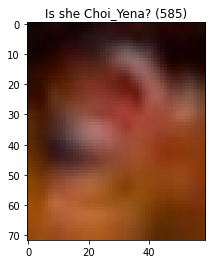

 <<< d : delete, a : pass, e : escape >>> 
d


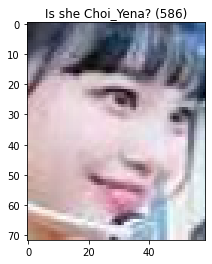

 <<< d : delete, a : pass, e : escape >>> 
d


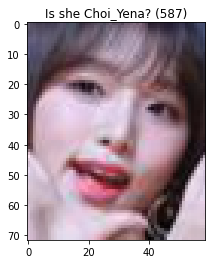

 <<< d : delete, a : pass, e : escape >>> 
a


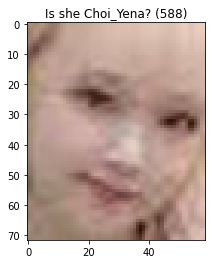

 <<< d : delete, a : pass, e : escape >>> 
d


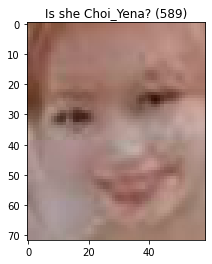

 <<< d : delete, a : pass, e : escape >>> 
d


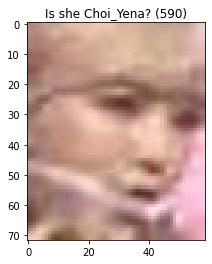

 <<< d : delete, a : pass, e : escape >>> 
d


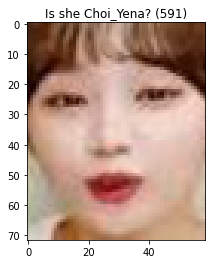

 <<< d : delete, a : pass, e : escape >>> 
d


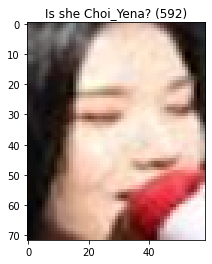

 <<< d : delete, a : pass, e : escape >>> 
d


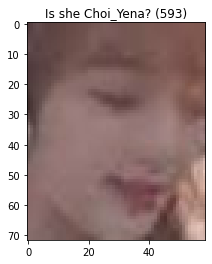

 <<< d : delete, a : pass, e : escape >>> 
a


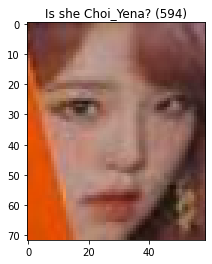

 <<< d : delete, a : pass, e : escape >>> 
a


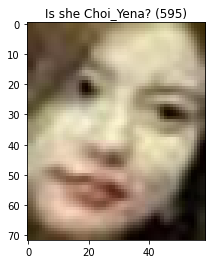

 <<< d : delete, a : pass, e : escape >>> 
d


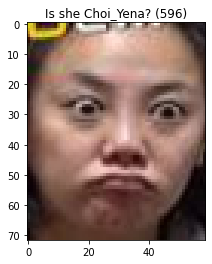

 <<< d : delete, a : pass, e : escape >>> 
d


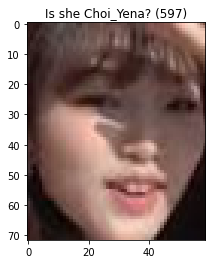

 <<< d : delete, a : pass, e : escape >>> 
a


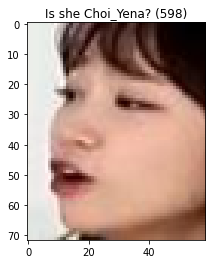

 <<< d : delete, a : pass, e : escape >>> 
d


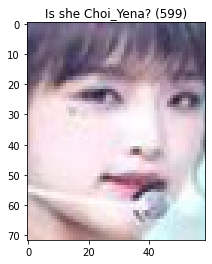

 <<< d : delete, a : pass, e : escape >>> 
a


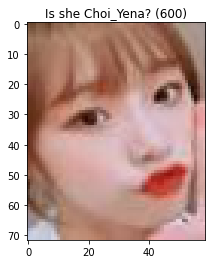

 <<< d : delete, a : pass, e : escape >>> 
a


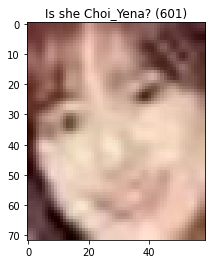

 <<< d : delete, a : pass, e : escape >>> 
d


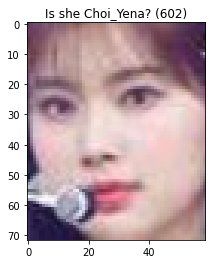

 <<< d : delete, a : pass, e : escape >>> 
d


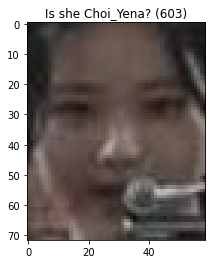

 <<< d : delete, a : pass, e : escape >>> 
d


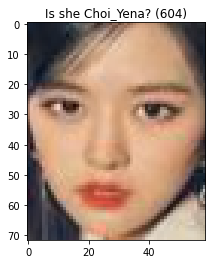

 <<< d : delete, a : pass, e : escape >>> 
d


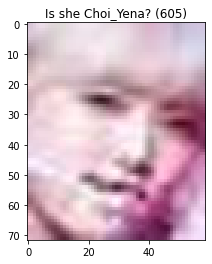

 <<< d : delete, a : pass, e : escape >>> 
d


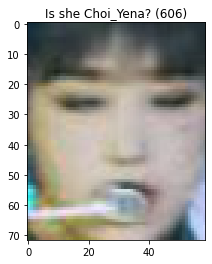

 <<< d : delete, a : pass, e : escape >>> 
d


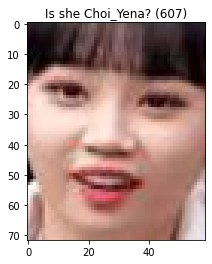

 <<< d : delete, a : pass, e : escape >>> 
d


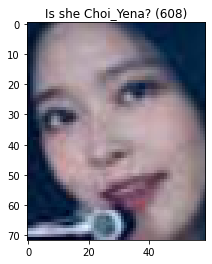

 <<< d : delete, a : pass, e : escape >>> 
d


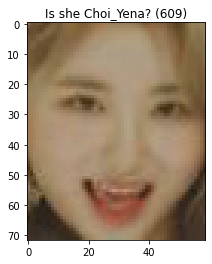

 <<< d : delete, a : pass, e : escape >>> 
d


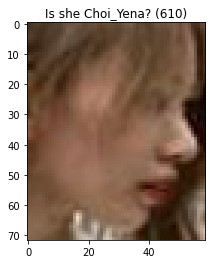

 <<< d : delete, a : pass, e : escape >>> 
d


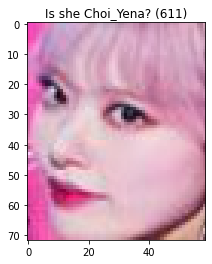

 <<< d : delete, a : pass, e : escape >>> 
d


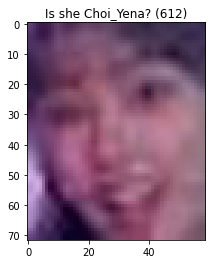

 <<< d : delete, a : pass, e : escape >>> 
d


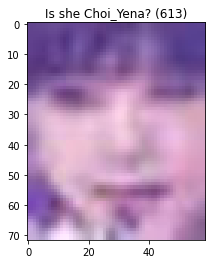

 <<< d : delete, a : pass, e : escape >>> 
d


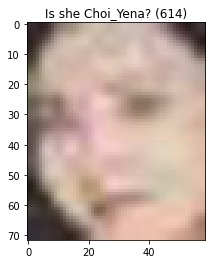

 <<< d : delete, a : pass, e : escape >>> 
d


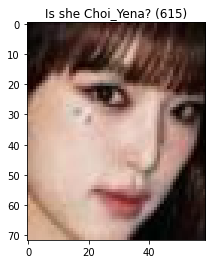

 <<< d : delete, a : pass, e : escape >>> 
a


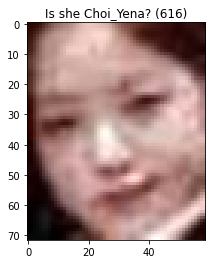

 <<< d : delete, a : pass, e : escape >>> 
d


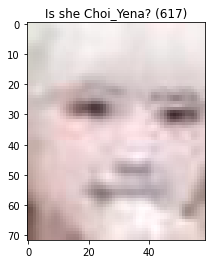

 <<< d : delete, a : pass, e : escape >>> 
d


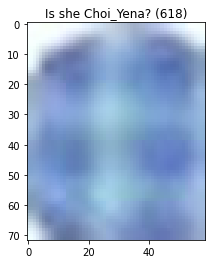

 <<< d : delete, a : pass, e : escape >>> 
d


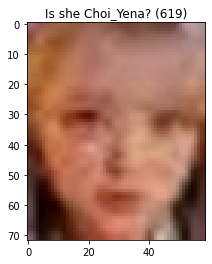

 <<< d : delete, a : pass, e : escape >>> 
d


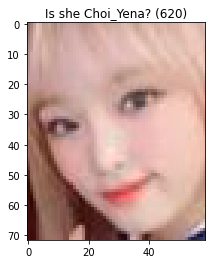

 <<< d : delete, a : pass, e : escape >>> 
a


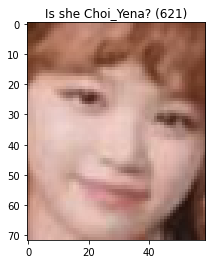

 <<< d : delete, a : pass, e : escape >>> 
d


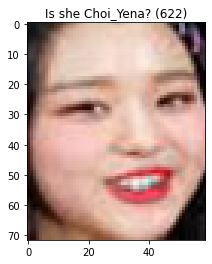

 <<< d : delete, a : pass, e : escape >>> 
d


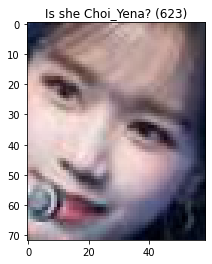

 <<< d : delete, a : pass, e : escape >>> 
d


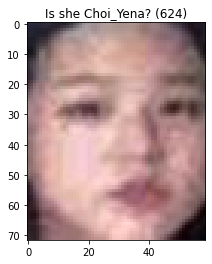

 <<< d : delete, a : pass, e : escape >>> 
d


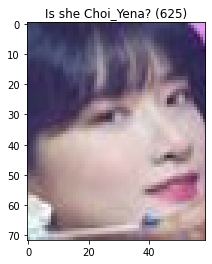

 <<< d : delete, a : pass, e : escape >>> 
d


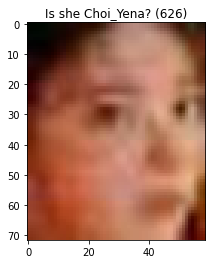

 <<< d : delete, a : pass, e : escape >>> 



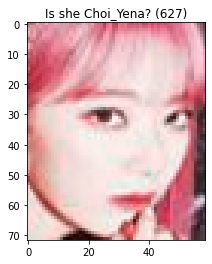

 <<< d : delete, a : pass, e : escape >>> 
d


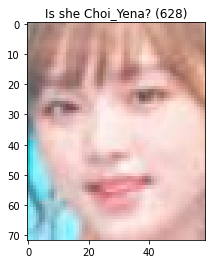

 <<< d : delete, a : pass, e : escape >>> 
a


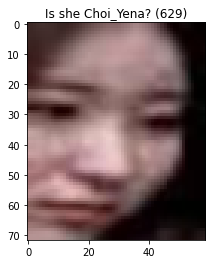

 <<< d : delete, a : pass, e : escape >>> 
d


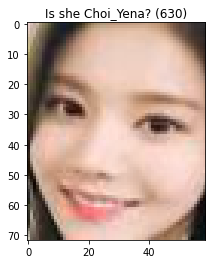

 <<< d : delete, a : pass, e : escape >>> 
d


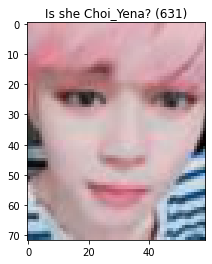

 <<< d : delete, a : pass, e : escape >>> 
d


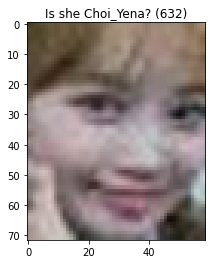

 <<< d : delete, a : pass, e : escape >>> 
d


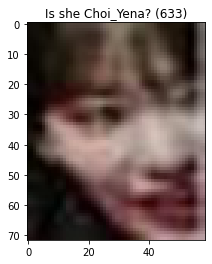

 <<< d : delete, a : pass, e : escape >>> 
d


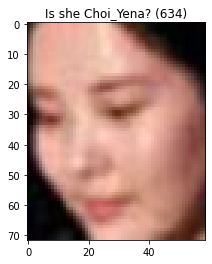

 <<< d : delete, a : pass, e : escape >>> 
d


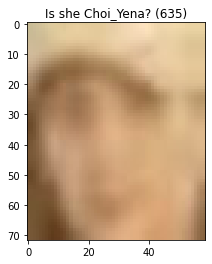

 <<< d : delete, a : pass, e : escape >>> 
d


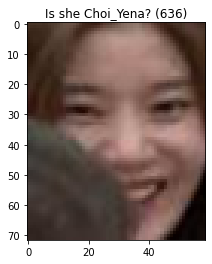

 <<< d : delete, a : pass, e : escape >>> 
d


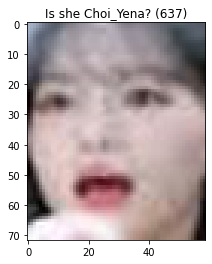

 <<< d : delete, a : pass, e : escape >>> 
d


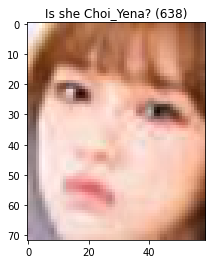

 <<< d : delete, a : pass, e : escape >>> 
a


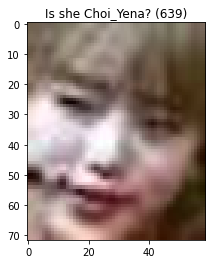

 <<< d : delete, a : pass, e : escape >>> 
d


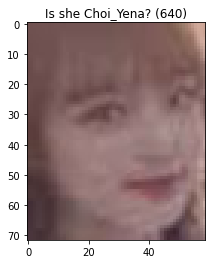

 <<< d : delete, a : pass, e : escape >>> 
d


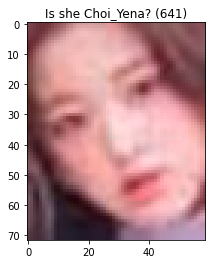

 <<< d : delete, a : pass, e : escape >>> 
d


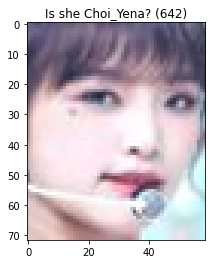

 <<< d : delete, a : pass, e : escape >>> 
a


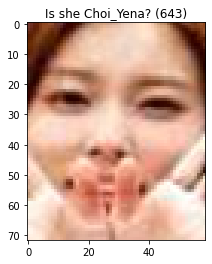

 <<< d : delete, a : pass, e : escape >>> 
d


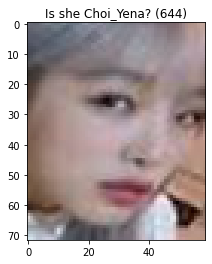

 <<< d : delete, a : pass, e : escape >>> 
d


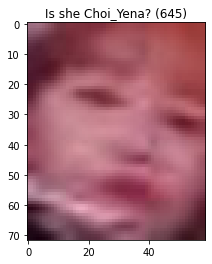

 <<< d : delete, a : pass, e : escape >>> 
d


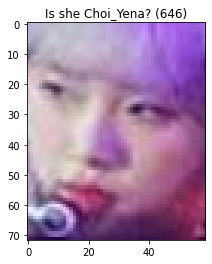

 <<< d : delete, a : pass, e : escape >>> 
d


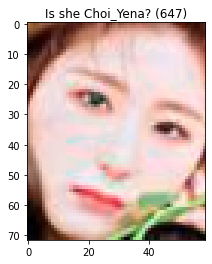

 <<< d : delete, a : pass, e : escape >>> 
d


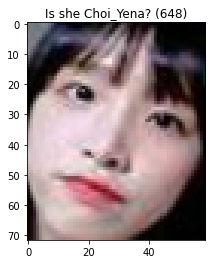

 <<< d : delete, a : pass, e : escape >>> 
a


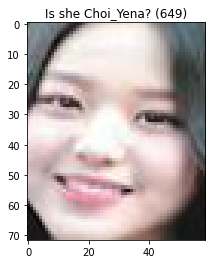

 <<< d : delete, a : pass, e : escape >>> 
d


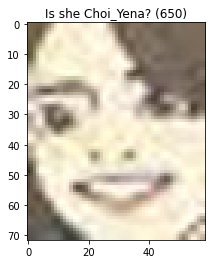

 <<< d : delete, a : pass, e : escape >>> 
d


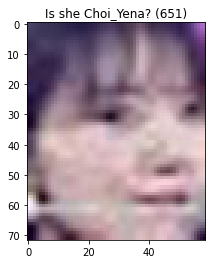

 <<< d : delete, a : pass, e : escape >>> 
d


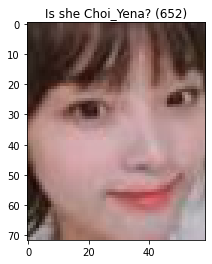

 <<< d : delete, a : pass, e : escape >>> 
a


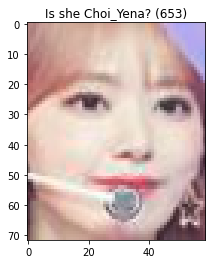

 <<< d : delete, a : pass, e : escape >>> 
d


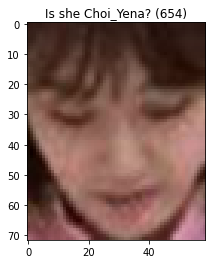

 <<< d : delete, a : pass, e : escape >>> 
d


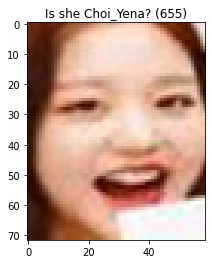

 <<< d : delete, a : pass, e : escape >>> 
d


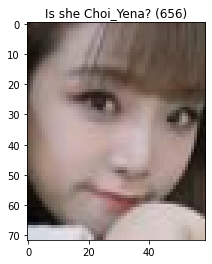

 <<< d : delete, a : pass, e : escape >>> 
a


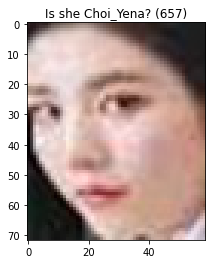

 <<< d : delete, a : pass, e : escape >>> 
d


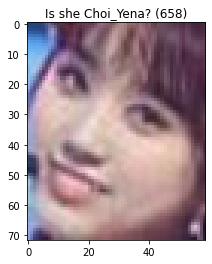

 <<< d : delete, a : pass, e : escape >>> 
d


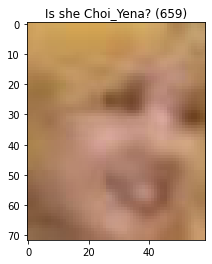

 <<< d : delete, a : pass, e : escape >>> 
d


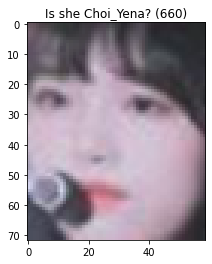

 <<< d : delete, a : pass, e : escape >>> 
a


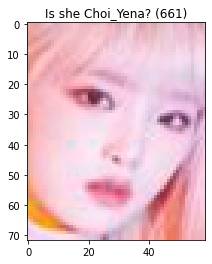

 <<< d : delete, a : pass, e : escape >>> 
a


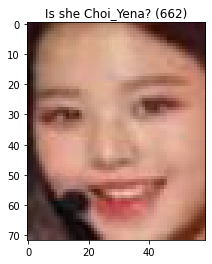

 <<< d : delete, a : pass, e : escape >>> 
d


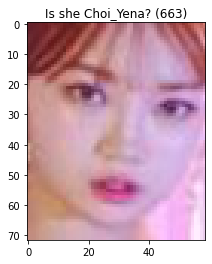

 <<< d : delete, a : pass, e : escape >>> 
d


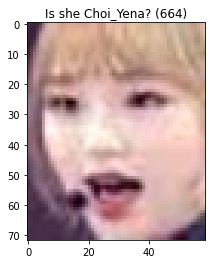

 <<< d : delete, a : pass, e : escape >>> 
d


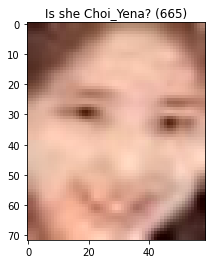

 <<< d : delete, a : pass, e : escape >>> 
d


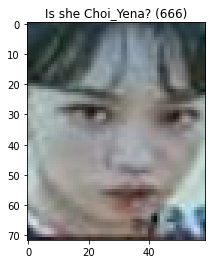

 <<< d : delete, a : pass, e : escape >>> 
d


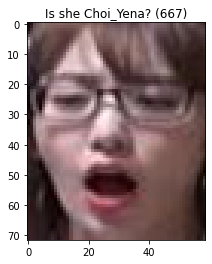

 <<< d : delete, a : pass, e : escape >>> 
d


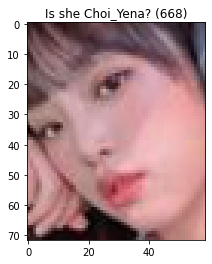

 <<< d : delete, a : pass, e : escape >>> 
a


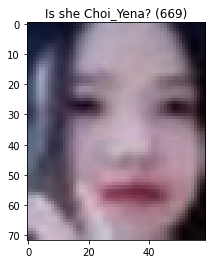

 <<< d : delete, a : pass, e : escape >>> 
d


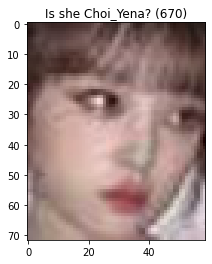

 <<< d : delete, a : pass, e : escape >>> 
a


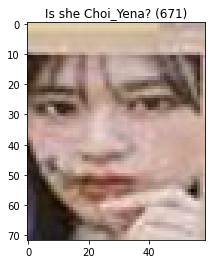

 <<< d : delete, a : pass, e : escape >>> 
d


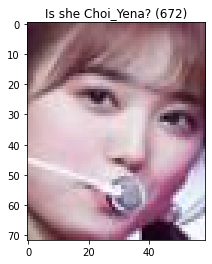

 <<< d : delete, a : pass, e : escape >>> 
d


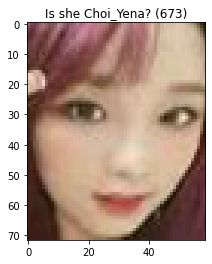

 <<< d : delete, a : pass, e : escape >>> 
a


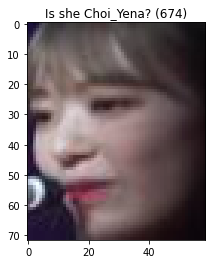

 <<< d : delete, a : pass, e : escape >>> 
d


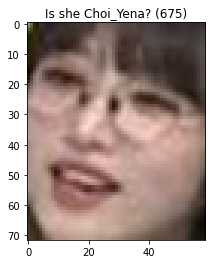

 <<< d : delete, a : pass, e : escape >>> 
a


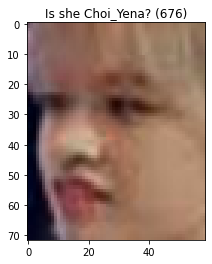

 <<< d : delete, a : pass, e : escape >>> 
d


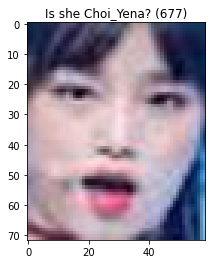

 <<< d : delete, a : pass, e : escape >>> 
a


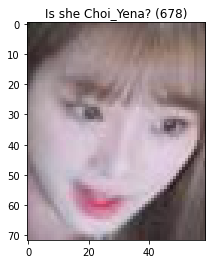

 <<< d : delete, a : pass, e : escape >>> 
a


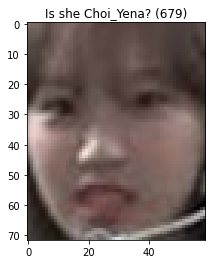

 <<< d : delete, a : pass, e : escape >>> 
d


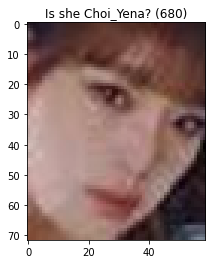

 <<< d : delete, a : pass, e : escape >>> 
a


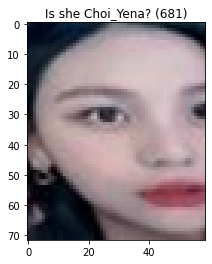

 <<< d : delete, a : pass, e : escape >>> 
d


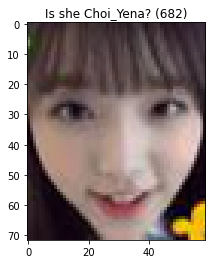

 <<< d : delete, a : pass, e : escape >>> 
aa


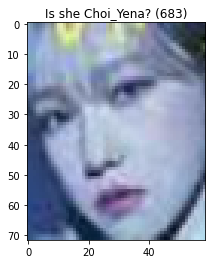

 <<< d : delete, a : pass, e : escape >>> 
d


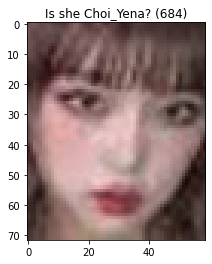

 <<< d : delete, a : pass, e : escape >>> 



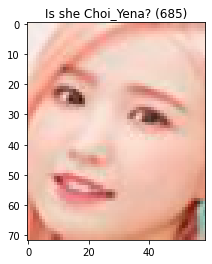

 <<< d : delete, a : pass, e : escape >>> 
d


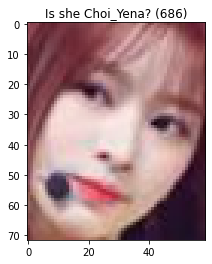

 <<< d : delete, a : pass, e : escape >>> 
d


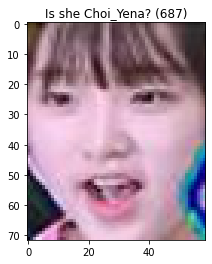

 <<< d : delete, a : pass, e : escape >>> 
a


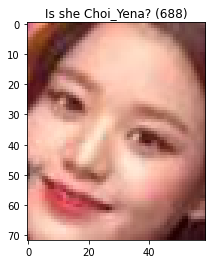

 <<< d : delete, a : pass, e : escape >>> 
d


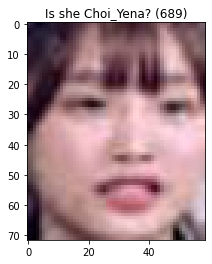

 <<< d : delete, a : pass, e : escape >>> 
d


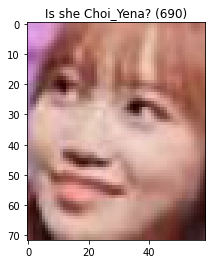

 <<< d : delete, a : pass, e : escape >>> 
d


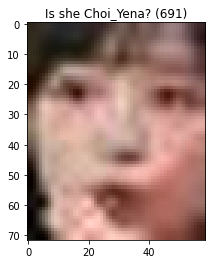

 <<< d : delete, a : pass, e : escape >>> 
d


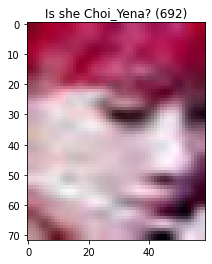

 <<< d : delete, a : pass, e : escape >>> 
d


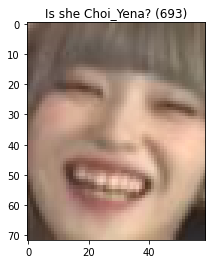

 <<< d : delete, a : pass, e : escape >>> 
d


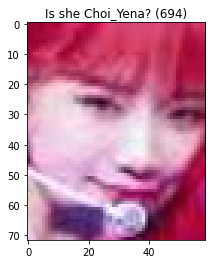

 <<< d : delete, a : pass, e : escape >>> 
d


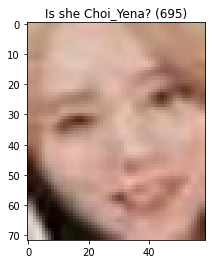

 <<< d : delete, a : pass, e : escape >>> 
d


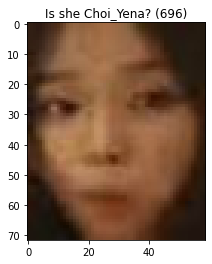

 <<< d : delete, a : pass, e : escape >>> 
d


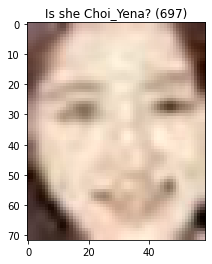

 <<< d : delete, a : pass, e : escape >>> 
d


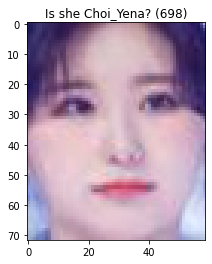

 <<< d : delete, a : pass, e : escape >>> 
d


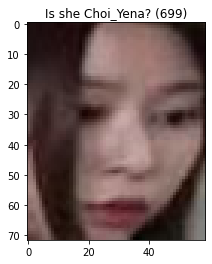

 <<< d : delete, a : pass, e : escape >>> 
d


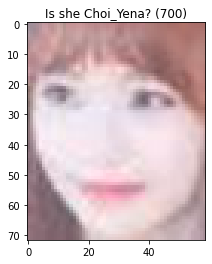

 <<< d : delete, a : pass, e : escape >>> 
d


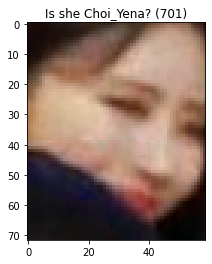

 <<< d : delete, a : pass, e : escape >>> 
d


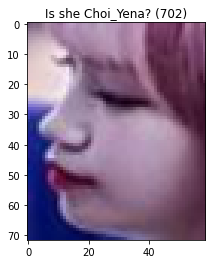

 <<< d : delete, a : pass, e : escape >>> 
d


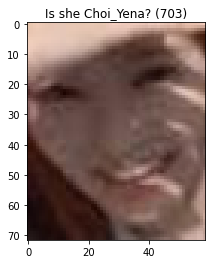

 <<< d : delete, a : pass, e : escape >>> 
d


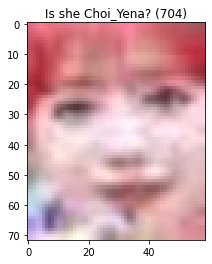

 <<< d : delete, a : pass, e : escape >>> 
d


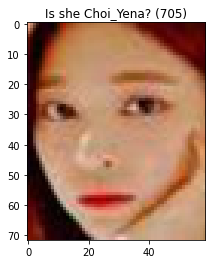

 <<< d : delete, a : pass, e : escape >>> 
d


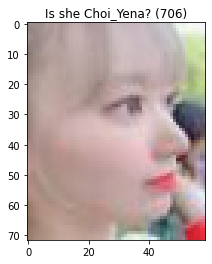

 <<< d : delete, a : pass, e : escape >>> 
d


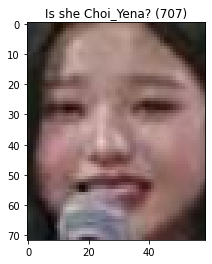

 <<< d : delete, a : pass, e : escape >>> 
d


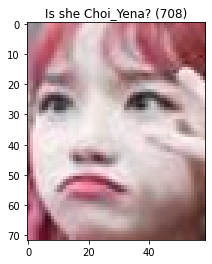

 <<< d : delete, a : pass, e : escape >>> 
d


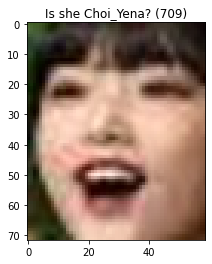

 <<< d : delete, a : pass, e : escape >>> 
d


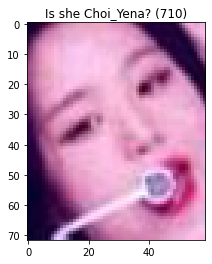

 <<< d : delete, a : pass, e : escape >>> 
d


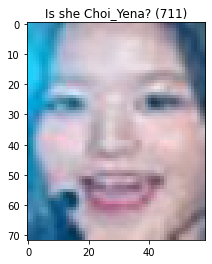

 <<< d : delete, a : pass, e : escape >>> 
d


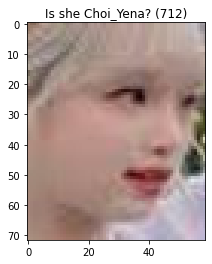

 <<< d : delete, a : pass, e : escape >>> 
a


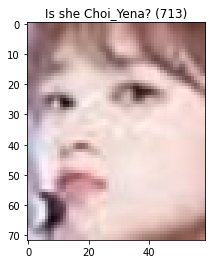

 <<< d : delete, a : pass, e : escape >>> 
d


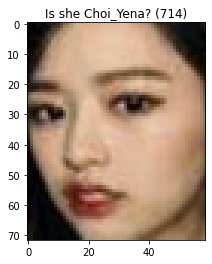

 <<< d : delete, a : pass, e : escape >>> 
d


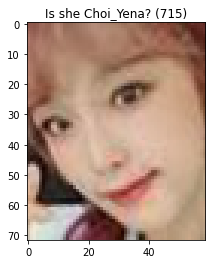

 <<< d : delete, a : pass, e : escape >>> 
a


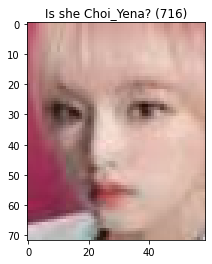

 <<< d : delete, a : pass, e : escape >>> 
a


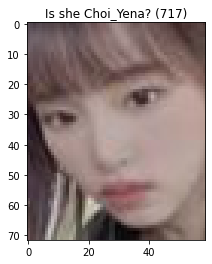

 <<< d : delete, a : pass, e : escape >>> 
a


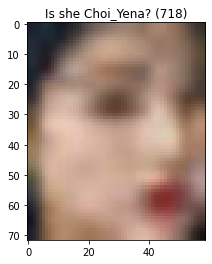

 <<< d : delete, a : pass, e : escape >>> 
d


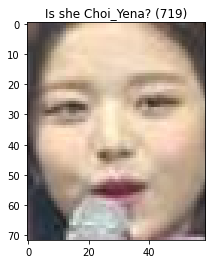

 <<< d : delete, a : pass, e : escape >>> 



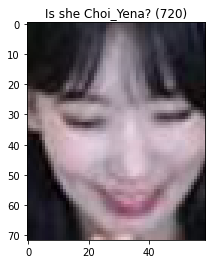

 <<< d : delete, a : pass, e : escape >>> 
d


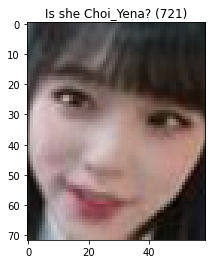

 <<< d : delete, a : pass, e : escape >>> 
a


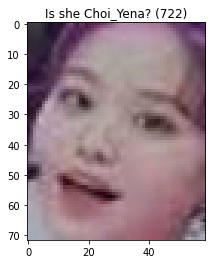

 <<< d : delete, a : pass, e : escape >>> 
d


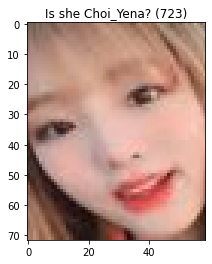

 <<< d : delete, a : pass, e : escape >>> 
a


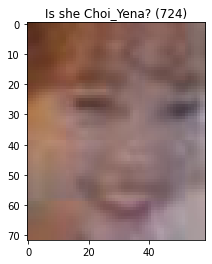

 <<< d : delete, a : pass, e : escape >>> 
d


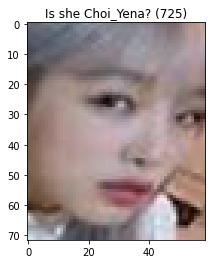

 <<< d : delete, a : pass, e : escape >>> 
d


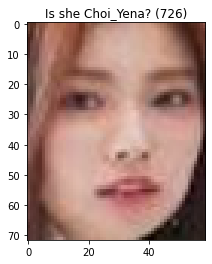

 <<< d : delete, a : pass, e : escape >>> 
d


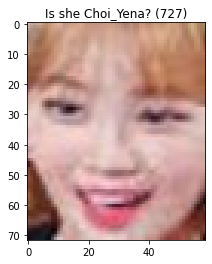

 <<< d : delete, a : pass, e : escape >>> 
d


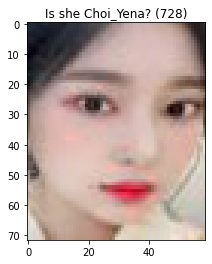

 <<< d : delete, a : pass, e : escape >>> 
d


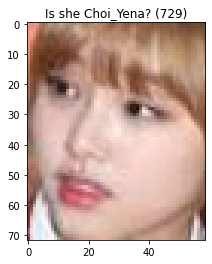

 <<< d : delete, a : pass, e : escape >>> 
a


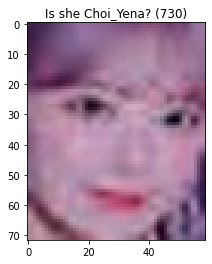

 <<< d : delete, a : pass, e : escape >>> 
d


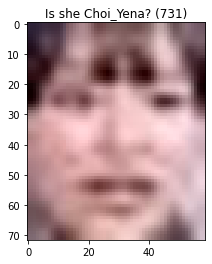

 <<< d : delete, a : pass, e : escape >>> 
d


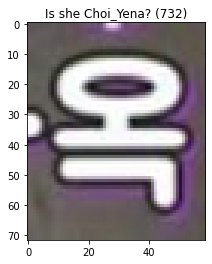

 <<< d : delete, a : pass, e : escape >>> 
d


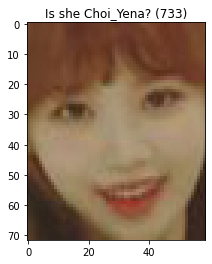

 <<< d : delete, a : pass, e : escape >>> 
d


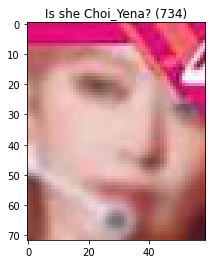

 <<< d : delete, a : pass, e : escape >>> 
d


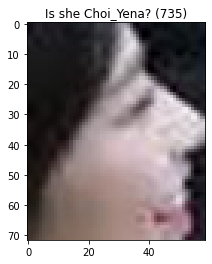

 <<< d : delete, a : pass, e : escape >>> 
d


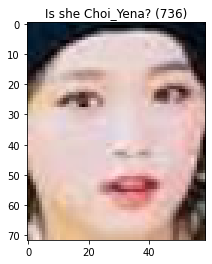

 <<< d : delete, a : pass, e : escape >>> 
d


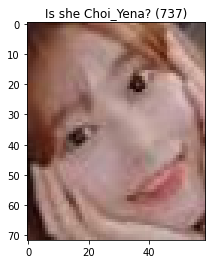

 <<< d : delete, a : pass, e : escape >>> 
d


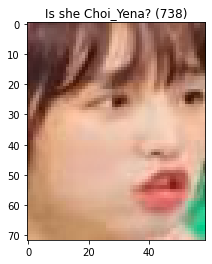

 <<< d : delete, a : pass, e : escape >>> 
a


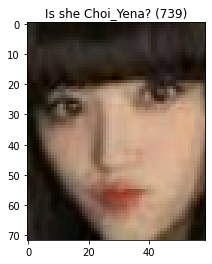

 <<< d : delete, a : pass, e : escape >>> 
d


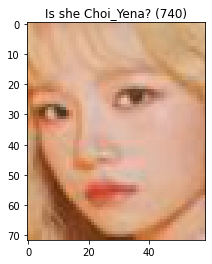

 <<< d : delete, a : pass, e : escape >>> 
d


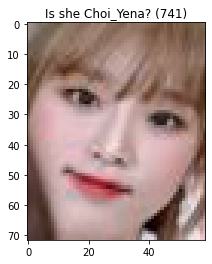

 <<< d : delete, a : pass, e : escape >>> 
a


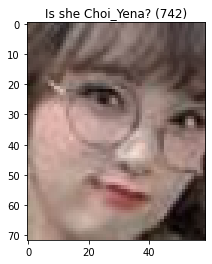

 <<< d : delete, a : pass, e : escape >>> 
a


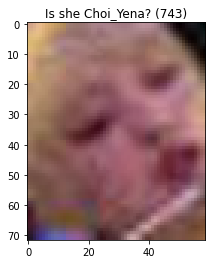

 <<< d : delete, a : pass, e : escape >>> 
d


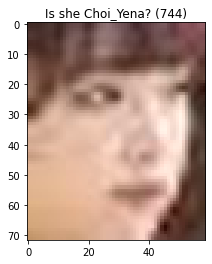

 <<< d : delete, a : pass, e : escape >>> 
d


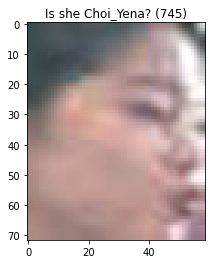

 <<< d : delete, a : pass, e : escape >>> 
d


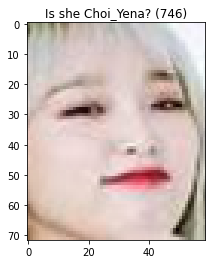

 <<< d : delete, a : pass, e : escape >>> 
a


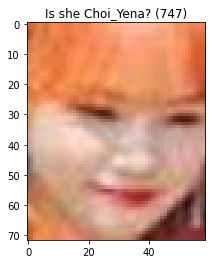

 <<< d : delete, a : pass, e : escape >>> 
d


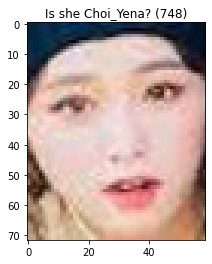

 <<< d : delete, a : pass, e : escape >>> 
d


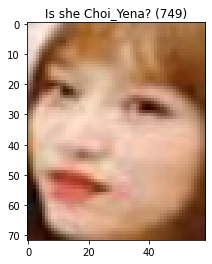

 <<< d : delete, a : pass, e : escape >>> 
a


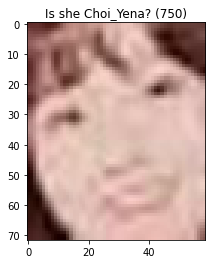

 <<< d : delete, a : pass, e : escape >>> 
d


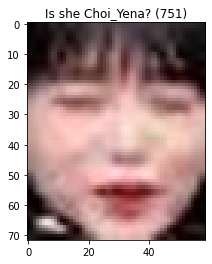

 <<< d : delete, a : pass, e : escape >>> 
d


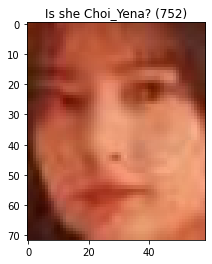

 <<< d : delete, a : pass, e : escape >>> 
d


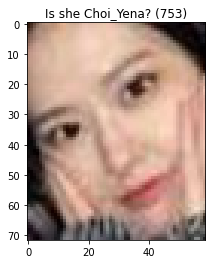

 <<< d : delete, a : pass, e : escape >>> 
d


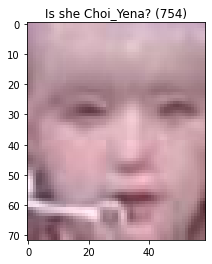

 <<< d : delete, a : pass, e : escape >>> 
d


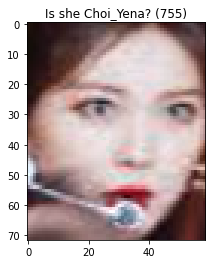

 <<< d : delete, a : pass, e : escape >>> 
d


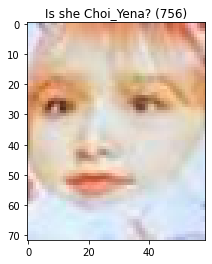

 <<< d : delete, a : pass, e : escape >>> 
a


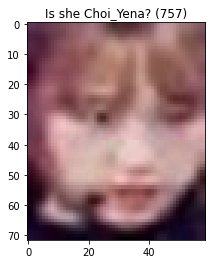

 <<< d : delete, a : pass, e : escape >>> 
d


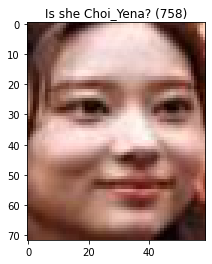

 <<< d : delete, a : pass, e : escape >>> 
d


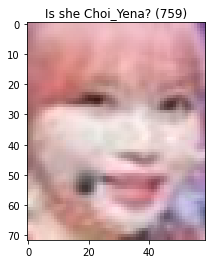

 <<< d : delete, a : pass, e : escape >>> 
d


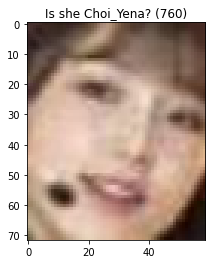

 <<< d : delete, a : pass, e : escape >>> 
d


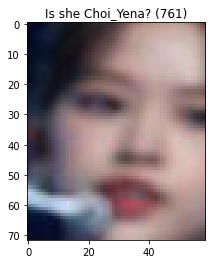

 <<< d : delete, a : pass, e : escape >>> 
d


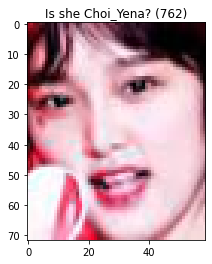

 <<< d : delete, a : pass, e : escape >>> 
a


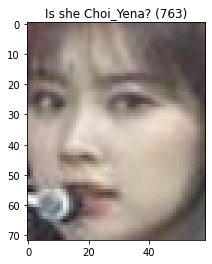

 <<< d : delete, a : pass, e : escape >>> 
d


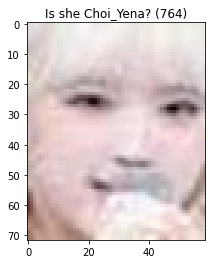

 <<< d : delete, a : pass, e : escape >>> 
a


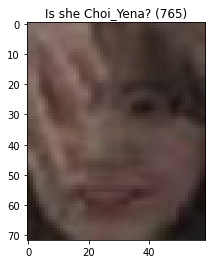

 <<< d : delete, a : pass, e : escape >>> 
d


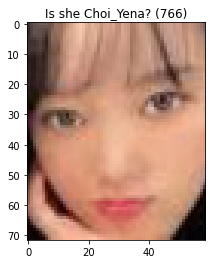

 <<< d : delete, a : pass, e : escape >>> 
d


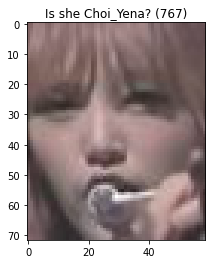

 <<< d : delete, a : pass, e : escape >>> 
d


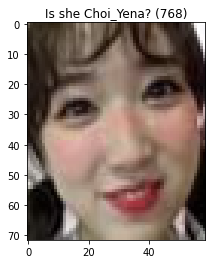

 <<< d : delete, a : pass, e : escape >>> 
d


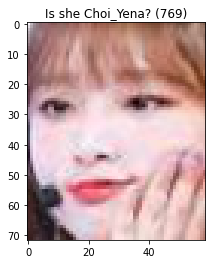

 <<< d : delete, a : pass, e : escape >>> 
a


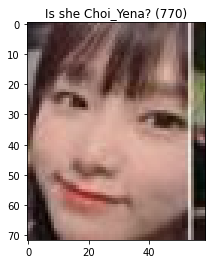

 <<< d : delete, a : pass, e : escape >>> 
a


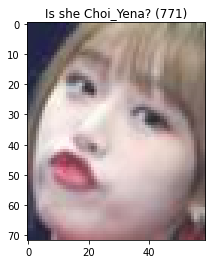

 <<< d : delete, a : pass, e : escape >>> 
a


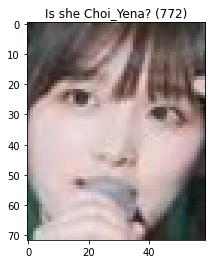

 <<< d : delete, a : pass, e : escape >>> 
a


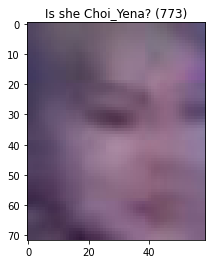

 <<< d : delete, a : pass, e : escape >>> 
d


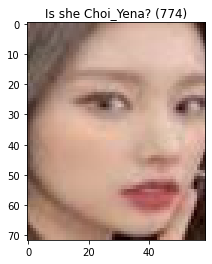

 <<< d : delete, a : pass, e : escape >>> 
d


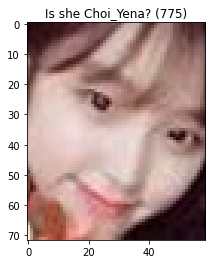

 <<< d : delete, a : pass, e : escape >>> 
a


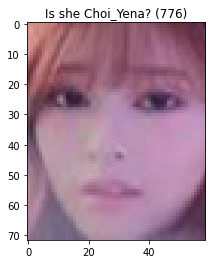

 <<< d : delete, a : pass, e : escape >>> 
d


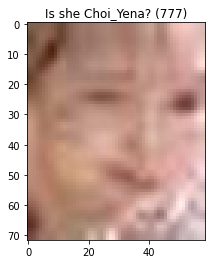

 <<< d : delete, a : pass, e : escape >>> 
d


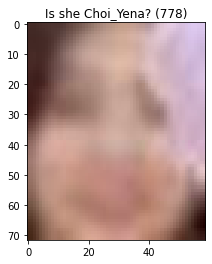

 <<< d : delete, a : pass, e : escape >>> 
d


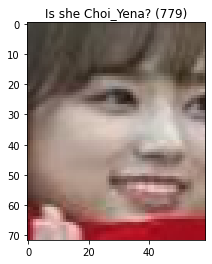

 <<< d : delete, a : pass, e : escape >>> 
d


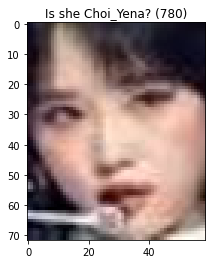

 <<< d : delete, a : pass, e : escape >>> 
a


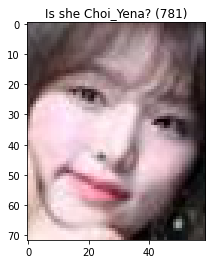

 <<< d : delete, a : pass, e : escape >>> 
a


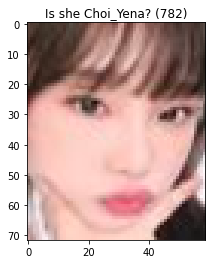

 <<< d : delete, a : pass, e : escape >>> 
a


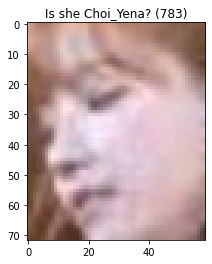

 <<< d : delete, a : pass, e : escape >>> 
d


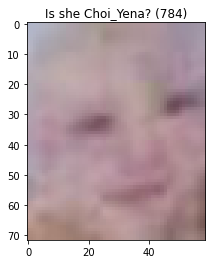

 <<< d : delete, a : pass, e : escape >>> 
d


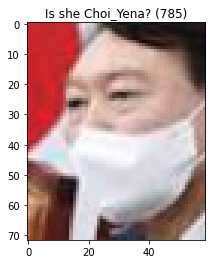

 <<< d : delete, a : pass, e : escape >>> 
d


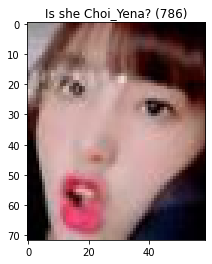

 <<< d : delete, a : pass, e : escape >>> 
d


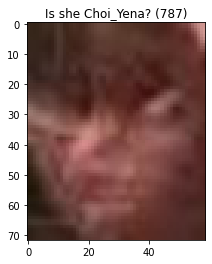

 <<< d : delete, a : pass, e : escape >>> 
d


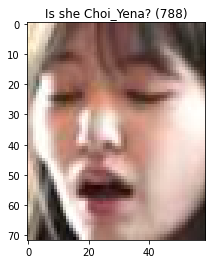

 <<< d : delete, a : pass, e : escape >>> 
d


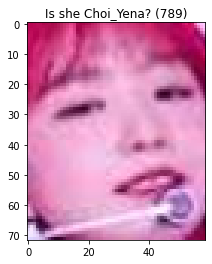

 <<< d : delete, a : pass, e : escape >>> 
d


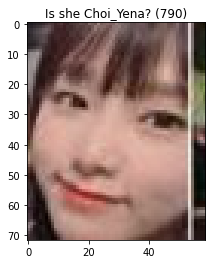

 <<< d : delete, a : pass, e : escape >>> 
a


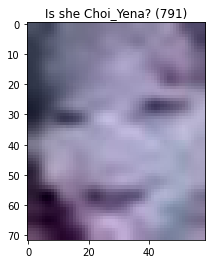

 <<< d : delete, a : pass, e : escape >>> 



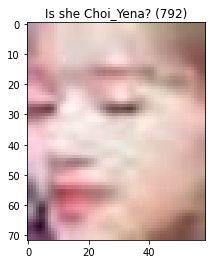

 <<< d : delete, a : pass, e : escape >>> 
d


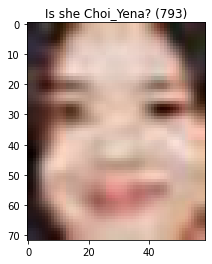

 <<< d : delete, a : pass, e : escape >>> 
d


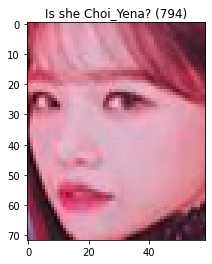

 <<< d : delete, a : pass, e : escape >>> 
d


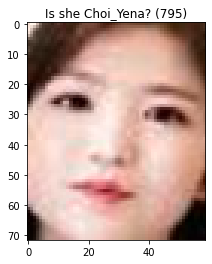

 <<< d : delete, a : pass, e : escape >>> 
d


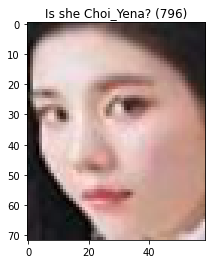

 <<< d : delete, a : pass, e : escape >>> 
d


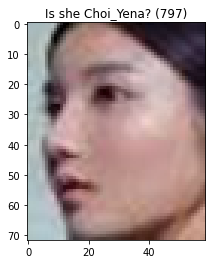

 <<< d : delete, a : pass, e : escape >>> 
d


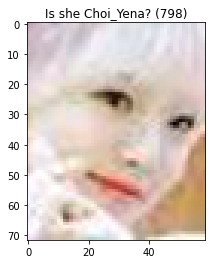

 <<< d : delete, a : pass, e : escape >>> 
d


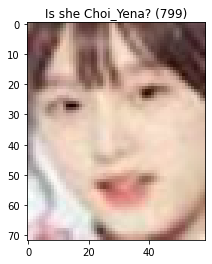

 <<< d : delete, a : pass, e : escape >>> 
a


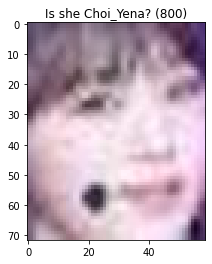

 <<< d : delete, a : pass, e : escape >>> 
d


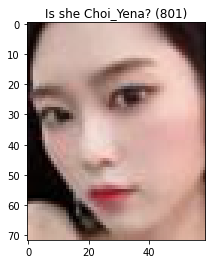

 <<< d : delete, a : pass, e : escape >>> 
d


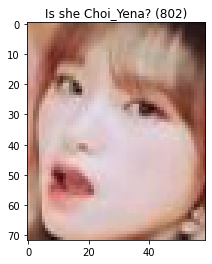

 <<< d : delete, a : pass, e : escape >>> 
a


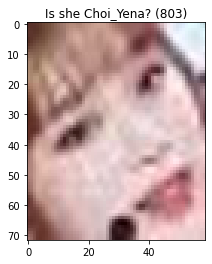

 <<< d : delete, a : pass, e : escape >>> 
d


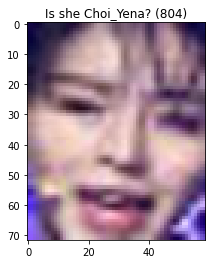

 <<< d : delete, a : pass, e : escape >>> 
d


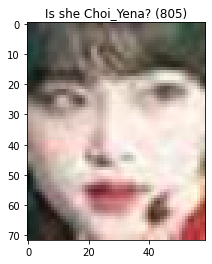

 <<< d : delete, a : pass, e : escape >>> 
d


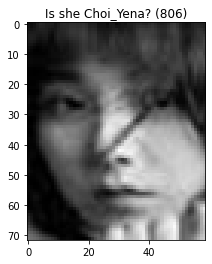

 <<< d : delete, a : pass, e : escape >>> 
d


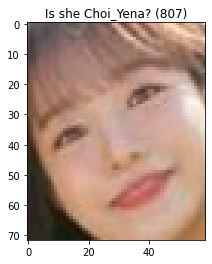

 <<< d : delete, a : pass, e : escape >>> 
d


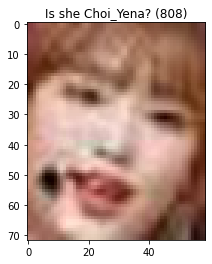

 <<< d : delete, a : pass, e : escape >>> 
d


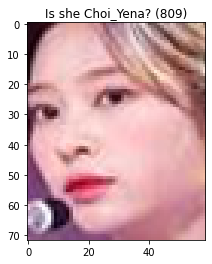

 <<< d : delete, a : pass, e : escape >>> 
d


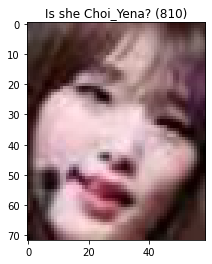

 <<< d : delete, a : pass, e : escape >>> 
a


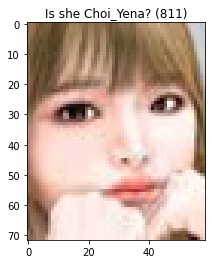

 <<< d : delete, a : pass, e : escape >>> 
a


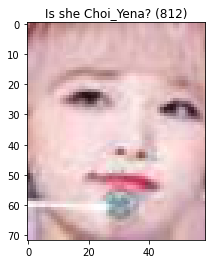

 <<< d : delete, a : pass, e : escape >>> 



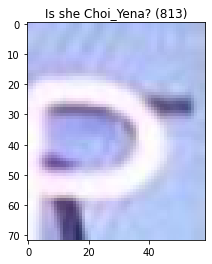

 <<< d : delete, a : pass, e : escape >>> 
d


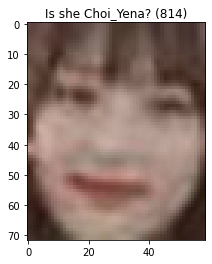

 <<< d : delete, a : pass, e : escape >>> 
d


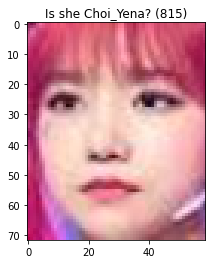

 <<< d : delete, a : pass, e : escape >>> 
d


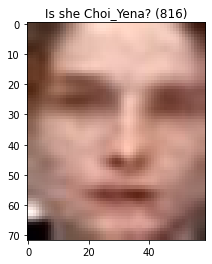

 <<< d : delete, a : pass, e : escape >>> 
d


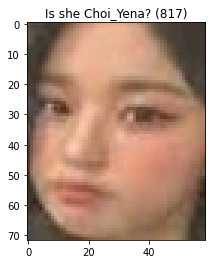

 <<< d : delete, a : pass, e : escape >>> 
d


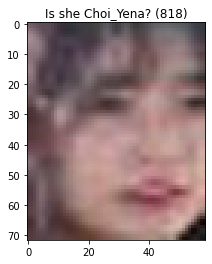

 <<< d : delete, a : pass, e : escape >>> 
d


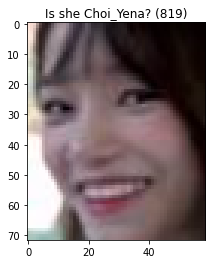

 <<< d : delete, a : pass, e : escape >>> 
d


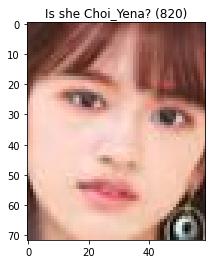

 <<< d : delete, a : pass, e : escape >>> 
d


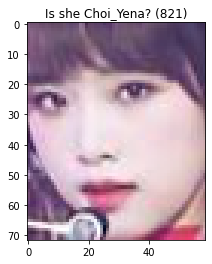

 <<< d : delete, a : pass, e : escape >>> 



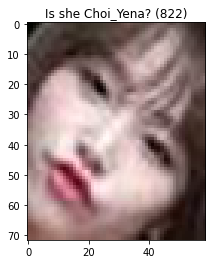

 <<< d : delete, a : pass, e : escape >>> 



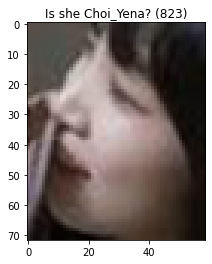

 <<< d : delete, a : pass, e : escape >>> 



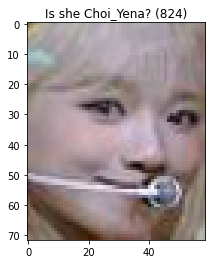

 <<< d : delete, a : pass, e : escape >>> 



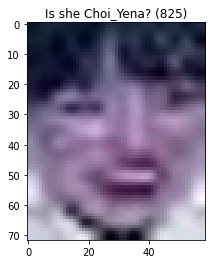

 <<< d : delete, a : pass, e : escape >>> 
d


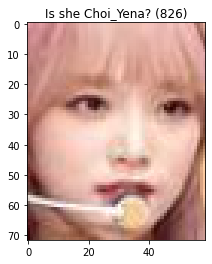

 <<< d : delete, a : pass, e : escape >>> 



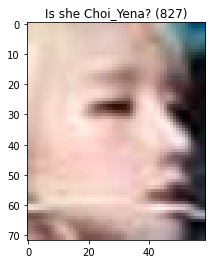

 <<< d : delete, a : pass, e : escape >>> 



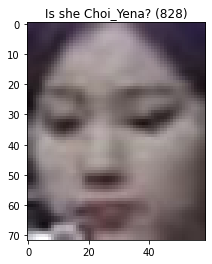

 <<< d : delete, a : pass, e : escape >>> 
d


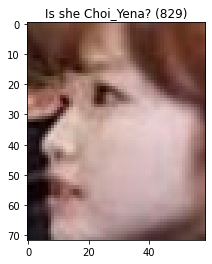

 <<< d : delete, a : pass, e : escape >>> 
d


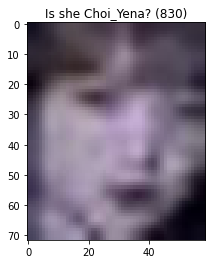

 <<< d : delete, a : pass, e : escape >>> 
d


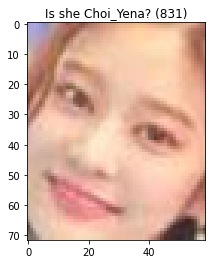

 <<< d : delete, a : pass, e : escape >>> 



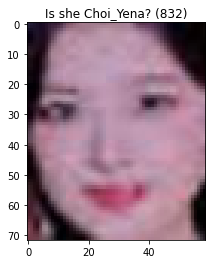

 <<< d : delete, a : pass, e : escape >>> 
d


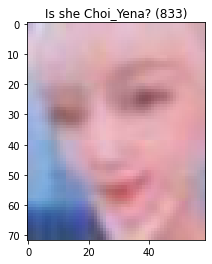

 <<< d : delete, a : pass, e : escape >>> 
d


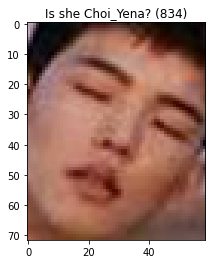

 <<< d : delete, a : pass, e : escape >>> 
d


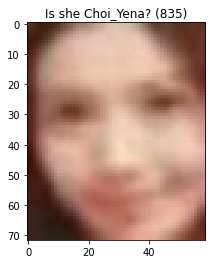

 <<< d : delete, a : pass, e : escape >>> 
d


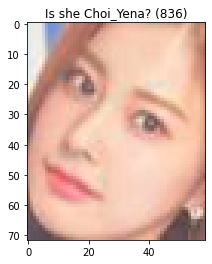

 <<< d : delete, a : pass, e : escape >>> 
d


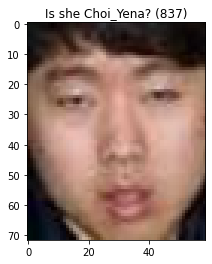

 <<< d : delete, a : pass, e : escape >>> 
d


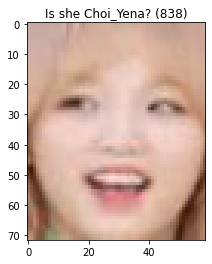

 <<< d : delete, a : pass, e : escape >>> 



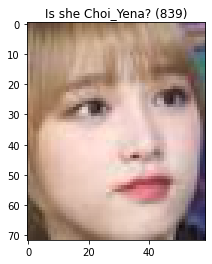

 <<< d : delete, a : pass, e : escape >>> 



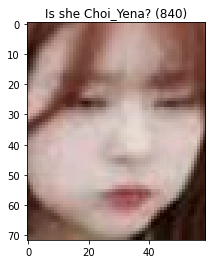

 <<< d : delete, a : pass, e : escape >>> 
d


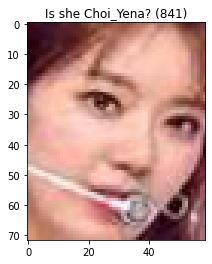

 <<< d : delete, a : pass, e : escape >>> 
d


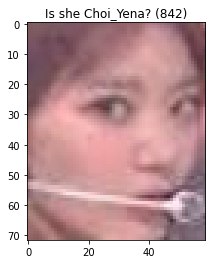

 <<< d : delete, a : pass, e : escape >>> 
d


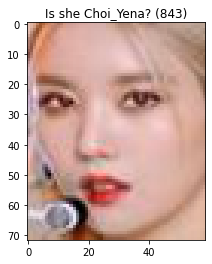

 <<< d : delete, a : pass, e : escape >>> 
d


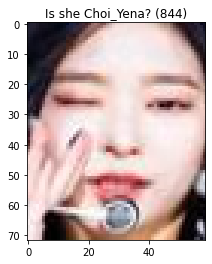

 <<< d : delete, a : pass, e : escape >>> 
d


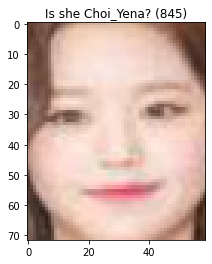

 <<< d : delete, a : pass, e : escape >>> 
d


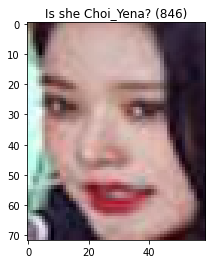

 <<< d : delete, a : pass, e : escape >>> 
d


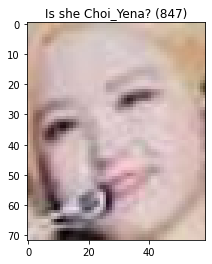

 <<< d : delete, a : pass, e : escape >>> 
d


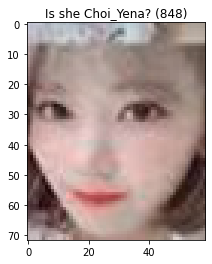

 <<< d : delete, a : pass, e : escape >>> 
d


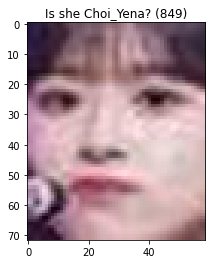

 <<< d : delete, a : pass, e : escape >>> 
d


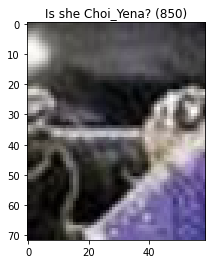

 <<< d : delete, a : pass, e : escape >>> 
d


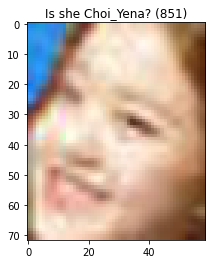

 <<< d : delete, a : pass, e : escape >>> 
d


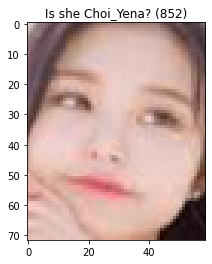

 <<< d : delete, a : pass, e : escape >>> 
d


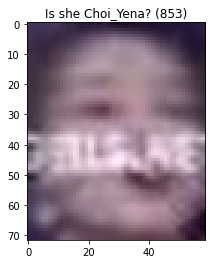

 <<< d : delete, a : pass, e : escape >>> 
d


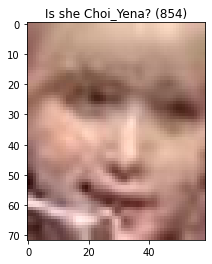

 <<< d : delete, a : pass, e : escape >>> 
d


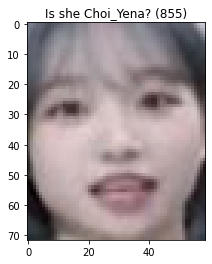

 <<< d : delete, a : pass, e : escape >>> 
d


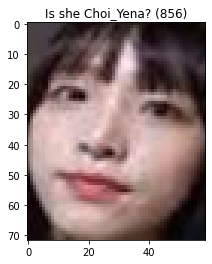

 <<< d : delete, a : pass, e : escape >>> 



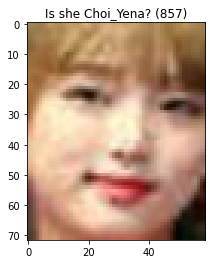

 <<< d : delete, a : pass, e : escape >>> 



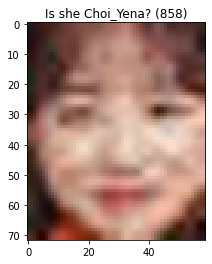

 <<< d : delete, a : pass, e : escape >>> 
d


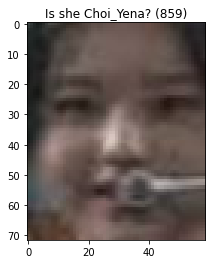

 <<< d : delete, a : pass, e : escape >>> 
d


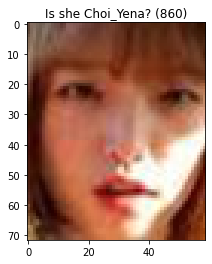

 <<< d : delete, a : pass, e : escape >>> 



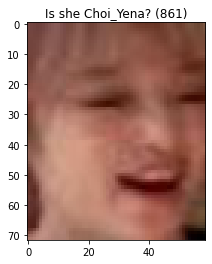

 <<< d : delete, a : pass, e : escape >>> 



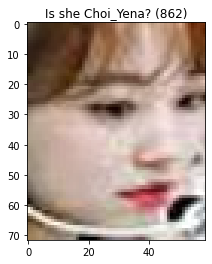

 <<< d : delete, a : pass, e : escape >>> 
d


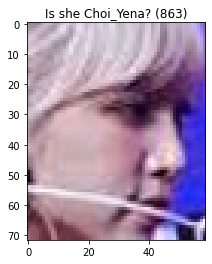

 <<< d : delete, a : pass, e : escape >>> 



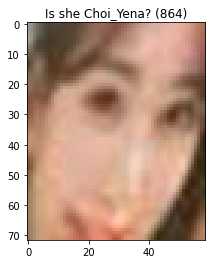

 <<< d : delete, a : pass, e : escape >>> 
d


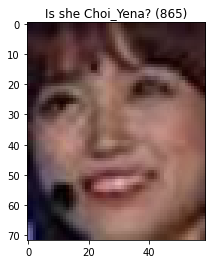

 <<< d : delete, a : pass, e : escape >>> 
d


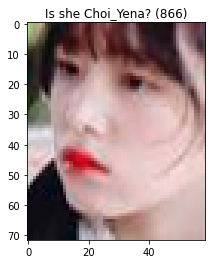

 <<< d : delete, a : pass, e : escape >>> 



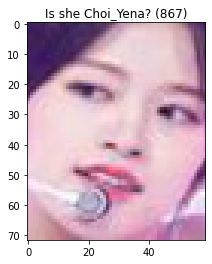

 <<< d : delete, a : pass, e : escape >>> 
d


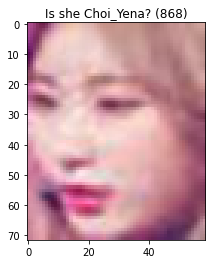

 <<< d : delete, a : pass, e : escape >>> 
d


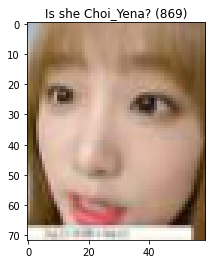

 <<< d : delete, a : pass, e : escape >>> 



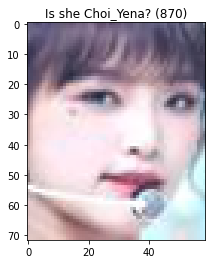

 <<< d : delete, a : pass, e : escape >>> 



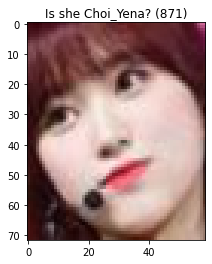

 <<< d : delete, a : pass, e : escape >>> 
d


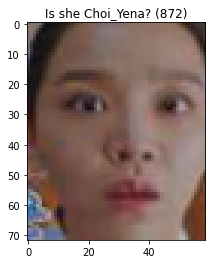

 <<< d : delete, a : pass, e : escape >>> 
d


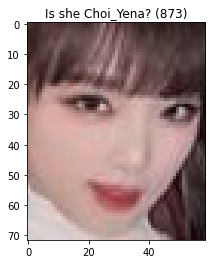

 <<< d : delete, a : pass, e : escape >>> 



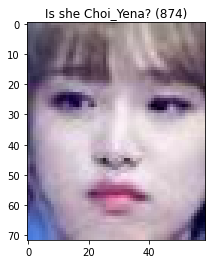

 <<< d : delete, a : pass, e : escape >>> 



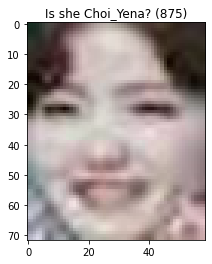

 <<< d : delete, a : pass, e : escape >>> 
d


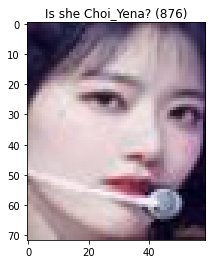

 <<< d : delete, a : pass, e : escape >>> 
d


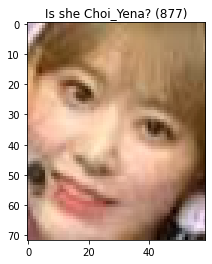

 <<< d : delete, a : pass, e : escape >>> 
d


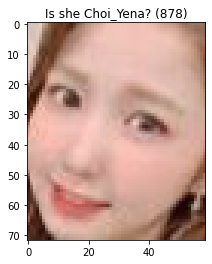

 <<< d : delete, a : pass, e : escape >>> 
d


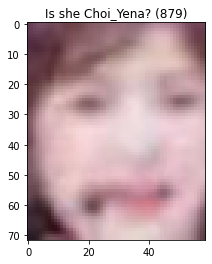

 <<< d : delete, a : pass, e : escape >>> 
d


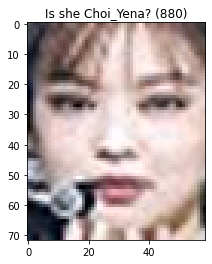

 <<< d : delete, a : pass, e : escape >>> 
d


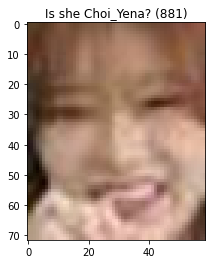

 <<< d : delete, a : pass, e : escape >>> 
d


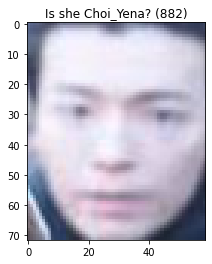

 <<< d : delete, a : pass, e : escape >>> 
d


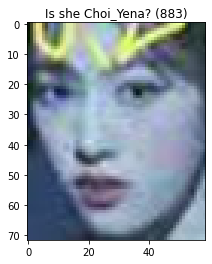

 <<< d : delete, a : pass, e : escape >>> 
d


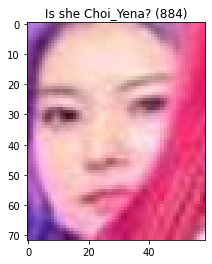

 <<< d : delete, a : pass, e : escape >>> 
d


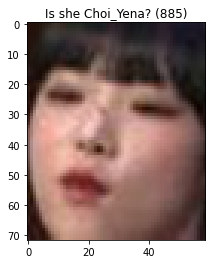

 <<< d : delete, a : pass, e : escape >>> 



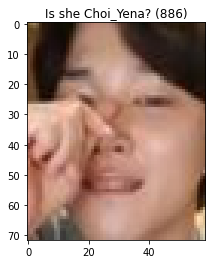

 <<< d : delete, a : pass, e : escape >>> 
d


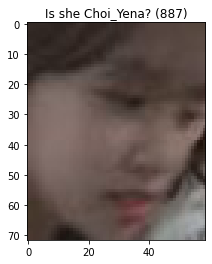

 <<< d : delete, a : pass, e : escape >>> 
d


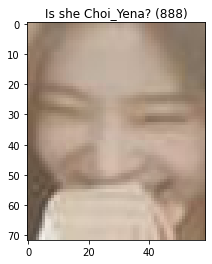

 <<< d : delete, a : pass, e : escape >>> 
dd


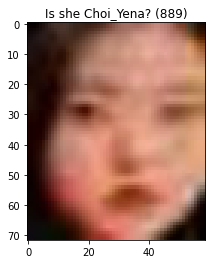

 <<< d : delete, a : pass, e : escape >>> 
d


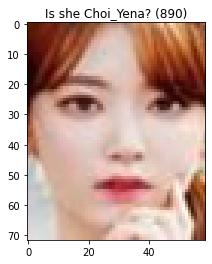

 <<< d : delete, a : pass, e : escape >>> 
d


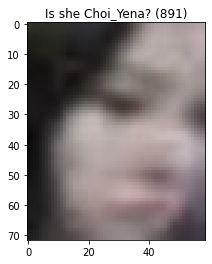

 <<< d : delete, a : pass, e : escape >>> 
d


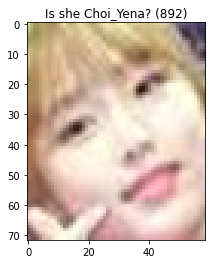

 <<< d : delete, a : pass, e : escape >>> 



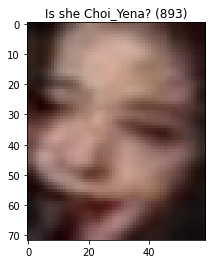

 <<< d : delete, a : pass, e : escape >>> 
d


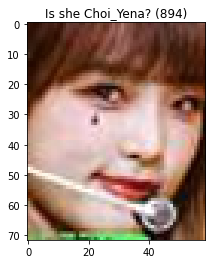

 <<< d : delete, a : pass, e : escape >>> 



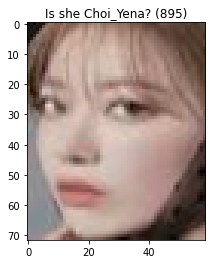

 <<< d : delete, a : pass, e : escape >>> 
d


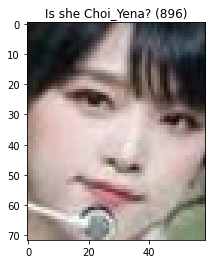

 <<< d : delete, a : pass, e : escape >>> 



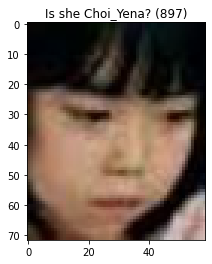

 <<< d : delete, a : pass, e : escape >>> 
d


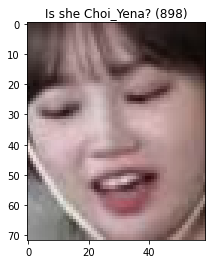

 <<< d : delete, a : pass, e : escape >>> 
d


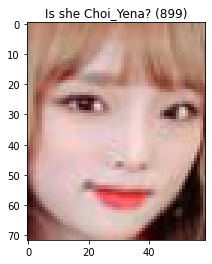

 <<< d : delete, a : pass, e : escape >>> 
d


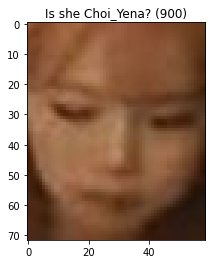

 <<< d : delete, a : pass, e : escape >>> 
d


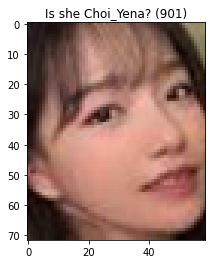

 <<< d : delete, a : pass, e : escape >>> 
d


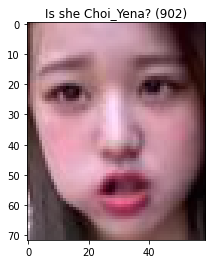

 <<< d : delete, a : pass, e : escape >>> 
d


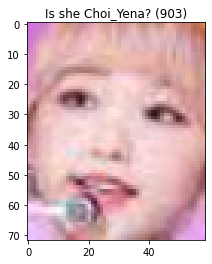

 <<< d : delete, a : pass, e : escape >>> 



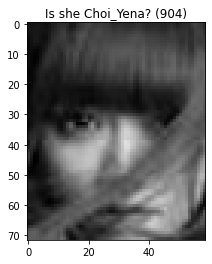

 <<< d : delete, a : pass, e : escape >>> 
d


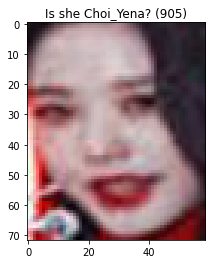

 <<< d : delete, a : pass, e : escape >>> 
d


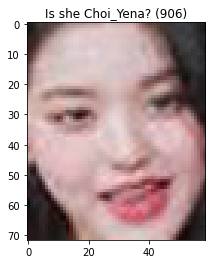

 <<< d : delete, a : pass, e : escape >>> 
d


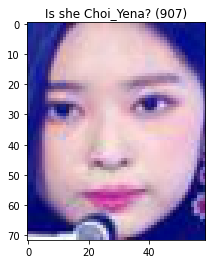

 <<< d : delete, a : pass, e : escape >>> 
d


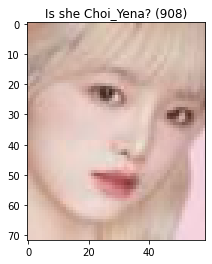

 <<< d : delete, a : pass, e : escape >>> 



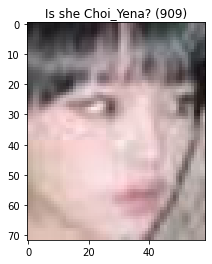

 <<< d : delete, a : pass, e : escape >>> 



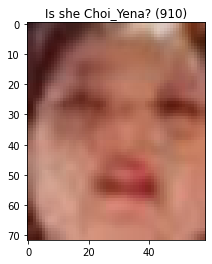

 <<< d : delete, a : pass, e : escape >>> 
d


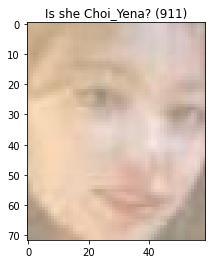

 <<< d : delete, a : pass, e : escape >>> 
d


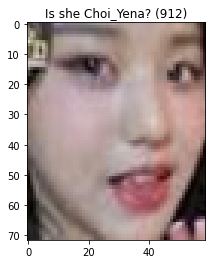

 <<< d : delete, a : pass, e : escape >>> 
d


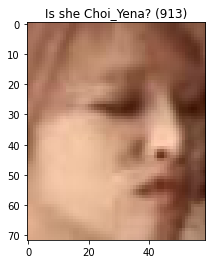

 <<< d : delete, a : pass, e : escape >>> 
d


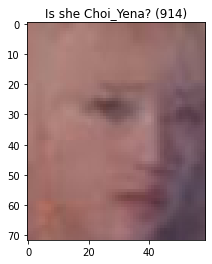

 <<< d : delete, a : pass, e : escape >>> 
d


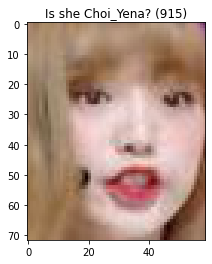

 <<< d : delete, a : pass, e : escape >>> 
d


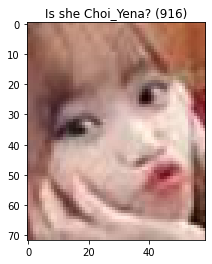

 <<< d : delete, a : pass, e : escape >>> 
d


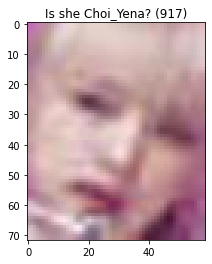

 <<< d : delete, a : pass, e : escape >>> 
d


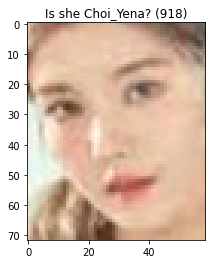

 <<< d : delete, a : pass, e : escape >>> 
d


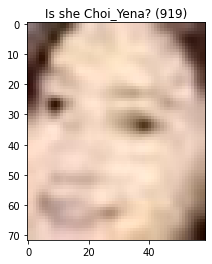

 <<< d : delete, a : pass, e : escape >>> 
d


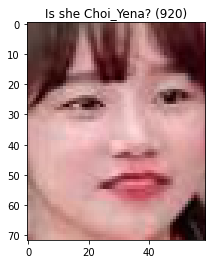

 <<< d : delete, a : pass, e : escape >>> 
d


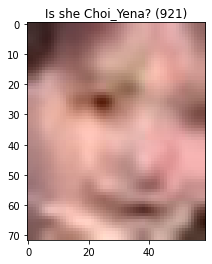

 <<< d : delete, a : pass, e : escape >>> 
d


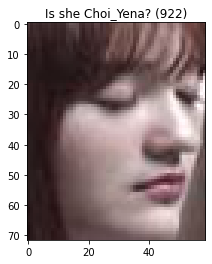

 <<< d : delete, a : pass, e : escape >>> 
d


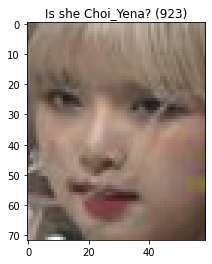

 <<< d : delete, a : pass, e : escape >>> 



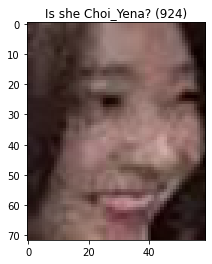

 <<< d : delete, a : pass, e : escape >>> 
d


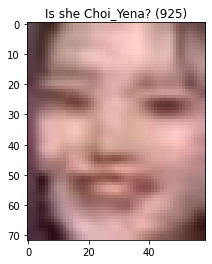

 <<< d : delete, a : pass, e : escape >>> 
d


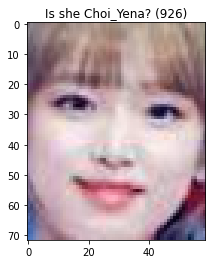

 <<< d : delete, a : pass, e : escape >>> 



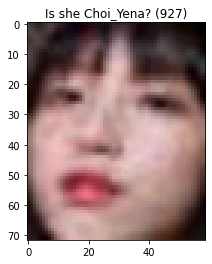

 <<< d : delete, a : pass, e : escape >>> 
d


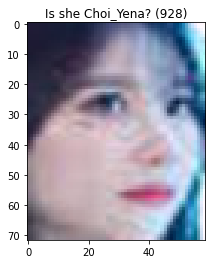

 <<< d : delete, a : pass, e : escape >>> 
d


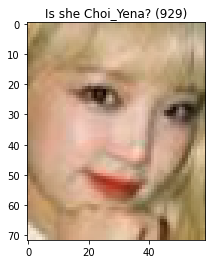

 <<< d : delete, a : pass, e : escape >>> 



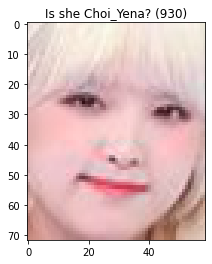

 <<< d : delete, a : pass, e : escape >>> 



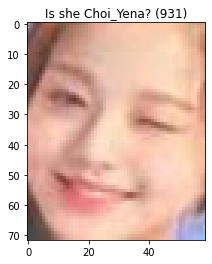

 <<< d : delete, a : pass, e : escape >>> 
d


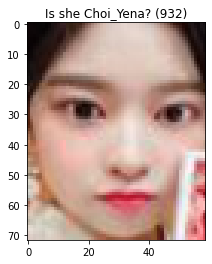

 <<< d : delete, a : pass, e : escape >>> 
d


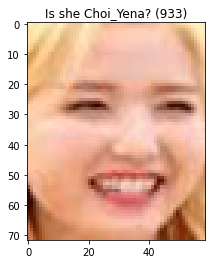

 <<< d : delete, a : pass, e : escape >>> 
d


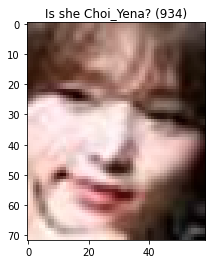

 <<< d : delete, a : pass, e : escape >>> 
d


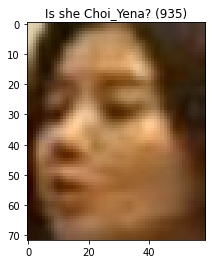

 <<< d : delete, a : pass, e : escape >>> 
d


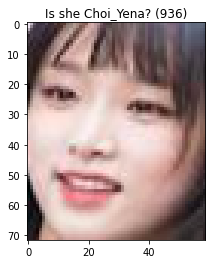

 <<< d : delete, a : pass, e : escape >>> 



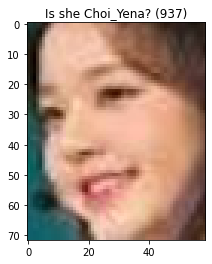

 <<< d : delete, a : pass, e : escape >>> 
d


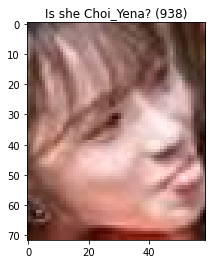

 <<< d : delete, a : pass, e : escape >>> 
d


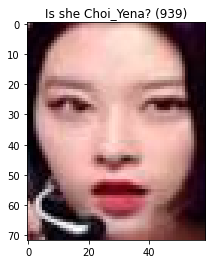

 <<< d : delete, a : pass, e : escape >>> 
d


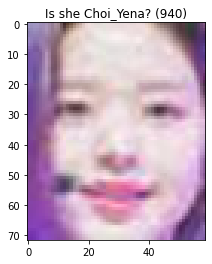

 <<< d : delete, a : pass, e : escape >>> 
d


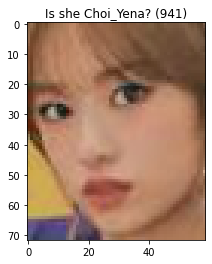

 <<< d : delete, a : pass, e : escape >>> 
d


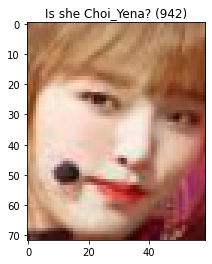

 <<< d : delete, a : pass, e : escape >>> 



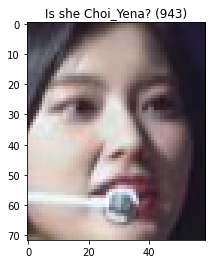

 <<< d : delete, a : pass, e : escape >>> 
d


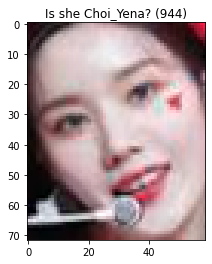

 <<< d : delete, a : pass, e : escape >>> 
d


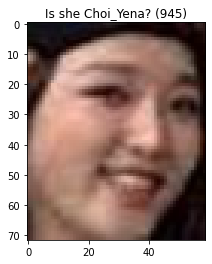

 <<< d : delete, a : pass, e : escape >>> 
d


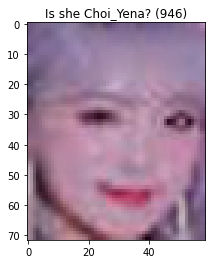

 <<< d : delete, a : pass, e : escape >>> 



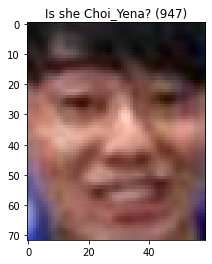

 <<< d : delete, a : pass, e : escape >>> 
d


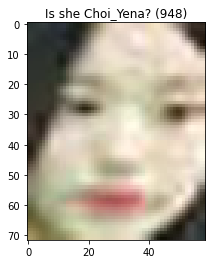

 <<< d : delete, a : pass, e : escape >>> 
d


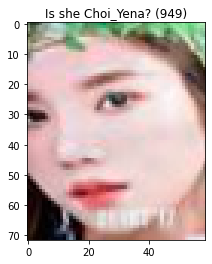

 <<< d : delete, a : pass, e : escape >>> 
d


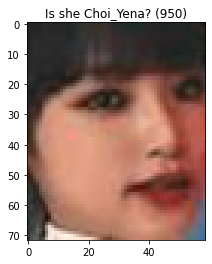

 <<< d : delete, a : pass, e : escape >>> 



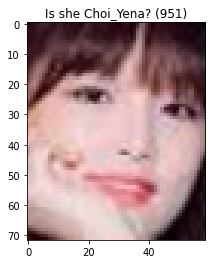

 <<< d : delete, a : pass, e : escape >>> 



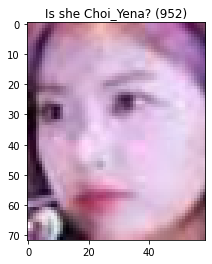

 <<< d : delete, a : pass, e : escape >>> 
d


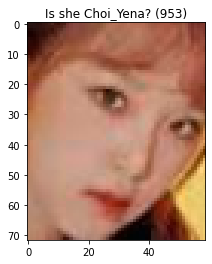

 <<< d : delete, a : pass, e : escape >>> 



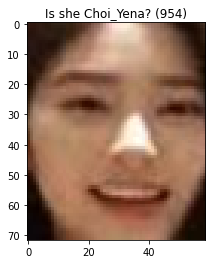

 <<< d : delete, a : pass, e : escape >>> 
d


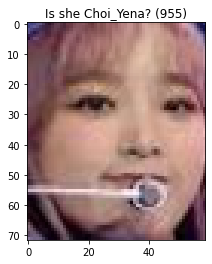

 <<< d : delete, a : pass, e : escape >>> 



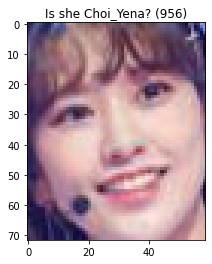

 <<< d : delete, a : pass, e : escape >>> 
d


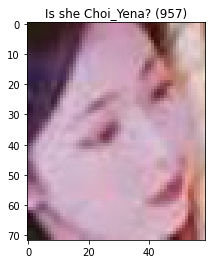

 <<< d : delete, a : pass, e : escape >>> 
d


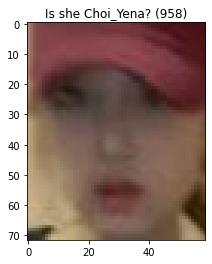

 <<< d : delete, a : pass, e : escape >>> 
d


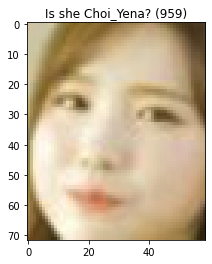

 <<< d : delete, a : pass, e : escape >>> 
d


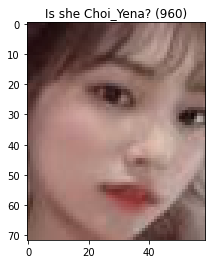

 <<< d : delete, a : pass, e : escape >>> 
d


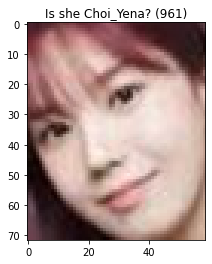

 <<< d : delete, a : pass, e : escape >>> 
d


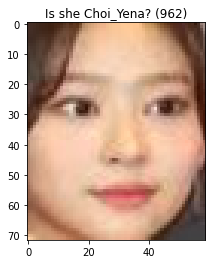

 <<< d : delete, a : pass, e : escape >>> 
d


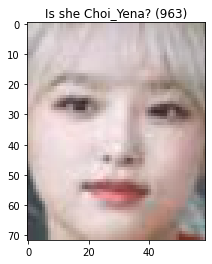

 <<< d : delete, a : pass, e : escape >>> 



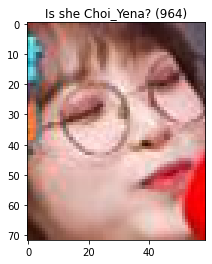

 <<< d : delete, a : pass, e : escape >>> 



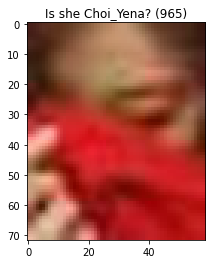

 <<< d : delete, a : pass, e : escape >>> 
d


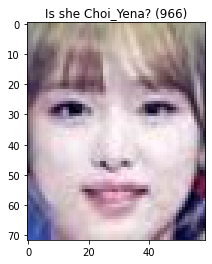

 <<< d : delete, a : pass, e : escape >>> 



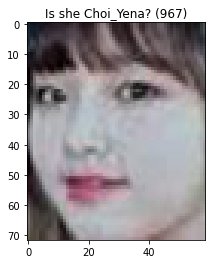

 <<< d : delete, a : pass, e : escape >>> 



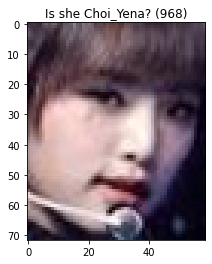

 <<< d : delete, a : pass, e : escape >>> 



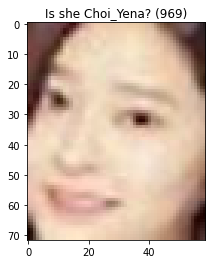

 <<< d : delete, a : pass, e : escape >>> 
d


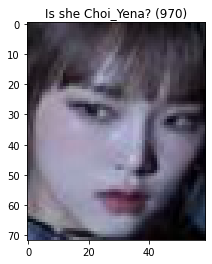

 <<< d : delete, a : pass, e : escape >>> 
d


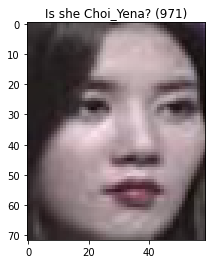

 <<< d : delete, a : pass, e : escape >>> 
d


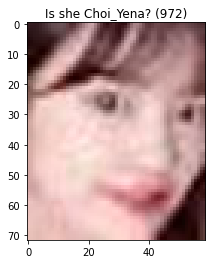

 <<< d : delete, a : pass, e : escape >>> 
d


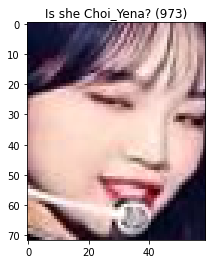

 <<< d : delete, a : pass, e : escape >>> 
d


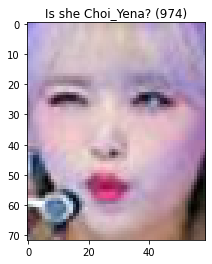

 <<< d : delete, a : pass, e : escape >>> 
d


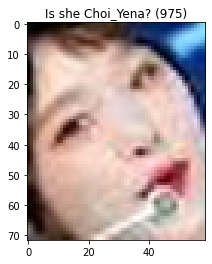

 <<< d : delete, a : pass, e : escape >>> 



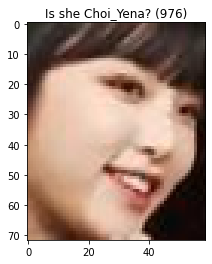

 <<< d : delete, a : pass, e : escape >>> 



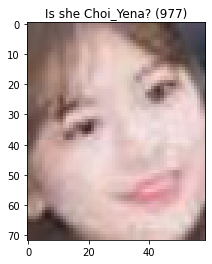

 <<< d : delete, a : pass, e : escape >>> 
d


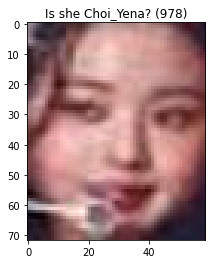

 <<< d : delete, a : pass, e : escape >>> 
d


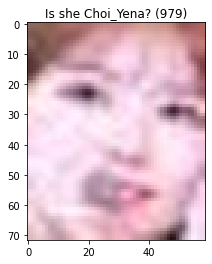

 <<< d : delete, a : pass, e : escape >>> 
d


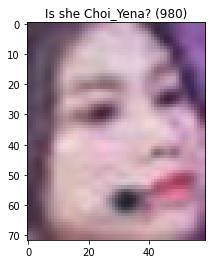

 <<< d : delete, a : pass, e : escape >>> 
d


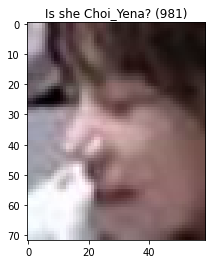

 <<< d : delete, a : pass, e : escape >>> 
d


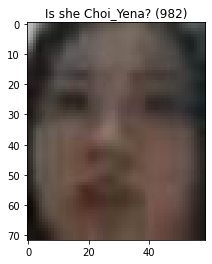

 <<< d : delete, a : pass, e : escape >>> 
d


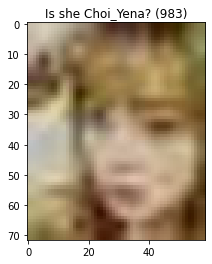

 <<< d : delete, a : pass, e : escape >>> 
d


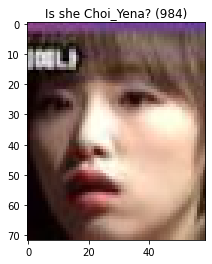

 <<< d : delete, a : pass, e : escape >>> 



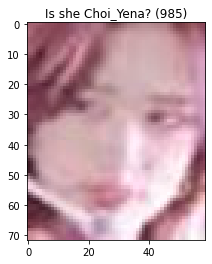

 <<< d : delete, a : pass, e : escape >>> 
d


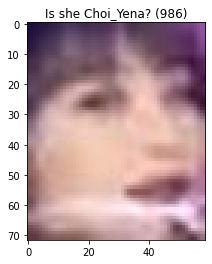

 <<< d : delete, a : pass, e : escape >>> 
d


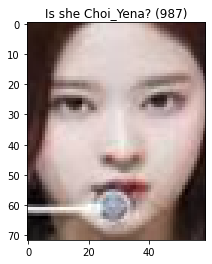

 <<< d : delete, a : pass, e : escape >>> 
d


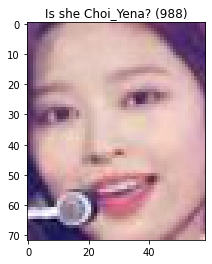

 <<< d : delete, a : pass, e : escape >>> 
d


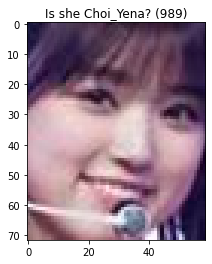

 <<< d : delete, a : pass, e : escape >>> 
d


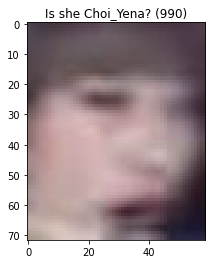

 <<< d : delete, a : pass, e : escape >>> 
d


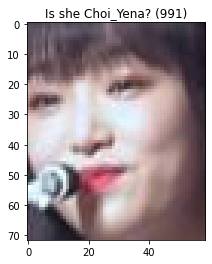

 <<< d : delete, a : pass, e : escape >>> 



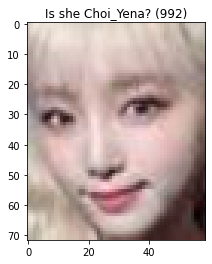

 <<< d : delete, a : pass, e : escape >>> 



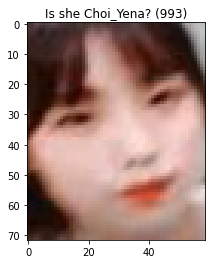

 <<< d : delete, a : pass, e : escape >>> 



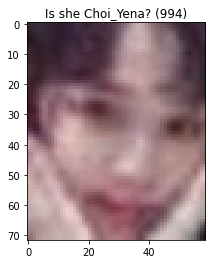

 <<< d : delete, a : pass, e : escape >>> 
d


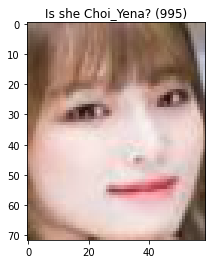

 <<< d : delete, a : pass, e : escape >>> 



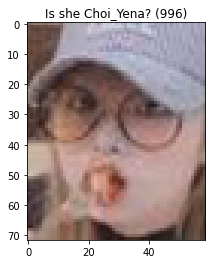

 <<< d : delete, a : pass, e : escape >>> 



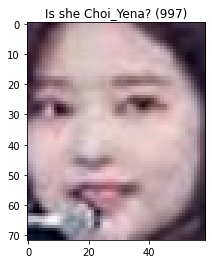

 <<< d : delete, a : pass, e : escape >>> 
d


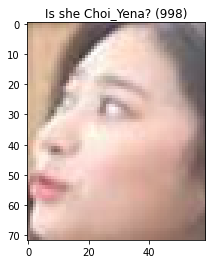

 <<< d : delete, a : pass, e : escape >>> 
d


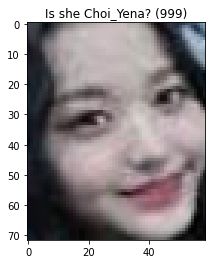

 <<< d : delete, a : pass, e : escape >>> 
d


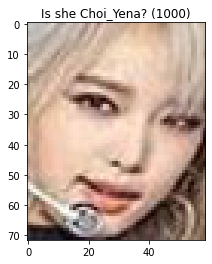

 <<< d : delete, a : pass, e : escape >>> 



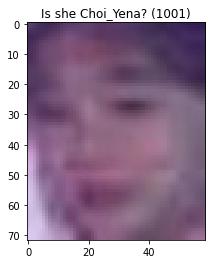

 <<< d : delete, a : pass, e : escape >>> 
d


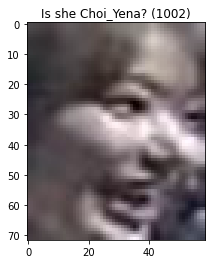

 <<< d : delete, a : pass, e : escape >>> 
d


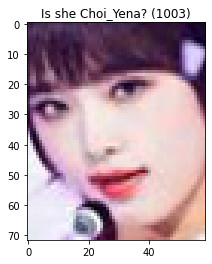

 <<< d : delete, a : pass, e : escape >>> 



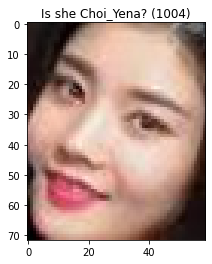

 <<< d : delete, a : pass, e : escape >>> 
d


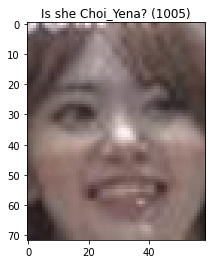

 <<< d : delete, a : pass, e : escape >>> 
d


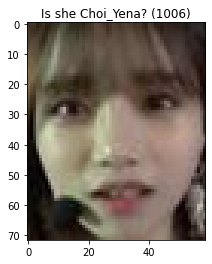

 <<< d : delete, a : pass, e : escape >>> 
d


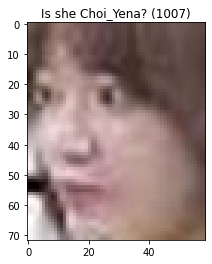

 <<< d : delete, a : pass, e : escape >>> 
d


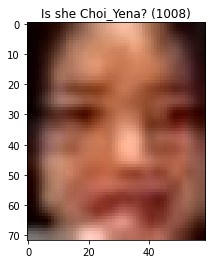

 <<< d : delete, a : pass, e : escape >>> 
d


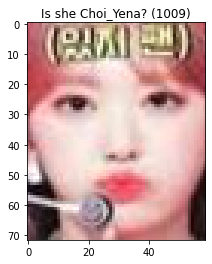

 <<< d : delete, a : pass, e : escape >>> 
d


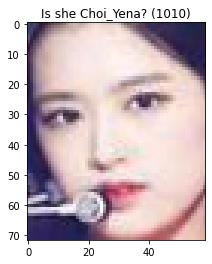

 <<< d : delete, a : pass, e : escape >>> 
d


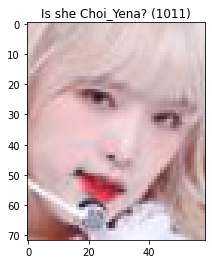

 <<< d : delete, a : pass, e : escape >>> 



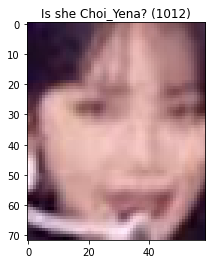

 <<< d : delete, a : pass, e : escape >>> 
d


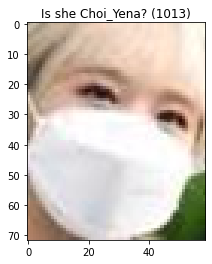

 <<< d : delete, a : pass, e : escape >>> 
d


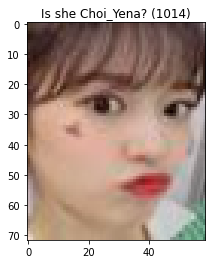

 <<< d : delete, a : pass, e : escape >>> 
d


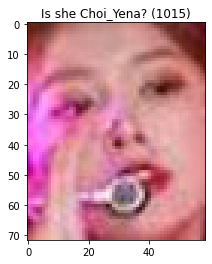

 <<< d : delete, a : pass, e : escape >>> 
d


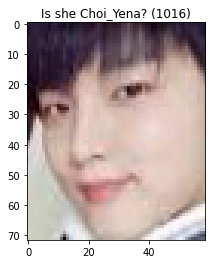

 <<< d : delete, a : pass, e : escape >>> 
d


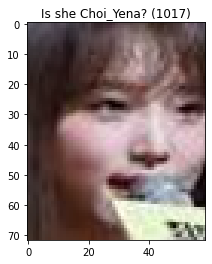

 <<< d : delete, a : pass, e : escape >>> 
d


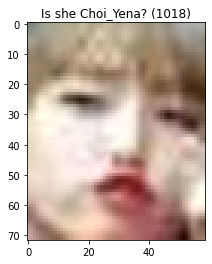

 <<< d : delete, a : pass, e : escape >>> 



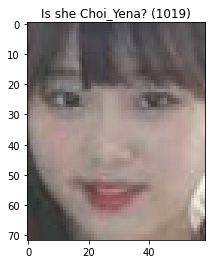

 <<< d : delete, a : pass, e : escape >>> 



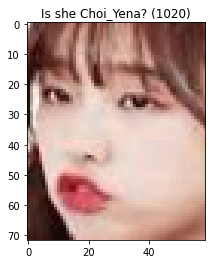

 <<< d : delete, a : pass, e : escape >>> 



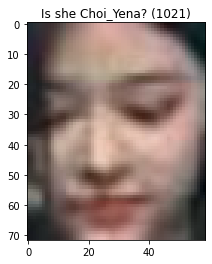

 <<< d : delete, a : pass, e : escape >>> 
d


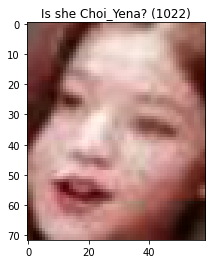

 <<< d : delete, a : pass, e : escape >>> 
d


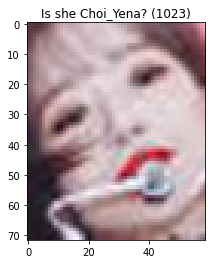

 <<< d : delete, a : pass, e : escape >>> 
d


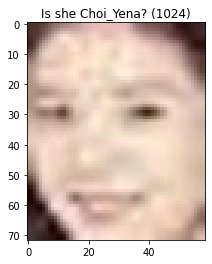

 <<< d : delete, a : pass, e : escape >>> 
d


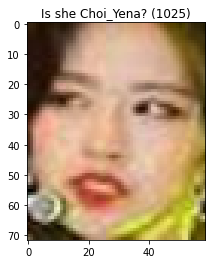

 <<< d : delete, a : pass, e : escape >>> 
d


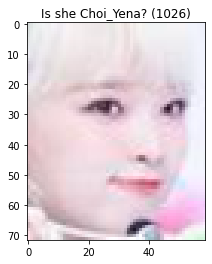

 <<< d : delete, a : pass, e : escape >>> 



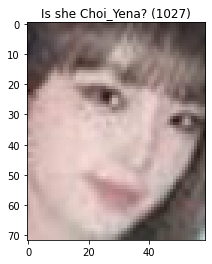

 <<< d : delete, a : pass, e : escape >>> 



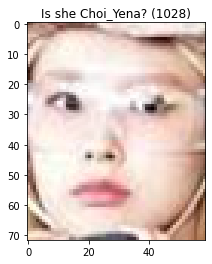

 <<< d : delete, a : pass, e : escape >>> 
d


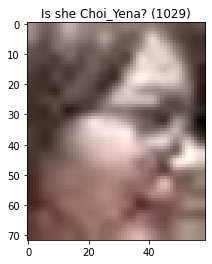

 <<< d : delete, a : pass, e : escape >>> 
d


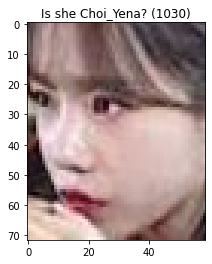

 <<< d : delete, a : pass, e : escape >>> 
d


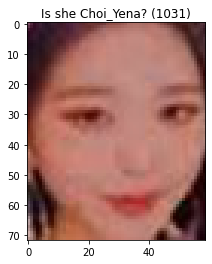

 <<< d : delete, a : pass, e : escape >>> 
d


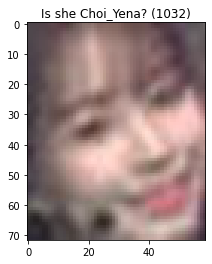

 <<< d : delete, a : pass, e : escape >>> 
d


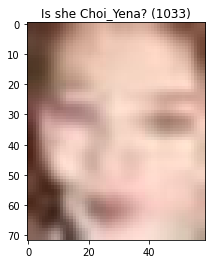

 <<< d : delete, a : pass, e : escape >>> 
d


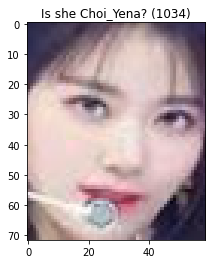

 <<< d : delete, a : pass, e : escape >>> 
d


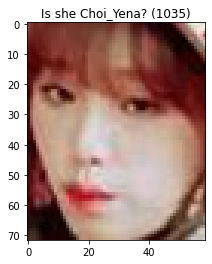

 <<< d : delete, a : pass, e : escape >>> 



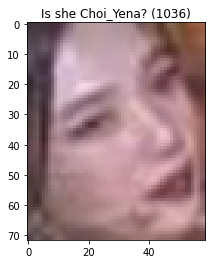

 <<< d : delete, a : pass, e : escape >>> 
d


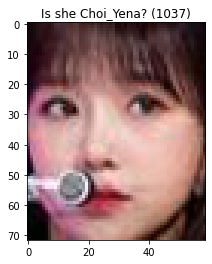

 <<< d : delete, a : pass, e : escape >>> 
d


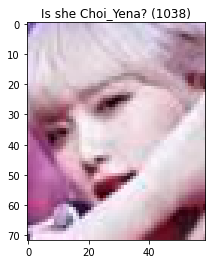

 <<< d : delete, a : pass, e : escape >>> 



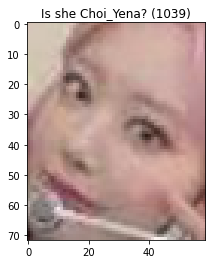

 <<< d : delete, a : pass, e : escape >>> 
d


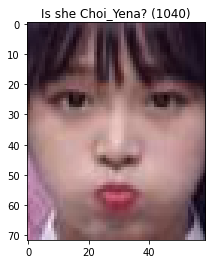

 <<< d : delete, a : pass, e : escape >>> 



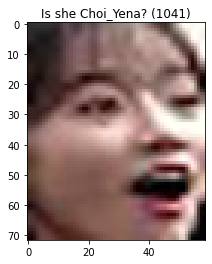

 <<< d : delete, a : pass, e : escape >>> 
d


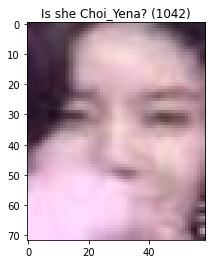

 <<< d : delete, a : pass, e : escape >>> 
d


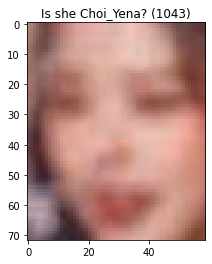

 <<< d : delete, a : pass, e : escape >>> 
d


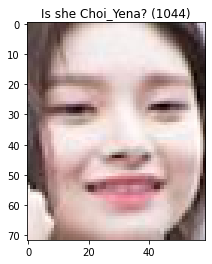

 <<< d : delete, a : pass, e : escape >>> 
d


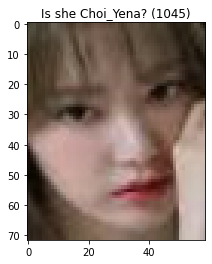

 <<< d : delete, a : pass, e : escape >>> 
d


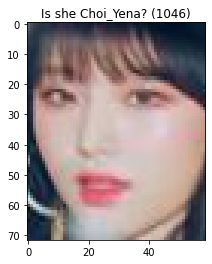

 <<< d : delete, a : pass, e : escape >>> 



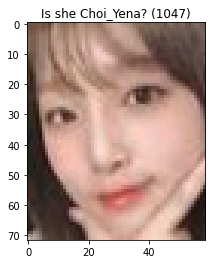

 <<< d : delete, a : pass, e : escape >>> 



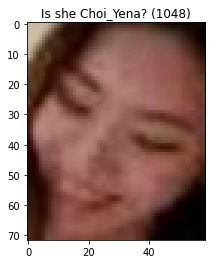

 <<< d : delete, a : pass, e : escape >>> 
d


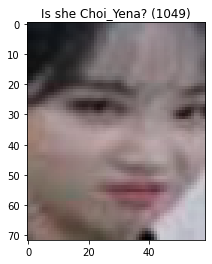

 <<< d : delete, a : pass, e : escape >>> 
d


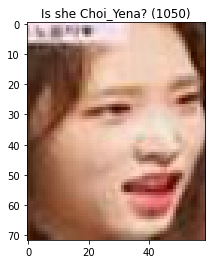

 <<< d : delete, a : pass, e : escape >>> 
d


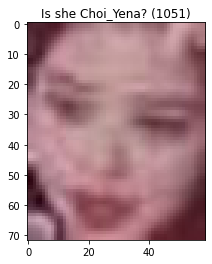

 <<< d : delete, a : pass, e : escape >>> 
d


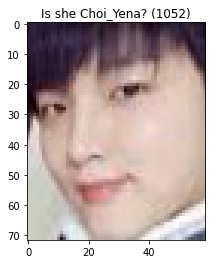

 <<< d : delete, a : pass, e : escape >>> 
d


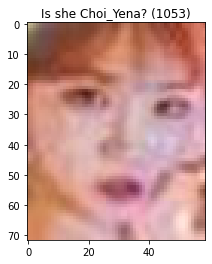

 <<< d : delete, a : pass, e : escape >>> 
d


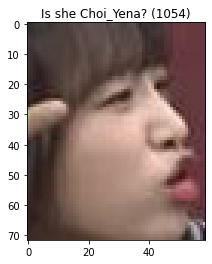

 <<< d : delete, a : pass, e : escape >>> 



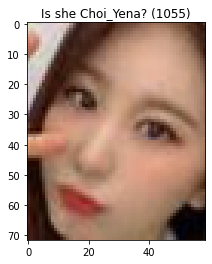

 <<< d : delete, a : pass, e : escape >>> 
d


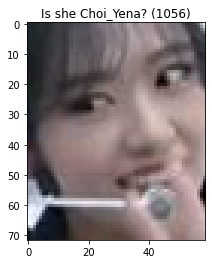

 <<< d : delete, a : pass, e : escape >>> 
d


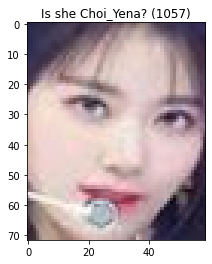

 <<< d : delete, a : pass, e : escape >>> 
d


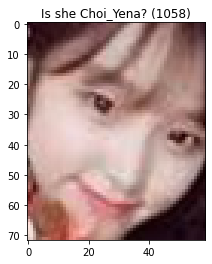

 <<< d : delete, a : pass, e : escape >>> 
a


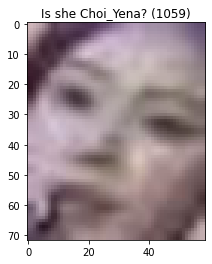

 <<< d : delete, a : pass, e : escape >>> 
d


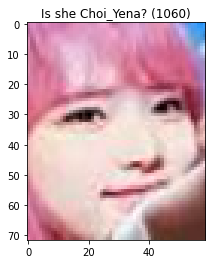

 <<< d : delete, a : pass, e : escape >>> 



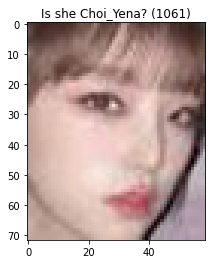

 <<< d : delete, a : pass, e : escape >>> 



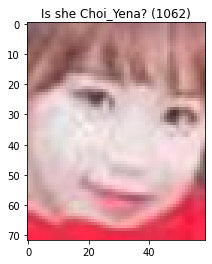

 <<< d : delete, a : pass, e : escape >>> 


KeyboardInterrupt: ignored

In [ ]:
# plt.figure(figsize=(10, 8))

for member in IZ_ONE.values():
    root_path = f"/content/IZ_ONE/faces/{member}_faces/"
    face_imgs = os.listdir(root_path)
    passed_num = 0
    total_num = len(face_imgs)
    print("="*100)
    print(f"find {member}")
    t0 = time.time()
    for idx, face_img in enumerate(face_imgs):
        face_path = root_path + face_img
        image = Image.open(face_path)
        image = image.resize((59, 72))
        image = np.asarray(image)
        plt.title(f"Is she {member}? ({idx})")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        plt.imshow(image)
        plt.show()
        print(" <<< d : delete, a : pass, e : escape >>> ")
        key = input()
        plt.close()
        if "d" in key: os.remove(face_path)
        elif key == "a" or key == "": 
          passed_num += 1
          continue
        elif key == "e": break
    print(f"elapsed time : {time.time() - t0}")
    print(f"passed rate : {passed_num / total_num}")
    print("="*100)

필터링한 데이터를 압축한다.

In [ ]:
for eng_name in IZ_ONE.values():
  FACES_PATH = "/content/IZ_ONE/faces/" + f"{member}_faces/"

  with zipfile.ZipFile(f'/content/{member}_faces.zip', 'w', compression=zipfile.ZIP_DEFLATED) as new_zip:
    img_name_list = os.listdir(FACES_PATH)
    for img_name in img_name_list:
      new_zip.write(FACES_PATH + img_name, arcname=img_name)

  os.system(f"cp /content/{member}_faces.zip /content/drive/MyDrive/IZONE_finder/member_dataset/faces")
  print(f"/content/{member}_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces")

/content/Choi_Yena_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces
/content/Choi_Yena_faces.zip is copied to /content/drive/MyDrive/IZONE_finder/member_dataset/faces
